Total PINN records: 41665536
Using first timestamp: 2012-01-01 00:00:00
PINN records for first timestamp: 1056
PINN records within bounding box: 1056
Total DEM records: 1885093
DEM records after clipping: 1885093
After spatial join, records: 1056


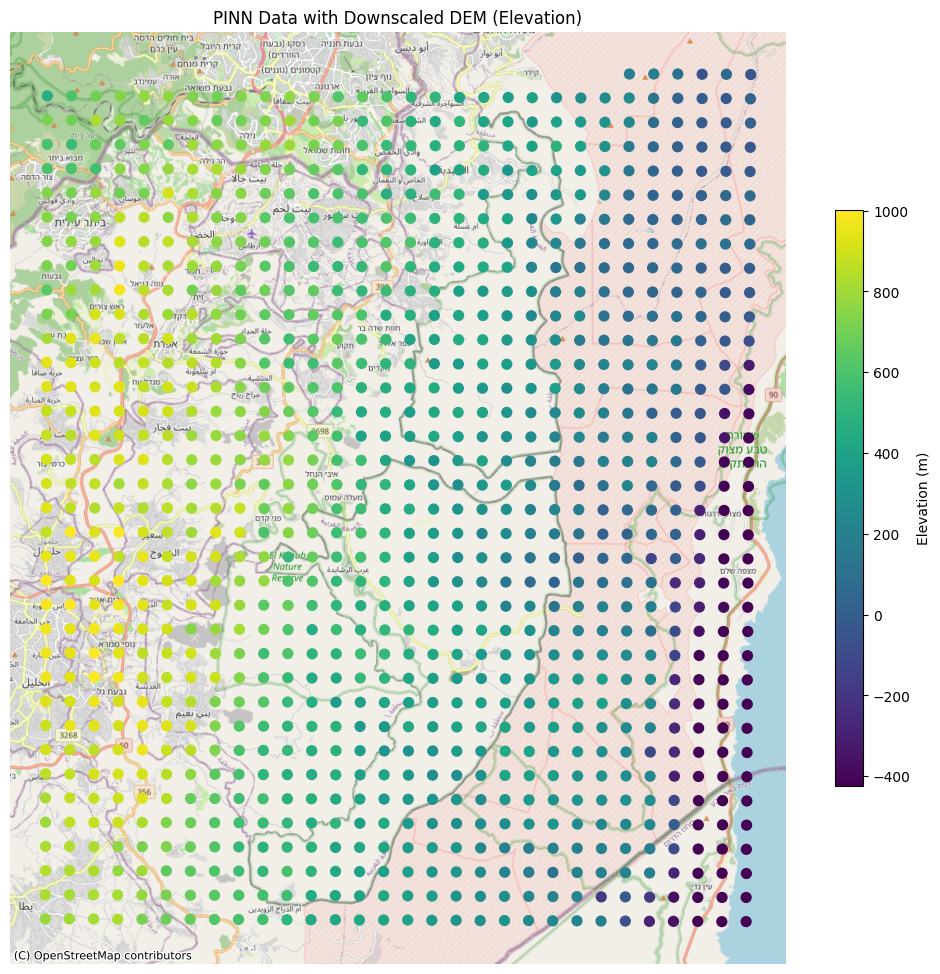

Downscaled DEM data saved to pinn_with_downscaled_dem.csv


In [2]:
#!/usr/bin/env python3
import os
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as ctx

# =============================================================================
# CONFIGURATION
# =============================================================================

# File paths
pinn_csv_path = r'/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to "spatial PINN Hebrew"/filtered_North_Dead_Sea_RM2012_cut.csv'
dem_csv_path = r'/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to "spatial PINN Hebrew"/North_Dead_Sea_DEM_with_slope_25m_res_cropped.csv'

# Column names for PINN data
pinn_timestamp_col = 'time'
pinn_lat_col = 'latitude'
pinn_lon_col = 'longitude'

# Column names for DEM data (as in your DEM head sample)
dem_lat_col = 'Latitude'
dem_lon_col = 'Longitude'
dem_elev_col = 'elevation'
dem_slope_col = 'slope'

# Provided bounding box coordinates (same for both files)
lon_min, lon_max = 35.09384183303422, 35.41310770285827
lat_min, lat_max = 31.43744033740171, 31.754231866507496

# Output CSV for joined data
output_csv = "pinn_with_downscaled_dem.csv"

# =============================================================================
# STEP 1: READ & FILTER PINN DATA
# =============================================================================

if not os.path.exists(pinn_csv_path):
    raise FileNotFoundError(f"PINN CSV file not found: {pinn_csv_path}")

# Read PINN CSV; parse the timestamp column
df_pinn = pd.read_csv(pinn_csv_path, parse_dates=[pinn_timestamp_col])
print(f"Total PINN records: {len(df_pinn)}")

# Use the first timestamp (assuming spatial coverage is identical for all times)
first_timestamp = df_pinn[pinn_timestamp_col].iloc[0]
print(f"Using first timestamp: {first_timestamp}")
df_pinn_first = df_pinn[df_pinn[pinn_timestamp_col] == first_timestamp]
print(f"PINN records for first timestamp: {len(df_pinn_first)}")

# Create GeoDataFrame for PINN data (assumed WGS84)
gdf_pinn = gpd.GeoDataFrame(
    df_pinn_first,
    geometry=gpd.points_from_xy(df_pinn_first[pinn_lon_col], df_pinn_first[pinn_lat_col]),
    crs="EPSG:4326"
)

# (Optional) Filter PINN points to ensure they lie within the given bbox
gdf_pinn = gdf_pinn[
    (gdf_pinn[pinn_lon_col] >= lon_min) & (gdf_pinn[pinn_lon_col] <= lon_max) &
    (gdf_pinn[pinn_lat_col] >= lat_min) & (gdf_pinn[pinn_lat_col] <= lat_max)
]
print("PINN records within bounding box:", len(gdf_pinn))

# =============================================================================
# STEP 2: READ & CLIP DEM DATA
# =============================================================================

if not os.path.exists(dem_csv_path):
    raise FileNotFoundError(f"DEM CSV file not found: {dem_csv_path}")

df_dem = pd.read_csv(dem_csv_path)
print(f"Total DEM records: {len(df_dem)}")

# Clip DEM records using the provided bbox (using DEM column names)
df_dem_clipped = df_dem[
    (df_dem[dem_lon_col] >= lon_min) & (df_dem[dem_lon_col] <= lon_max) &
    (df_dem[dem_lat_col] >= lat_min) & (df_dem[dem_lat_col] <= lat_max)
]
print(f"DEM records after clipping: {len(df_dem_clipped)}")

# Create a GeoDataFrame for DEM data (assumed WGS84)
gdf_dem = gpd.GeoDataFrame(
    df_dem_clipped,
    geometry=gpd.points_from_xy(df_dem_clipped[dem_lon_col], df_dem_clipped[dem_lat_col]),
    crs="EPSG:4326"
)

# =============================================================================
# STEP 3: DOWNSCALE THE DEM VIA NEAREST-NEIGHBOR SPATIAL JOIN
# =============================================================================

# For accurate nearest-neighbor matching, convert both GeoDataFrames to Web Mercator (EPSG:3857)
gdf_pinn_3857 = gdf_pinn.to_crs(epsg=3857)
gdf_dem_3857 = gdf_dem.to_crs(epsg=3857)

# Use GeoPandas' sjoin_nearest: for each PINN point, find the nearest DEM point.
gdf_joined = gpd.sjoin_nearest(gdf_pinn_3857, gdf_dem_3857, how="left", distance_col="dist")
print("After spatial join, records:", len(gdf_joined))

# =============================================================================
# STEP 4: PLOT THE RESULTS
# =============================================================================

# Plot PINN points colored by DEM elevation (or change column to dem_slope_col for slope)
fig, ax = plt.subplots(figsize=(10, 10))
gdf_joined.plot(
    column=dem_elev_col,
    ax=ax,
    marker='o',
    cmap="viridis",
    markersize=50,
    legend=True,
    legend_kwds={'label': "Elevation (m)", 'shrink': 0.6}
)

# Add a basemap (OpenStreetMap Mapnik tiles)
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)
ax.set_title("PINN Data with Downscaled DEM (Elevation)")
ax.set_axis_off()
plt.tight_layout()
plt.show()

# =============================================================================
# STEP 5: SAVE THE JOINED DATA (OPTIONAL)
# =============================================================================

gdf_joined.to_csv(output_csv, index=False)
print(f"Downscaled DEM data saved to {output_csv}")


Total PINN records: 41665536
Using first timestamp: 2012-01-01 00:00:00
PINN records for first timestamp: 1056
PINN records within bounding box: 1056
Total DEM records: 1885093
DEM records after clipping: 1885093
After spatial join, records: 1056
Nearest Neighbor Resolution Statistics (in meters):
  Average: 1169.58 m
  Median:  1168.85 m
  Minimum: 1161.27 m
  Maximum: 1178.24 m


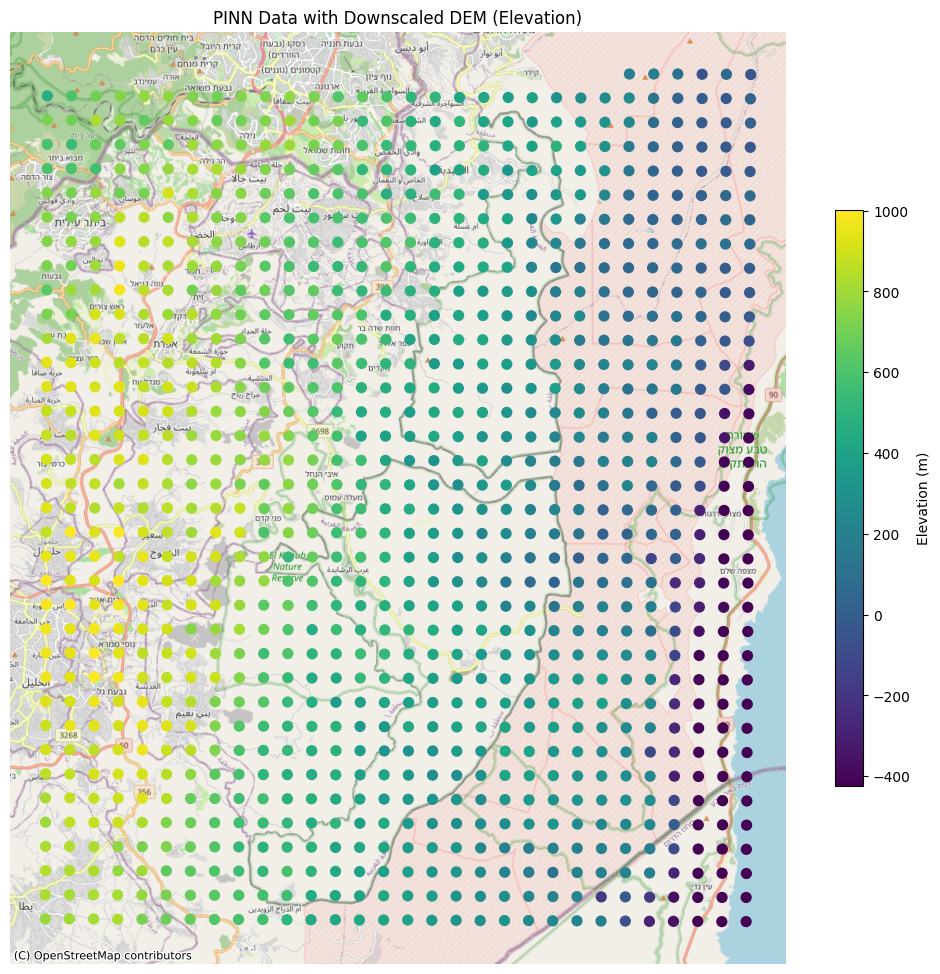

Downscaled DEM data saved to pinn_with_downscaled_dem.csv


In [3]:
#!/usr/bin/env python3
import os
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as ctx
import numpy as np
from sklearn.neighbors import NearestNeighbors

# =============================================================================
# CONFIGURATION
# =============================================================================

# File paths
pinn_csv_path = r'/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to "spatial PINN Hebrew"/filtered_North_Dead_Sea_RM2012_cut.csv'
dem_csv_path = r'/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to "spatial PINN Hebrew"/North_Dead_Sea_DEM_with_slope_25m_res_cropped.csv'

# Column names for PINN data
pinn_timestamp_col = 'time'
pinn_lat_col = 'latitude'
pinn_lon_col = 'longitude'

# Column names for DEM data (as in your DEM head sample)
dem_lat_col = 'Latitude'
dem_lon_col = 'Longitude'
dem_elev_col = 'elevation'
dem_slope_col = 'slope'

# Provided bounding box coordinates (same for both files)
lon_min, lon_max = 35.09384183303422, 35.41310770285827
lat_min, lat_max = 31.43744033740171, 31.754231866507496

# Output CSV for joined data
output_csv = "pinn_with_downscaled_dem.csv"

# =============================================================================
# STEP 1: READ & FILTER PINN DATA
# =============================================================================

if not os.path.exists(pinn_csv_path):
    raise FileNotFoundError(f"PINN CSV file not found: {pinn_csv_path}")

# Read PINN CSV and parse the timestamp column
df_pinn = pd.read_csv(pinn_csv_path, parse_dates=[pinn_timestamp_col])
print(f"Total PINN records: {len(df_pinn)}")

# Use the first timestamp (assuming spatial coverage is identical for all times)
first_timestamp = df_pinn[pinn_timestamp_col].iloc[0]
print(f"Using first timestamp: {first_timestamp}")
df_pinn_first = df_pinn[df_pinn[pinn_timestamp_col] == first_timestamp]
print(f"PINN records for first timestamp: {len(df_pinn_first)}")

# Create a GeoDataFrame for PINN data (assumed WGS84)
gdf_pinn = gpd.GeoDataFrame(
    df_pinn_first,
    geometry=gpd.points_from_xy(df_pinn_first[pinn_lon_col], df_pinn_first[pinn_lat_col]),
    crs="EPSG:4326"
)

# (Optional) Filter PINN points to ensure they lie within the given bbox
gdf_pinn = gdf_pinn[
    (gdf_pinn[pinn_lon_col] >= lon_min) & (gdf_pinn[pinn_lon_col] <= lon_max) &
    (gdf_pinn[pinn_lat_col] >= lat_min) & (gdf_pinn[pinn_lat_col] <= lat_max)
]
print("PINN records within bounding box:", len(gdf_pinn))

# =============================================================================
# STEP 2: READ & CLIP DEM DATA
# =============================================================================

if not os.path.exists(dem_csv_path):
    raise FileNotFoundError(f"DEM CSV file not found: {dem_csv_path}")

df_dem = pd.read_csv(dem_csv_path)
print(f"Total DEM records: {len(df_dem)}")

# Clip DEM records using the provided bbox (using DEM column names)
df_dem_clipped = df_dem[
    (df_dem[dem_lon_col] >= lon_min) & (df_dem[dem_lon_col] <= lon_max) &
    (df_dem[dem_lat_col] >= lat_min) & (df_dem[dem_lat_col] <= lat_max)
]
print(f"DEM records after clipping: {len(df_dem_clipped)}")

# Create a GeoDataFrame for DEM data (assumed WGS84)
gdf_dem = gpd.GeoDataFrame(
    df_dem_clipped,
    geometry=gpd.points_from_xy(df_dem_clipped[dem_lon_col], df_dem_clipped[dem_lat_col]),
    crs="EPSG:4326"
)

# =============================================================================
# STEP 3: DOWNSCALE THE DEM VIA NEAREST-NEIGHBOR SPATIAL JOIN
# =============================================================================

# Convert both GeoDataFrames to Web Mercator (EPSG:3857) for accurate distance calculations
gdf_pinn_3857 = gdf_pinn.to_crs(epsg=3857)
gdf_dem_3857 = gdf_dem.to_crs(epsg=3857)

# Spatial join: For each PINN point, find the nearest DEM point
gdf_joined = gpd.sjoin_nearest(gdf_pinn_3857, gdf_dem_3857, how="left", distance_col="dem_dist")
print("After spatial join, records:", len(gdf_joined))

# =============================================================================
# STEP 4: CALCULATE RESOLUTION OF THE OUTPUT
# =============================================================================

# We estimate the resolution by calculating, for each point, the distance to its nearest neighbor.
# First, extract the point coordinates (x, y) from the joined GeoDataFrame.
coords = np.array(list(gdf_joined.geometry.apply(lambda geom: (geom.x, geom.y))))

# Use NearestNeighbors to find the nearest neighbor for each point.
# We set n_neighbors=2 because the closest neighbor of a point is itself.
nbrs = NearestNeighbors(n_neighbors=2, algorithm='ball_tree').fit(coords)
distances, indices = nbrs.kneighbors(coords)

# distances[:, 1] is the distance to the nearest other point (in meters)
gdf_joined["nn_distance"] = distances[:, 1]

# Report summary statistics on the nearest neighbor distances (resolution)
avg_resolution = gdf_joined["nn_distance"].mean()
median_resolution = np.median(gdf_joined["nn_distance"])
min_resolution = gdf_joined["nn_distance"].min()
max_resolution = gdf_joined["nn_distance"].max()

print(f"Nearest Neighbor Resolution Statistics (in meters):")
print(f"  Average: {avg_resolution:.2f} m")
print(f"  Median:  {median_resolution:.2f} m")
print(f"  Minimum: {min_resolution:.2f} m")
print(f"  Maximum: {max_resolution:.2f} m")

# =============================================================================
# STEP 5: PLOT THE RESULTS
# =============================================================================

# Plot the PINN points colored by DEM elevation (change column to dem_slope_col for slope)
fig, ax = plt.subplots(figsize=(10, 10))
gdf_joined.plot(
    column=dem_elev_col,
    ax=ax,
    marker='o',
    cmap="viridis",
    markersize=50,
    legend=True,
    legend_kwds={'label': "Elevation (m)", 'shrink': 0.6}
)

# Add a basemap using OpenStreetMap Mapnik tiles
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)
ax.set_title("PINN Data with Downscaled DEM (Elevation)")
ax.set_axis_off()
plt.tight_layout()
plt.show()

# =============================================================================
# STEP 6: SAVE THE JOINED DATA (OPTIONAL)
# =============================================================================

gdf_joined.to_csv(output_csv, index=False)
print(f"Downscaled DEM data saved to {output_csv}")


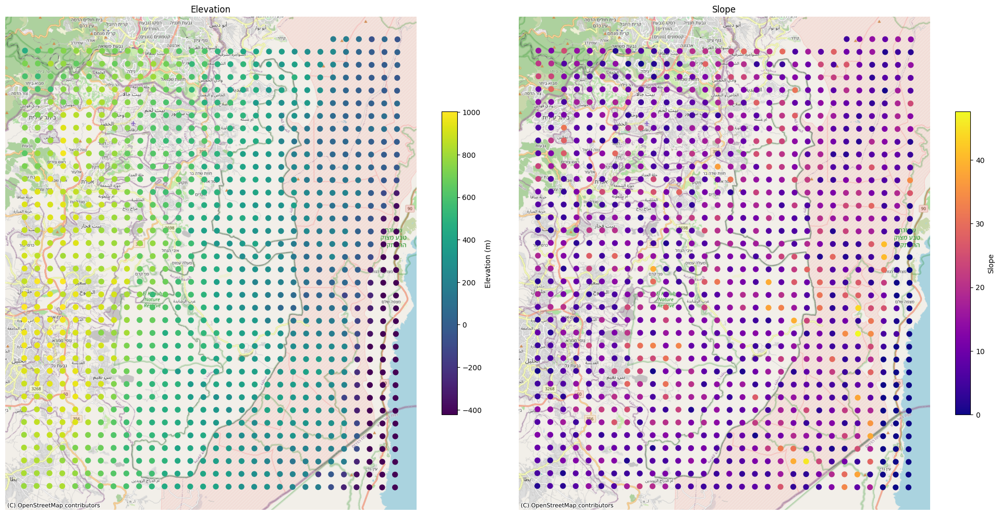

In [4]:
#!/usr/bin/env python3
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as ctx
from shapely import wkt

# --------------------------------------------------
# CONFIGURATION
# --------------------------------------------------
# Path to the CSV file
csv_path = r'/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to "spatial PINN Hebrew"/pinn_with_downscaled_dem.csv'

# Expected column names for DEM attributes
elev_col = 'elevation'
slope_col = 'slope'

# --------------------------------------------------
# READ THE CSV FILE & CREATE A GEO-DATAFRAME
# --------------------------------------------------
df = pd.read_csv(csv_path)

# Check if the CSV contains a 'geometry' column stored as WKT.
if 'geometry' in df.columns:
    # Convert WKT strings to geometry objects.
    df['geometry'] = df['geometry'].apply(wkt.loads)
    # Assume that the spatial join already reprojected the data to EPSG:3857.
    gdf = gpd.GeoDataFrame(df, geometry='geometry', crs='EPSG:3857')
else:
    # If no geometry column exists, create geometry from 'longitude' and 'latitude'.
    # Adjust the column names if needed.
    if ('longitude' in df.columns) and ('latitude' in df.columns):
        gdf = gpd.GeoDataFrame(df, 
                               geometry=gpd.points_from_xy(df['longitude'], df['latitude']),
                               crs='EPSG:4326')
        # Reproject to Web Mercator for proper basemap display.
        gdf = gdf.to_crs(epsg=3857)
    else:
        raise ValueError("CSV must contain a 'geometry' column or 'longitude' and 'latitude' columns.")

# --------------------------------------------------
# PLOT ELEVATION AND SLOPE ON A MAP
# --------------------------------------------------
fig, axs = plt.subplots(1, 2, figsize=(20, 10))

# --- Plot Elevation ---
ax_elev = axs[0]
gdf.plot(column=elev_col, ax=ax_elev, markersize=50, cmap='viridis', legend=True,
         legend_kwds={'label': "Elevation (m)", 'shrink': 0.6})
ctx.add_basemap(ax_elev, source=ctx.providers.OpenStreetMap.Mapnik)
ax_elev.set_title("Elevation")
ax_elev.set_axis_off()

# --- Plot Slope ---
ax_slope = axs[1]
gdf.plot(column=slope_col, ax=ax_slope, markersize=50, cmap='plasma', legend=True,
         legend_kwds={'label': "Slope", 'shrink': 0.6})
ctx.add_basemap(ax_slope, source=ctx.providers.OpenStreetMap.Mapnik)
ax_slope.set_title("Slope")
ax_slope.set_axis_off()

plt.tight_layout()
plt.show()


In [5]:
#!/usr/bin/env python3
import pandas as pd

# --------------------------------------------------
# CONFIGURATION
# --------------------------------------------------
# Path to your CSV file
csv_path = r'/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to "spatial PINN Hebrew"/pinn_with_downscaled_dem.csv'

# --------------------------------------------------
# READ CSV AND SHOW THE HEAD
# --------------------------------------------------
try:
    # Read the CSV file
    df = pd.read_csv(csv_path)
    
    # Display the first 5 rows of the DataFrame
    print("Head of the file:")
    print(df.head())
    
except FileNotFoundError:
    print(f"Error: The file was not found at {csv_path}")
except Exception as e:
    print(f"An error occurred: {e}")


Head of the file:
         time  latitude  longitude  rainrate  \
0  2012-01-01   31.7542    35.3533       0.0   
1  2012-01-01   31.7542    35.3639       0.0   
2  2012-01-01   31.7542    35.3744       0.0   
3  2012-01-01   31.7541    35.3850       0.0   
4  2012-01-01   31.7541    35.3956       0.0   

                                       geometry  index_right   Latitude  \
0   POINT (3935511.353861838 3731088.628296315)         1120  31.754044   
1  POINT (3936691.3404642474 3731088.628296315)         1166  31.754044   
2  POINT (3937860.1951175765 3731088.628296315)         1211  31.754044   
3  POINT (3939040.1817199853 3731075.536723486)         1257  31.754044   
4  POINT (3940220.1683223946 3731075.536723486)         1303  31.754044   

   Longitude  elevation      slope   dem_dist  nn_distance  
0  35.353317  179.91008   4.416654  20.452766  1165.147790  
1  35.363974  182.38225  12.280473  21.961952  1168.854653  
2  35.374399   94.52771  14.574815  20.363094  1168.854653 

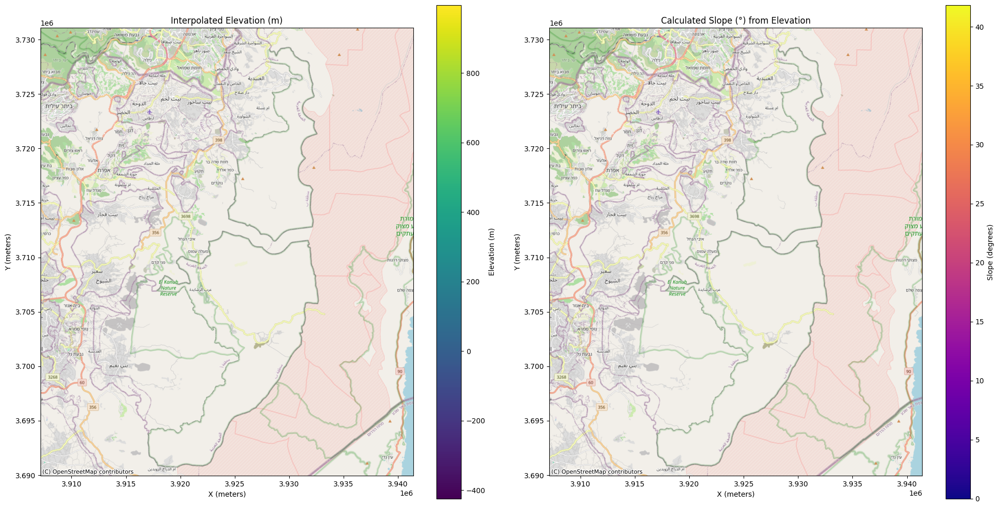

In [7]:
#!/usr/bin/env python3
import pandas as pd
import os

# --------------------------------------------------
# CONFIGURATION
# --------------------------------------------------
# Path to the original CSV file
input_csv_path = r'/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to "spatial PINN Hebrew"/pinn_with_downscaled_dem.csv'
# Path for the new CSV file without the "slope" column
output_csv_path = r'/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to "spatial PINN Hebrew"/pinn_with_downscaled_dem_no_slope.csv'

# --------------------------------------------------
# READ THE CSV FILE
# --------------------------------------------------
if not os.path.exists(input_csv_path):
    raise FileNotFoundError(f"CSV file not found: {input_csv_path}")

df = pd.read_csv(input_csv_path)
print("Original columns:", df.columns.tolist())

# --------------------------------------------------
# DROP THE "slope" COLUMN (if it exists)
# --------------------------------------------------
if "slope" in df.columns:
    df = df.drop(columns=["slope"])
    print("Dropped the 'slope' column.")
else:
    print("No 'slope' column found in the file.")

# --------------------------------------------------
# SAVE THE NEW CSV FILE
# --------------------------------------------------
df.to_csv(output_csv_path, index=False)
print(f"New CSV file saved to: {output_csv_path}")


Original columns: ['time', 'latitude', 'longitude', 'rainrate', 'geometry', 'index_right', 'Latitude', 'Longitude', 'elevation', 'slope', 'dem_dist', 'nn_distance']
Dropped the 'slope' column.
New CSV file saved to: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to "spatial PINN Hebrew"/pinn_with_downscaled_dem_no_slope.csv


In [9]:
#!/usr/bin/env python3
import pandas as pd
import geopandas as gpd
import numpy as np
from shapely import wkt
from scipy.interpolate import griddata
import os

# --------------------------------------------------
# CONFIGURATION
# --------------------------------------------------
# Input CSV (without the old slope column)
input_csv_path = r'/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to "spatial PINN Hebrew"/pinn_with_downscaled_dem_no_slope.csv'
# Output CSV with recalculated slope added
output_csv_path = r'/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to "spatial PINN Hebrew"/pinn_with_downscaled_dem_calculated_slope.csv'

# Column holding elevation data
elev_col = 'elevation'

# Grid settings for interpolation (adjust resolution as needed)
num_grid_points = 200  # Number of grid points along each axis

# --------------------------------------------------
# STEP 1: READ THE CSV FILE AND CREATE A GEO-DATAFRAME
# --------------------------------------------------
if not os.path.exists(input_csv_path):
    raise FileNotFoundError(f"CSV file not found: {input_csv_path}")

df = pd.read_csv(input_csv_path)
print("Columns in input file:", df.columns.tolist())

# If a 'geometry' column exists (stored as WKT), convert it.
if 'geometry' in df.columns:
    df['geometry'] = df['geometry'].apply(wkt.loads)
    gdf = gpd.GeoDataFrame(df, geometry='geometry', crs='EPSG:3857')
else:
    # Otherwise, create geometry from 'longitude' and 'latitude' (assuming they are in degrees)
    if ('longitude' in df.columns) and ('latitude' in df.columns):
        gdf = gpd.GeoDataFrame(
            df,
            geometry=gpd.points_from_xy(df['longitude'], df['latitude']),
            crs='EPSG:4326'
        )
        # Reproject to Web Mercator (meters)
        gdf = gdf.to_crs(epsg=3857)
    else:
        raise ValueError("CSV must contain a 'geometry' column or 'longitude' and 'latitude' columns.")

# Ensure elevation values are available
gdf = gdf.dropna(subset=[elev_col])
print(f"Number of points used: {len(gdf)}")

# --------------------------------------------------
# STEP 2: INTERPOLATE ELEVATION TO A REGULAR GRID
# --------------------------------------------------
# Extract x, y coordinates and elevation values.
x = gdf.geometry.x.values
y = gdf.geometry.y.values
z = gdf[elev_col].values

# Define grid extents based on the data
x_min, x_max = x.min(), x.max()
y_min, y_max = y.min(), y.max()

# Create a regular grid
xi = np.linspace(x_min, x_max, num_grid_points)
yi = np.linspace(y_min, y_max, num_grid_points)
X, Y = np.meshgrid(xi, yi)

# Interpolate the scattered elevation values onto the grid.
Z = griddata((x, y), z, (X, Y), method='linear')

# --------------------------------------------------
# STEP 3: CALCULATE SLOPE FROM THE INTERPOLATED ELEVATION
# --------------------------------------------------
# Compute grid spacing in x and y directions (in meters)
dx = (x_max - x_min) / (num_grid_points - 1)
dy = (y_max - y_min) / (num_grid_points - 1)

# Calculate gradients along y (rows) and x (columns)
dz_dy, dz_dx = np.gradient(Z, dy, dx)

# Calculate slope (in radians) as arctan of the gradient magnitude
slope_radians = np.arctan(np.sqrt(dz_dx**2 + dz_dy**2))
# Convert slope to degrees
slope_degrees = np.degrees(slope_radians)

# --------------------------------------------------
# STEP 4: INTERPOLATE THE CALCULATED SLOPE BACK TO THE ORIGINAL POINTS
# --------------------------------------------------
# For each original point, get the corresponding slope value from the grid.
point_slope = griddata((X.flatten(), Y.flatten()),
                       slope_degrees.flatten(),
                       (x, y),
                       method='linear')

# Add the new slope column to the GeoDataFrame.
gdf['slope_calculated'] = point_slope

# --------------------------------------------------
# STEP 5: SAVE THE UPDATED DATA TO A NEW CSV FILE
# --------------------------------------------------
# Optionally, drop the geometry column if you want a plain CSV
gdf.drop(columns='geometry').to_csv(output_csv_path, index=False)
print(f"New CSV with recalculated slope saved to: {output_csv_path}")


Columns in input file: ['time', 'latitude', 'longitude', 'rainrate', 'geometry', 'index_right', 'Latitude', 'Longitude', 'elevation', 'dem_dist', 'nn_distance']
Number of points used: 1056
New CSV with recalculated slope saved to: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to "spatial PINN Hebrew"/pinn_with_downscaled_dem_calculated_slope.csv


Columns in CSV: ['time', 'latitude', 'longitude', 'rainrate', 'index_right', 'Latitude', 'Longitude', 'elevation', 'dem_dist', 'nn_distance', 'slope_calculated']


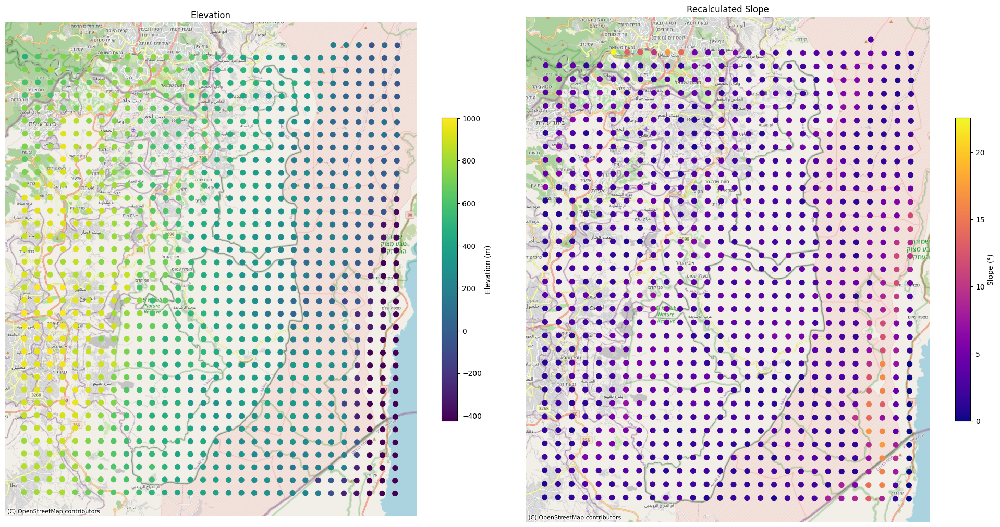

In [10]:
#!/usr/bin/env python3
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as ctx
from shapely import wkt
import os

# --------------------------------------------------
# CONFIGURATION
# --------------------------------------------------
# Path to the CSV file with the recalculated slope
csv_path = r'/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to "spatial PINN Hebrew"/pinn_with_downscaled_dem_calculated_slope.csv'

# Column names for elevation and the recalculated slope
elev_col = 'elevation'
slope_col = 'slope_calculated'

# --------------------------------------------------
# READ THE CSV FILE AND CREATE A GEO-DATAFRAME
# --------------------------------------------------
if not os.path.exists(csv_path):
    raise FileNotFoundError(f"CSV file not found: {csv_path}")

df = pd.read_csv(csv_path)
print("Columns in CSV:", df.columns.tolist())

# Create GeoDataFrame
# If a 'geometry' column exists, use it (assuming it's stored as WKT)
if 'geometry' in df.columns:
    df['geometry'] = df['geometry'].apply(wkt.loads)
    gdf = gpd.GeoDataFrame(df, geometry='geometry', crs='EPSG:3857')
else:
    # Otherwise, create geometry from 'longitude' and 'latitude'
    if ('longitude' in df.columns) and ('latitude' in df.columns):
        gdf = gpd.GeoDataFrame(
            df,
            geometry=gpd.points_from_xy(df['longitude'], df['latitude']),
            crs='EPSG:4326'
        )
        # Reproject to Web Mercator (EPSG:3857) for basemap compatibility
        gdf = gdf.to_crs(epsg=3857)
    else:
        raise ValueError("CSV must contain a 'geometry' column or 'longitude' and 'latitude' columns.")

# --------------------------------------------------
# PLOT THE RESULTS: Elevation and Recalculated Slope
# --------------------------------------------------
fig, axs = plt.subplots(1, 2, figsize=(20, 10))

# --- Plot Elevation ---
ax1 = axs[0]
# Plot the points colored by elevation (using 'viridis' colormap)
gdf.plot(column=elev_col, ax=ax1, markersize=50, cmap='viridis', legend=True,
         legend_kwds={'label': "Elevation (m)", 'shrink': 0.6})
ax1.set_title("Elevation")
ax1.set_axis_off()
# Add basemap for context
ctx.add_basemap(ax1, source=ctx.providers.OpenStreetMap.Mapnik)

# --- Plot Recalculated Slope ---
ax2 = axs[1]
# Plot the points colored by the recalculated slope (using 'plasma' colormap)
gdf.plot(column=slope_col, ax=ax2, markersize=50, cmap='plasma', legend=True,
         legend_kwds={'label': "Slope (°)", 'shrink': 0.6})
ax2.set_title("Recalculated Slope")
ax2.set_axis_off()
# Add basemap for context
ctx.add_basemap(ax2, source=ctx.providers.OpenStreetMap.Mapnik)

plt.tight_layout()
plt.show()


In [11]:
df.shape

(1056, 11)

In [13]:
#!/usr/bin/env python3
import pandas as pd
import os

# --------------------------------------------------
# CONFIGURATION
# --------------------------------------------------
csv_path = r'/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to "spatial PINN Hebrew"/dem slope/pinn_with_downscaled_dem_calculated_slope.csv'

# --------------------------------------------------
# READ THE CSV FILE
# --------------------------------------------------
if not os.path.exists(csv_path):
    raise FileNotFoundError(f"CSV file not found: {csv_path}")

df = pd.read_csv(csv_path)

# --------------------------------------------------
# EXTRACT THE COORDINATES
# --------------------------------------------------
# Here we assume the PINN coordinates are stored in the 'latitude' and 'longitude' columns.
coordinates = df[['latitude', 'longitude']].drop_duplicates()

# --------------------------------------------------
# PRINT THE COORDINATE PAIRS
# --------------------------------------------------
print("List of coordinate pairs (latitude, longitude):")
print(coordinates.to_string(index=False))


List of coordinate pairs (latitude, longitude):
 latitude  longitude
  31.7542    35.3533
  31.7542    35.3639
  31.7542    35.3744
  31.7541    35.3850
  31.7541    35.3956
  31.7540    35.4062
  31.7461    35.0994
  31.7461    35.1100
  31.7460    35.1206
  31.7460    35.1312
  31.7460    35.1417
  31.7459    35.1523
  31.7459    35.1629
  31.7459    35.1735
  31.7459    35.1840
  31.7458    35.1946
  31.7458    35.2052
  31.7458    35.2158
  31.7457    35.2263
  31.7457    35.2369
  31.7457    35.2475
  31.7456    35.2581
  31.7456    35.2686
  31.7455    35.2792
  31.7455    35.2898
  31.7455    35.3004
  31.7454    35.3109
  31.7454    35.3215
  31.7453    35.3321
  31.7453    35.3427
  31.7453    35.3532
  31.7452    35.3638
  31.7452    35.3744
  31.7451    35.3850
  31.7451    35.3955
  31.7450    35.4061
  31.7371    35.0994
  31.7371    35.1100
  31.7370    35.1206
  31.7370    35.1311
  31.7370    35.1417
  31.7370    35.1523
  31.7369    35.1629
  31.7369    35.1734
  31.73

In [15]:
#!/usr/bin/env python3
import pandas as pd
import os

# --------------------------------------------------
# CONFIGURATION
# --------------------------------------------------
csv_path = r'/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to "spatial PINN Hebrew"/discharge/Northern Dead Sea discharge_2012.csv'

# --------------------------------------------------
# READ THE CSV FILE
# --------------------------------------------------
if not os.path.exists(csv_path):
    raise FileNotFoundError(f"CSV file not found: {csv_path}")

df = pd.read_csv(csv_path)

# --------------------------------------------------
# EXTRACT UNIQUE STATIONS AND THEIR COORDINATES
# --------------------------------------------------
# We'll assume that the combination of station "name", "shd_id", "lon", and "lat" defines a unique station.
stations = df[['name', 'shd_id', 'lon', 'lat']].drop_duplicates()

# --------------------------------------------------
# PRINT THE LIST OF STATIONS
# --------------------------------------------------
print("List of unique stations with coordinates:")
print(stations.to_string(index=False))


List of unique stations with coordinates:
               name  shd_id      lon      lat
               דרגה   48125 35.36552 31.60015
               תקוע   48130 35.35232 31.58677
ערוגות במעלה כביש90   48156 35.38994 31.45821


In [16]:
#!/usr/bin/env python3
import pandas as pd
import os
import numpy as np
from sklearn.neighbors import NearestNeighbors

# Constants for haversine distance conversion
EARTH_RADIUS_M = 6371000  # Earth radius in meters

# --------------------------------------------------
# CONFIGURATION
# --------------------------------------------------
# Discharge file containing station data
discharge_csv_path = r'/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to "spatial PINN Hebrew"/discharge/Northern Dead Sea discharge_2012.csv'
# PINN file with downscaled DEM and calculated slope
pinn_csv_path = r'/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to "spatial PINN Hebrew"/dem slope/pinn_with_downscaled_dem_calculated_slope.csv'

# --------------------------------------------------
# STEP 1: READ DISCHARGE FILE AND EXTRACT UNIQUE STATIONS
# --------------------------------------------------
if not os.path.exists(discharge_csv_path):
    raise FileNotFoundError(f"Discharge CSV file not found: {discharge_csv_path}")

df_discharge = pd.read_csv(discharge_csv_path)
# Unique stations based on combination of name, shd_id, lon, and lat
stations = df_discharge[['name', 'shd_id', 'lon', 'lat']].drop_duplicates()
print("Unique stations from the discharge file:")
print(stations.to_string(index=False))

# --------------------------------------------------
# STEP 2: READ PINN FILE AND EXTRACT UNIQUE COORDINATES
# --------------------------------------------------
if not os.path.exists(pinn_csv_path):
    raise FileNotFoundError(f"PINN CSV file not found: {pinn_csv_path}")

df_pinn = pd.read_csv(pinn_csv_path)
# Assume that the PINN coordinates are in columns 'latitude' and 'longitude'
pinn_coords = df_pinn[['latitude', 'longitude']].drop_duplicates()

# --------------------------------------------------
# STEP 3: SET UP NEAREST NEIGHBORS USING HAVERSINE METRIC
# --------------------------------------------------
# Convert degrees to radians for haversine metric
pinn_coords_rad = np.radians(pinn_coords.values)  # shape (N,2)

# Initialize NearestNeighbors with haversine metric.
nbrs = NearestNeighbors(n_neighbors=1, metric='haversine')
nbrs.fit(pinn_coords_rad)

# --------------------------------------------------
# STEP 4: QUERY EACH STATION TO FIND THE NEAREST PINN POINT
# --------------------------------------------------
results = []
for idx, row in stations.iterrows():
    # Extract station coordinates (in degrees)
    station_lat, station_lon = row['lat'], row['lon']
    # Convert to radians and reshape for query
    station_rad = np.radians([station_lat, station_lon]).reshape(1, -1)
    # Query the nearest neighbor
    distance_rad, index = nbrs.kneighbors(station_rad)
    # Convert distance from radians to meters
    distance_m = distance_rad[0][0] * EARTH_RADIUS_M
    # Get the nearest PINN point (in degrees)
    nearest_point = pinn_coords.iloc[index[0][0]]
    results.append({
        'station_name': row['name'],
        'station_shd_id': row['shd_id'],
        'station_lon': station_lon,
        'station_lat': station_lat,
        'nearest_point_lon': nearest_point['longitude'],
        'nearest_point_lat': nearest_point['latitude'],
        'distance_m': distance_m
    })

results_df = pd.DataFrame(results)

# --------------------------------------------------
# STEP 5: SHOW THE RESULTS
# --------------------------------------------------
print("\nNearest PINN point for each station:")
print(results_df.to_string(index=False))


Unique stations from the discharge file:
               name  shd_id      lon      lat
               דרגה   48125 35.36552 31.60015
               תקוע   48130 35.35232 31.58677
ערוגות במעלה כביש90   48156 35.38994 31.45821

Nearest PINN point for each station:
       station_name  station_shd_id  station_lon  station_lat  nearest_point_lon  nearest_point_lat  distance_m
               דרגה           48125     35.36552     31.60015            35.3630            31.6013  270.760323
               תקוע           48130     35.35232     31.58677            35.3523            31.5834  374.731692
ערוגות במעלה כביש90           48156     35.38994     31.45821            35.3937            31.4573  370.720488


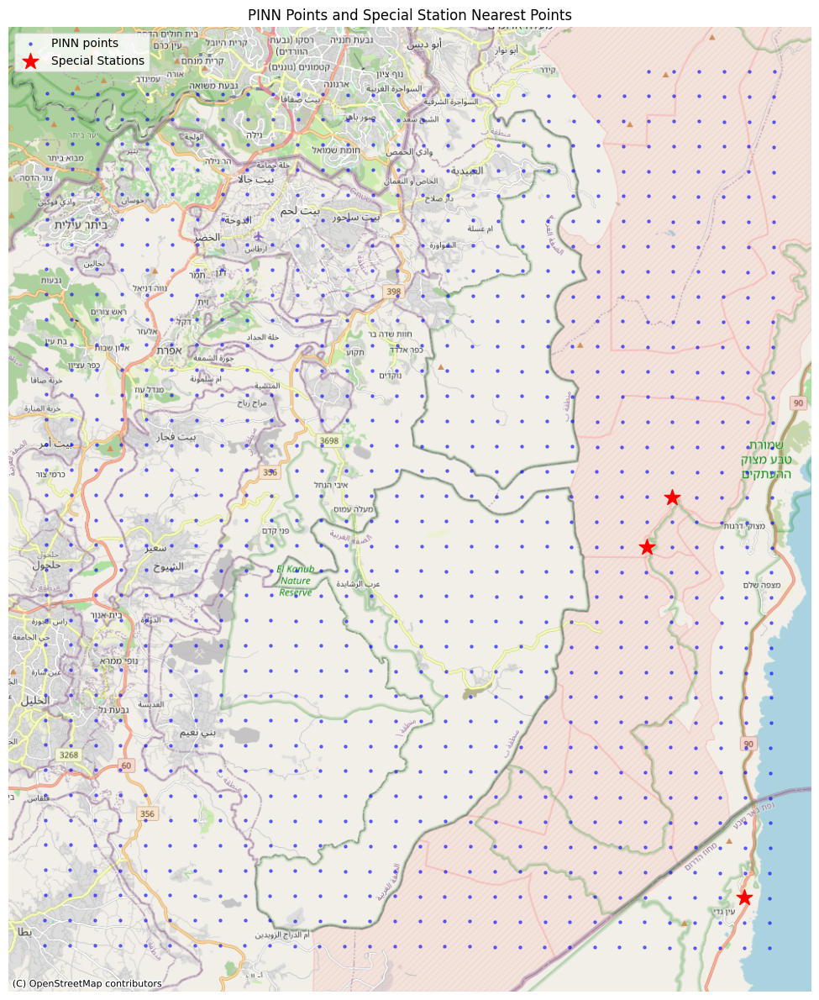

In [17]:
#!/usr/bin/env python3
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as ctx
from shapely.geometry import Point
from shapely import wkt
import os

# --------------------------------------------------
# CONFIGURATION
# --------------------------------------------------
# Path to the PINN file
pinn_csv_path = r'/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to "spatial PINN Hebrew"/dem slope/pinn_with_downscaled_dem_calculated_slope.csv'

# Special station nearest PINN points (from previous results)
# Format: [ (latitude, longitude, station_name), ... ]
special_points = [
    (31.6013, 35.3630, "דרגה"),
    (31.5834, 35.3523, "תקוע"),
    (31.4573, 35.3937, "ערוגות במעלה כביש90")
]

# --------------------------------------------------
# STEP 1: READ THE PINN FILE AND CREATE A GEO-DATAFRAME
# --------------------------------------------------
if not os.path.exists(pinn_csv_path):
    raise FileNotFoundError(f"PINN CSV file not found: {pinn_csv_path}")

df = pd.read_csv(pinn_csv_path)

# If the CSV contains a "geometry" column (stored as WKT), convert it; otherwise create one.
if 'geometry' in df.columns:
    df['geometry'] = df['geometry'].apply(wkt.loads)
    gdf_pinn = gpd.GeoDataFrame(df, geometry='geometry', crs='EPSG:3857')
else:
    # Create geometry from longitude and latitude (assumed in degrees)
    gdf_pinn = gpd.GeoDataFrame(
        df,
        geometry=gpd.points_from_xy(df['longitude'], df['latitude']),
        crs='EPSG:4326'
    )
    # Reproject to Web Mercator for proper basemap display
    gdf_pinn = gdf_pinn.to_crs(epsg=3857)

# --------------------------------------------------
# STEP 2: CREATE A GEO-DATAFRAME FOR THE SPECIAL STATION POINTS
# --------------------------------------------------
# Create a list of shapely Points in (lon, lat) order
special_geom = [Point(lon, lat) for lat, lon, _ in special_points]
df_special = pd.DataFrame(special_points, columns=['latitude', 'longitude', 'station_name'])
gdf_special = gpd.GeoDataFrame(df_special, geometry=special_geom, crs='EPSG:4326')
# Reproject to EPSG:3857 to match the PINN data
gdf_special = gdf_special.to_crs(epsg=3857)

# --------------------------------------------------
# STEP 3: PLOT THE DATA ON A MAP
# --------------------------------------------------
fig, ax = plt.subplots(figsize=(12, 12))

# Plot all PINN points as background
gdf_pinn.plot(ax=ax, marker='o', color='blue', markersize=5, alpha=0.5, label="PINN points")

# Overlay the special station points with a star marker
gdf_special.plot(ax=ax, marker='*', color='red', markersize=200, label="Special Stations")

# Add basemap for context (using OpenStreetMap Mapnik tiles)
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

# Add legend and title
ax.legend()
ax.set_title("PINN Points and Special Station Nearest Points")

# Remove axis for a cleaner look
ax.set_axis_off()

plt.tight_layout()
plt.show()


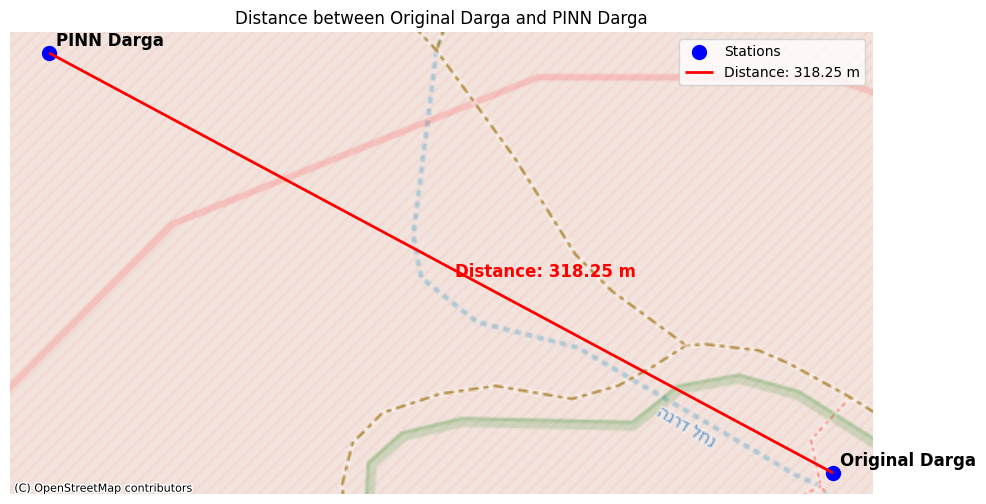

In [20]:
#!/usr/bin/env python3
import geopandas as gpd
from shapely.geometry import Point, LineString
import matplotlib.pyplot as plt
import contextily as ctx
import numpy as np

# --------------------------------------------------
# CONFIGURATION: Define the two points (lon, lat)
# --------------------------------------------------
points = [
    {"name": "Original Darga", "lon": 35.36552, "lat": 31.60015},
    {"name": "PINN Darga", "lon": 35.3630, "lat": 31.6013}
]

# --------------------------------------------------
# CREATE A GEO-DATAFRAME
# --------------------------------------------------
# Create a GeoDataFrame from the points with CRS set to EPSG:4326 (WGS84)
gdf = gpd.GeoDataFrame(
    points,
    geometry=[Point(d["lon"], d["lat"]) for d in points],
    crs="EPSG:4326"
)

# Reproject to Web Mercator (EPSG:3857) for proper basemap display and accurate distance measurements
gdf = gdf.to_crs(epsg=3857)

# --------------------------------------------------
# CALCULATE THE DISTANCE BETWEEN THE TWO POINTS
# --------------------------------------------------
pt1, pt2 = gdf.geometry.iloc[0], gdf.geometry.iloc[1]
distance_m = pt1.distance(pt2)
distance_text = f"Distance: {distance_m:.2f} m"

# Create a LineString connecting the two points
line = LineString([pt1, pt2])
gdf_line = gpd.GeoDataFrame({'geometry': [line]}, crs="EPSG:3857")

# --------------------------------------------------
# PLOT THE POINTS, LINE, AND DISTANCE ANNOTATION
# --------------------------------------------------
fig, ax = plt.subplots(figsize=(10, 10))

# Plot the two points
gdf.plot(ax=ax, marker='o', color='blue', markersize=100, label='Stations')

# Annotate each point with its name
for idx, row in gdf.iterrows():
    ax.annotate(row['name'],
                xy=(row.geometry.x, row.geometry.y),
                xytext=(5, 5),
                textcoords='offset points',
                fontsize=12,
                fontweight='bold',
                color='black')

# Plot the connecting line in red
gdf_line.plot(ax=ax, color='red', linewidth=2, label=distance_text)

# Optionally, annotate the midpoint of the line with the distance
mid_x = (pt1.x + pt2.x) / 2
mid_y = (pt1.y + pt2.y) / 2
ax.annotate(distance_text, xy=(mid_x, mid_y), xytext=(10, -10),
            textcoords='offset points', fontsize=12, color='red', fontweight='bold')

# Add a basemap using OpenStreetMap Mapnik tiles
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

# Set title and remove axis for a cleaner look
ax.set_title("Distance between Original Darga and PINN Darga")
ax.set_axis_off()

plt.legend()
plt.tight_layout()
plt.show()


In [25]:
import os
import pandas as pd

# Path to the directory containing your CSV files
folder_path = r'/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to "spatial PINN Hebrew"/rain'

# List of the CSV files you want to examine
csv_files = [
    "filtered_North_Dead_Sea_RM2012_cut.csv",
    "filtered_North_Dead_Sea_RM2013_cut.csv",
    "filtered_North_Dead_Sea_RM2014_cut.csv",
    "filtered_North_Dead_Sea_RM2015_cut.csv",
    "filtered_North_Dead_Sea_RM2016_cut.csv",
    "filtered_North_Dead_Sea_RM2018_cut.csv",
    "filtered_North_Dead_Sea_RM2019_cut.csv",
    "filtered_North_Dead_Sea_RM2020_cut.csv"
]

for csv_file in csv_files:
    # Build full path
    file_path = os.path.join(folder_path, csv_file)
    
    # Read the CSV file
    df = pd.read_csv(file_path)
    
    # Print the file name
    print(f"Showing head of: {csv_file}")
    
    # Display the first 5 rows
    display(df.head())
    
    print("\n" + "-"*80 + "\n")


Showing head of: filtered_North_Dead_Sea_RM2012_cut.csv


,time,latitude,longitude,rainrate
0,2012-01-01 00:00:00,31.7542,35.3533,0.0
1,2012-01-01 00:00:00,31.7542,35.3639,0.0
2,2012-01-01 00:00:00,31.7542,35.3744,0.0
3,2012-01-01 00:00:00,31.7541,35.3850,0.0
4,2012-01-01 00:00:00,31.7541,35.3956,0.0



--------------------------------------------------------------------------------

Showing head of: filtered_North_Dead_Sea_RM2013_cut.csv


,time,latitude,longitude,rainrate
0,2013-01-01 00:00:00,31.7542,35.3533,0.0
1,2013-01-01 00:00:00,31.7542,35.3639,0.0
2,2013-01-01 00:00:00,31.7542,35.3744,0.0
3,2013-01-01 00:00:00,31.7541,35.3850,0.0
4,2013-01-01 00:00:00,31.7541,35.3956,0.0



--------------------------------------------------------------------------------

Showing head of: filtered_North_Dead_Sea_RM2014_cut.csv


,time,latitude,longitude,rainrate
0,2014-01-01 00:00:00,31.7542,35.3533,0.0
1,2014-01-01 00:00:00,31.7542,35.3639,0.0
2,2014-01-01 00:00:00,31.7542,35.3744,0.0
3,2014-01-01 00:00:00,31.7541,35.3850,0.0
4,2014-01-01 00:00:00,31.7541,35.3956,0.0



--------------------------------------------------------------------------------

Showing head of: filtered_North_Dead_Sea_RM2015_cut.csv


,time,latitude,longitude,rainrate
0,2015-01-01 00:00:00,31.7542,35.3533,0.0
1,2015-01-01 00:00:00,31.7542,35.3639,0.0
2,2015-01-01 00:00:00,31.7542,35.3744,0.0
3,2015-01-01 00:00:00,31.7541,35.3850,0.0
4,2015-01-01 00:00:00,31.7541,35.3956,0.0



--------------------------------------------------------------------------------

Showing head of: filtered_North_Dead_Sea_RM2016_cut.csv


,time,latitude,longitude,rainrate
0,2016-01-01 00:00:00,31.7542,35.3533,0.0
1,2016-01-01 00:00:00,31.7542,35.3639,0.0
2,2016-01-01 00:00:00,31.7542,35.3744,0.0
3,2016-01-01 00:00:00,31.7541,35.3850,0.0
4,2016-01-01 00:00:00,31.7541,35.3956,0.0



--------------------------------------------------------------------------------

Showing head of: filtered_North_Dead_Sea_RM2018_cut.csv


,time,latitude,longitude,rainrate
0,2018-01-01 00:00:00,31.7542,35.3533,0.0
1,2018-01-01 00:00:00,31.7542,35.3639,0.0
2,2018-01-01 00:00:00,31.7542,35.3744,0.0
3,2018-01-01 00:00:00,31.7541,35.3850,0.0
4,2018-01-01 00:00:00,31.7541,35.3956,0.0



--------------------------------------------------------------------------------

Showing head of: filtered_North_Dead_Sea_RM2019_cut.csv


,time,latitude,longitude,rainrate
0,2019-01-01 00:00:00,31.7542,35.3533,0.0
1,2019-01-01 00:00:00,31.7542,35.3639,0.0
2,2019-01-01 00:00:00,31.7542,35.3744,0.0
3,2019-01-01 00:00:00,31.7541,35.3850,0.0
4,2019-01-01 00:00:00,31.7541,35.3956,0.0



--------------------------------------------------------------------------------

Showing head of: filtered_North_Dead_Sea_RM2020_cut.csv


,time,latitude,longitude,rainrate
0,2020-01-01 00:00:00,31.7542,35.3533,0.0
1,2020-01-01 00:00:00,31.7542,35.3639,0.0
2,2020-01-01 00:00:00,31.7542,35.3744,0.0
3,2020-01-01 00:00:00,31.7541,35.3850,0.0
4,2020-01-01 00:00:00,31.7541,35.3956,0.0



--------------------------------------------------------------------------------



In [26]:
import pandas as pd

# Path to the 2012 CSV file
file_2012 = r'/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to "spatial PINN Hebrew"/rain/filtered_North_Dead_Sea_RM2012_cut.csv'

# Read the CSV into a DataFrame
df_2012 = pd.read_csv(file_2012)

# Drop duplicates to get unique latitude-longitude pairs
unique_points_df = df_2012[['latitude', 'longitude']].drop_duplicates()

# Option 1: Show unique pairs as a DataFrame
print("Unique latitude-longitude pairs (DataFrame):")
print(unique_points_df)

# Option 2: Convert the DataFrame to a list of (latitude, longitude) tuples
unique_points_list = list(unique_points_df.itertuples(index=False, name=None))
print("\nUnique latitude-longitude pairs (list of tuples):")
print(unique_points_list)


Unique latitude-longitude pairs (DataFrame):
      latitude  longitude
0      31.7542    35.3533
1      31.7542    35.3639
2      31.7542    35.3744
3      31.7541    35.3850
4      31.7541    35.3956
...        ...        ...
1051   31.4394    35.3620
1052   31.4394    35.3725
1053   31.4394    35.3831
1054   31.4393    35.3936
1055   31.4393    35.4042

[1056 rows x 2 columns]

Unique latitude-longitude pairs (list of tuples):
[(31.7542, 35.3533), (31.7542, 35.3639), (31.7542, 35.3744), (31.7541, 35.385), (31.7541, 35.3956), (31.754, 35.4062), (31.7461, 35.0994), (31.7461, 35.11), (31.746, 35.1206), (31.746, 35.1312), (31.746, 35.1417), (31.7459, 35.1523), (31.7459, 35.1629), (31.7459, 35.1735), (31.7459, 35.184), (31.7458, 35.1946), (31.7458, 35.2052), (31.7458, 35.2158), (31.7457, 35.2263), (31.7457, 35.2369), (31.7457, 35.2475), (31.7456, 35.2581), (31.7456, 35.2686), (31.7455, 35.2792), (31.7455, 35.2898), (31.7455, 35.3004), (31.7454, 35.3109), (31.7454, 35.3215), (31.7453, 35.3

In [28]:
# Define the two lists of tuples (rain and dem)
rain = [
    (31.7542, 35.3533),
    (31.7542, 35.3639),
    (31.7542, 35.3744),
    (31.7541, 35.385),
    (31.7541, 35.3956),
    (31.754, 35.4062),
    (31.7461, 35.0994),
    (31.7461, 35.11),
    (31.746, 35.1206),
    (31.746, 35.1312),
    (31.746, 35.1417),
    (31.7459, 35.1523),
    (31.7459, 35.1629),
    (31.7459, 35.1735),
    (31.7459, 35.184),
    (31.7458, 35.1946),
    (31.7458, 35.2052),
    (31.7458, 35.2158),
    (31.7457, 35.2263),
    (31.7457, 35.2369),
    (31.7457, 35.2475),
    (31.7456, 35.2581),
    (31.7456, 35.2686),
    (31.7455, 35.2792),
    (31.7455, 35.2898),
    (31.7455, 35.3004),
    (31.7454, 35.3109),
    (31.7454, 35.3215),
    (31.7453, 35.3321),
    (31.7453, 35.3427),
    (31.7453, 35.3532),
    (31.7452, 35.3638),
    (31.7452, 35.3744),
    (31.7451, 35.385),
    (31.7451, 35.3955),
    (31.745, 35.4061),
    (31.7371, 35.0994),
    (31.7371, 35.11),
    (31.737, 35.1206),
    (31.737, 35.1311),
    (31.737, 35.1417),
    (31.737, 35.1523),
    (31.7369, 35.1629),
    (31.7369, 35.1734),
    (31.7369, 35.184),
    (31.7368, 35.1946),
    (31.7368, 35.2052),
    (31.7368, 35.2157),
    (31.7367, 35.2263),
    (31.7367, 35.2369),
    (31.7367, 35.2474),
    (31.7366, 35.258),
    (31.7366, 35.2686),
    (31.7366, 35.2792),
    (31.7365, 35.2897),
    (31.7365, 35.3003),
    (31.7364, 35.3109),
    (31.7364, 35.3215),
    (31.7364, 35.332),
    (31.7363, 35.3426),
    (31.7363, 35.3532),
    (31.7362, 35.3638),
    (31.7362, 35.3743),
    (31.7361, 35.3849),
    (31.7361, 35.3955),
    (31.736, 35.4061),
    (31.7281, 35.0994),
    (31.7281, 35.11),
    (31.728, 35.1205),
    (31.728, 35.1311),
    (31.728, 35.1417),
    (31.728, 35.1522),
    (31.7279, 35.1628),
    (31.7279, 35.1734),
    (31.7279, 35.184),
    (31.7278, 35.1945),
    (31.7278, 35.2051),
    (31.7278, 35.2157),
    (31.7277, 35.2263),
    (31.7277, 35.2368),
    (31.7277, 35.2474),
    (31.7276, 35.258),
    (31.7276, 35.2686),
    (31.7276, 35.2791),
    (31.7275, 35.2897),
    (31.7275, 35.3003),
    (31.7274, 35.3108),
    (31.7274, 35.3214),
    (31.7274, 35.332),
    (31.7273, 35.3426),
    (31.7273, 35.3531),
    (31.7272, 35.3637),
    (31.7272, 35.3743),
    (31.7271, 35.3849),
    (31.7271, 35.3954),
    (31.727, 35.406),
    (31.7191, 35.0994),
    (31.7191, 35.1099),
    (31.719, 35.1205),
    (31.719, 35.1311),
    (31.719, 35.1416),
    (31.719, 35.1522),
    (31.7189, 35.1628),
    (31.7189, 35.1734),
    (31.7189, 35.1839),
    (31.7188, 35.1945),
    (31.7188, 35.2051),
    (31.7188, 35.2156),
    (31.7187, 35.2262),
    (31.7187, 35.2368),
    (31.7187, 35.2474),
    (31.7186, 35.2579),
    (31.7186, 35.2685),
    (31.7186, 35.2791),
    (31.7185, 35.2897),
    (31.7185, 35.3002),
    (31.7184, 35.3108),
    (31.7184, 35.3214),
    (31.7184, 35.3319),
    (31.7183, 35.3425),
    (31.7183, 35.3531),
    (31.7182, 35.3637),
    (31.7182, 35.3742),
    (31.7181, 35.3848),
    (31.7181, 35.3954),
    (31.718, 35.4059),
    (31.7101, 35.0993),
    (31.7101, 35.1099),
    (31.7101, 35.1205),
    (31.71, 35.131),
    (31.71, 35.1416),
    (31.71, 35.1522),
    (31.7099, 35.1628),
    (31.7099, 35.1733),
    (31.7099, 35.1839),
    (31.7099, 35.1945),
    (31.7098, 35.205),
    (31.7098, 35.2156),
    (31.7098, 35.2262),
    (31.7097, 35.2368),
    (31.7097, 35.2473),
    (31.7097, 35.2579),
    (31.7096, 35.2685),
    (31.7096, 35.279),
    (31.7095, 35.2896),
    (31.7095, 35.3002),
    (31.7095, 35.3107),
    (31.7094, 35.3213),
    (31.7094, 35.3319),
    (31.7093, 35.3425),
    (31.7093, 35.353),
    (31.7092, 35.3636),
    (31.7092, 35.3742),
    (31.7091, 35.3847),
    (31.7091, 35.3953),
    (31.709, 35.4059),
    (31.7011, 35.0993),
    (31.7011, 35.1099),
    (31.7011, 35.1204),
    (31.701, 35.131),
    (31.701, 35.1416),
    (31.701, 35.1521),
    (31.701, 35.1627),
    (31.7009, 35.1733),
    (31.7009, 35.1839),
    (31.7009, 35.1944),
    (31.7008, 35.205),
    (31.7008, 35.2156),
    (31.7008, 35.2261),
    (31.7007, 35.2367),
    (31.7007, 35.2473),
    (31.7007, 35.2578),
    (31.7006, 35.2684),
    (31.7006, 35.279),
    (31.7005, 35.2896),
    (31.7005, 35.3001),
    (31.7005, 35.3107),
    (31.7004, 35.3213),
    (31.7004, 35.3318),
    (31.7003, 35.3424),
    (31.7003, 35.353),
    (31.7002, 35.3635),
    (31.7002, 35.3741),
    (31.7002, 35.3847),
    (31.7001, 35.3953),
    (31.7001, 35.4058),
    (31.6921, 35.0993),
    (31.6921, 35.1098),
    (31.6921, 35.1204),
    (31.692, 35.131),
    (31.692, 35.1415),
    (31.692, 35.1521),
    (31.692, 35.1627),
    (31.6919, 35.1733),
    (31.6919, 35.1838),
    (31.6919, 35.1944),
    (31.6918, 35.205),
    (31.6918, 35.2155),
    (31.6918, 35.2261),
    (31.6917, 35.2367),
    (31.6917, 35.2472),
    (31.6917, 35.2578),
    (31.6916, 35.2684),
    (31.6916, 35.2789),
    (31.6915, 35.2895),
    (31.6915, 35.3001),
    (31.6915, 35.3107),
    (31.6914, 35.3212),
    (31.6914, 35.3318),
    (31.6913, 35.3424),
    (31.6913, 35.3529),
    (31.6913, 35.3635),
    (31.6912, 35.3741),
    (31.6912, 35.3846),
    (31.6911, 35.3952),
    (31.6911, 35.4058),
    (31.6831, 35.0992),
    (31.6831, 35.1098),
    (31.6831, 35.1204),
    (31.683, 35.1309),
    (31.683, 35.1415),
    (31.683, 35.1521),
    (31.683, 35.1627),
    (31.6829, 35.1732),
    (31.6829, 35.1838),
    (31.6829, 35.1944),
    (31.6828, 35.2049),
    (31.6828, 35.2155),
    (31.6828, 35.2261),
    (31.6827, 35.2366),
    (31.6827, 35.2472),
    (31.6827, 35.2578),
    (31.6826, 35.2683),
    (31.6826, 35.2789),
    (31.6826, 35.2895),
    (31.6825, 35.3),
    (31.6825, 35.3106),
    (31.6824, 35.3212),
    (31.6824, 35.3317),
    (31.6823, 35.3423),
    (31.6823, 35.3529),
    (31.6823, 35.3634),
    (31.6822, 35.374),
    (31.6822, 35.3846),
    (31.6821, 35.3951),
    (31.6821, 35.4057),
    (31.6741, 35.0992),
    (31.6741, 35.1098),
    (31.6741, 35.1203),
    (31.6741, 35.1309),
    (31.674, 35.1415),
    (31.674, 35.152),
    (31.674, 35.1626),
    (31.6739, 35.1732),
    (31.6739, 35.1838),
    (31.6739, 35.1943),
    (31.6739, 35.2049),
    (31.6738, 35.2155),
    (31.6738, 35.226),
    (31.6737, 35.2366),
    (31.6737, 35.2472),
    (31.6737, 35.2577),
    (31.6736, 35.2683),
    (31.6736, 35.2789),
    (31.6736, 35.2894),
    (31.6735, 35.3),
    (31.6735, 35.3106),
    (31.6734, 35.3211),
    (31.6734, 35.3317),
    (31.6734, 35.3423),
    (31.6733, 35.3528),
    (31.6733, 35.3634),
    (31.6732, 35.374),
    (31.6732, 35.3845),
    (31.6731, 35.3951),
    (31.6731, 35.4057),
    (31.6651, 35.0992),
    (31.6651, 35.1098),
    (31.6651, 35.1203),
    (31.6651, 35.1309),
    (31.665, 35.1415),
    (31.665, 35.152),
    (31.665, 35.1626),
    (31.665, 35.1731),
    (31.6649, 35.1837),
    (31.6649, 35.1943),
    (31.6649, 35.2048),
    (31.6648, 35.2154),
    (31.6648, 35.226),
    (31.6648, 35.2365),
    (31.6647, 35.2471),
    (31.6647, 35.2577),
    (31.6646, 35.2682),
    (31.6646, 35.2788),
    (31.6646, 35.2894),
    (31.6645, 35.2999),
    (31.6645, 35.3105),
    (31.6644, 35.3211),
    (31.6644, 35.3316),
    (31.6644, 35.3422),
    (31.6643, 35.3528),
    (31.6643, 35.3633),
    (31.6642, 35.3739),
    (31.6642, 35.3845),
    (31.6641, 35.395),
    (31.6641, 35.4056),
    (31.6561, 35.0992),
    (31.6561, 35.1097),
    (31.6561, 35.1203),
    (31.6561, 35.1309),
    (31.656, 35.1414),
    (31.656, 35.152),
    (31.656, 35.1625),
    (31.656, 35.1731),
    (31.6559, 35.1837),
    (31.6559, 35.1942),
    (31.6559, 35.2048),
    (31.6558, 35.2154),
    (31.6558, 35.2259),
    (31.6558, 35.2365),
    (31.6557, 35.2471),
    (31.6557, 35.2576),
    (31.6557, 35.2682),
    (31.6556, 35.2788),
    (31.6556, 35.2893),
    (31.6555, 35.2999),
    (31.6555, 35.3105),
    (31.6555, 35.321),
    (31.6554, 35.3316),
    (31.6554, 35.3422),
    (31.6553, 35.3527),
    (31.6553, 35.3633),
    (31.6552, 35.3738),
    (31.6552, 35.3844),
    (31.6551, 35.395),
    (31.6551, 35.4055),
    (31.6472, 35.0991),
    (31.6471, 35.1097),
    (31.6471, 35.1203),
    (31.6471, 35.1308),
    (31.6471, 35.1414),
    (31.647, 35.152),
    (31.647, 35.1625),
    (31.647, 35.1731),
    (31.6469, 35.1836),
    (31.6469, 35.1942),
    (31.6469, 35.2048),
    (31.6468, 35.2153),
    (31.6468, 35.2259),
    (31.6468, 35.2365),
    (31.6467, 35.247),
    (31.6467, 35.2576),
    (31.6467, 35.2682),
    (31.6466, 35.2787),
    (31.6466, 35.2893),
    (31.6465, 35.2998),
    (31.6465, 35.3104),
    (31.6465, 35.321),
    (31.6464, 35.3315),
    (31.6464, 35.3421),
    (31.6463, 35.3527),
    (31.6463, 35.3632),
    (31.6462, 35.3738),
    (31.6462, 35.3844),
    (31.6461, 35.3949),
    (31.6461, 35.4055),
    (31.6382, 35.0991),
    (31.6381, 35.1097),
    (31.6381, 35.1202),
    (31.6381, 35.1308),
    (31.6381, 35.1414),
    (31.638, 35.1519),
    (31.638, 35.1625),
    (31.638, 35.173),
    (31.6379, 35.1836),
    (31.6379, 35.1942),
    (31.6379, 35.2047),
    (31.6378, 35.2153),
    (31.6378, 35.2259),
    (31.6378, 35.2364),
    (31.6377, 35.247),
    (31.6377, 35.2575),
    (31.6377, 35.2681),
    (31.6376, 35.2787),
    (31.6376, 35.2892),
    (31.6376, 35.2998),
    (31.6375, 35.3104),
    (31.6375, 35.3209),
    (31.6374, 35.3315),
    (31.6374, 35.3421),
    (31.6373, 35.3526),
    (31.6373, 35.3632),
    (31.6372, 35.3737),
    (31.6372, 35.3843),
    (31.6372, 35.3949),
    (31.6371, 35.4054),
    (31.6292, 35.0991),
    (31.6291, 35.1096),
    (31.6291, 35.1202),
    (31.6291, 35.1308),
    (31.6291, 35.1413),
    (31.629, 35.1519),
    (31.629, 35.1624),
    (31.629, 35.173),
    (31.6289, 35.1836),
    (31.6289, 35.1941),
    (31.6289, 35.2047),
    (31.6289, 35.2153),
    (31.6288, 35.2258),
    (31.6288, 35.2364),
    (31.6287, 35.2469),
    (31.6287, 35.2575),
    (31.6287, 35.2681),
    (31.6286, 35.2786),
    (31.6286, 35.2892),
    (31.6286, 35.2998),
    (31.6285, 35.3103),
    (31.6285, 35.3209),
    (31.6284, 35.3314),
    (31.6284, 35.342),
    (31.6283, 35.3526),
    (31.6283, 35.3631),
    (31.6283, 35.3737),
    (31.6282, 35.3842),
    (31.6282, 35.3948),
    (31.6281, 35.4054),
    (31.6202, 35.099),
    (31.6201, 35.1096),
    (31.6201, 35.1202),
    (31.6201, 35.1307),
    (31.6201, 35.1413),
    (31.62, 35.1519),
    (31.62, 35.1624),
    (31.62, 35.173),
    (31.62, 35.1835),
    (31.6199, 35.1941),
    (31.6199, 35.2047),
    (31.6199, 35.2152),
    (31.6198, 35.2258),
    (31.6198, 35.2363),
    (31.6198, 35.2469),
    (31.6197, 35.2575),
    (31.6197, 35.268),
    (31.6196, 35.2786),
    (31.6196, 35.2891),
    (31.6196, 35.2997),
    (31.6195, 35.3103),
    (31.6195, 35.3208),
    (31.6194, 35.3314),
    (31.6194, 35.3419),
    (31.6194, 35.3525),
    (31.6193, 35.3631),
    (31.6193, 35.3736),
    (31.6192, 35.3842),
    (31.6192, 35.3948),
    (31.6191, 35.4053),
    (31.6112, 35.099),
    (31.6112, 35.1096),
    (31.6111, 35.1201),
    (31.6111, 35.1307),
    (31.6111, 35.1413),
    (31.6111, 35.1518),
    (31.611, 35.1624),
    (31.611, 35.1729),
    (31.611, 35.1835),
    (31.6109, 35.1941),
    (31.6109, 35.2046),
    (31.6109, 35.2152),
    (31.6108, 35.2257),
    (31.6108, 35.2363),
    (31.6108, 35.2469),
    (31.6107, 35.2574),
    (31.6107, 35.268),
    (31.6107, 35.2785),
    (31.6106, 35.2891),
    (31.6106, 35.2997),
    (31.6105, 35.3102),
    (31.6105, 35.3208),
    (31.6104, 35.3313),
    (31.6104, 35.3419),
    (31.6104, 35.3525),
    (31.6103, 35.363),
    (31.6103, 35.3736),
    (31.6102, 35.3841),
    (31.6102, 35.3947),
    (31.6101, 35.4053),
    (31.6022, 35.099),
    (31.6022, 35.1096),
    (31.6021, 35.1201),
    (31.6021, 35.1307),
    (31.6021, 35.1412),
    (31.6021, 35.1518),
    (31.602, 35.1623),
    (31.602, 35.1729),
    (31.602, 35.1835),
    (31.6019, 35.194),
    (31.6019, 35.2046),
    (31.6019, 35.2151),
    (31.6018, 35.2257),
    (31.6018, 35.2363),
    (31.6018, 35.2468),
    (31.6017, 35.2574),
    (31.6017, 35.2679),
    (31.6017, 35.2785),
    (31.6016, 35.2891),
    (31.6016, 35.2996),
    (31.6015, 35.3102),
    (31.6015, 35.3207),
    (31.6015, 35.3313),
    (31.6014, 35.3418),
    (31.6014, 35.3524),
    (31.6013, 35.363),
    (31.6013, 35.3735),
    (31.6012, 35.3841),
    (31.6012, 35.3946),
    (31.6011, 35.4052),
    (31.5932, 35.099),
    (31.5932, 35.1095),
    (31.5931, 35.1201),
    (31.5931, 35.1306),
    (31.5931, 35.1412),
    (31.5931, 35.1518),
    (31.593, 35.1623),
    (31.593, 35.1729),
    (31.593, 35.1834),
    (31.5929, 35.194),
    (31.5929, 35.2045),
    (31.5929, 35.2151),
    (31.5928, 35.2257),
    (31.5928, 35.2362),
    (31.5928, 35.2468),
    (31.5927, 35.2573),
    (31.5927, 35.2679),
    (31.5927, 35.2784),
    (31.5926, 35.289),
    (31.5926, 35.2996),
    (31.5925, 35.3101),
    (31.5925, 35.3207),
    (31.5925, 35.3312),
    (31.5924, 35.3418),
    (31.5924, 35.3524),
    (31.5923, 35.3629),
    (31.5923, 35.3735),
    (31.5922, 35.384),
    (31.5922, 35.3946),
    (31.5921, 35.4051),
    (31.5842, 35.0989),
    (31.5842, 35.1095),
    (31.5842, 35.1201),
    (31.5841, 35.1306),
    (31.5841, 35.1412),
    (31.5841, 35.1517),
    (31.584, 35.1623),
    (31.584, 35.1728),
    (31.584, 35.1834),
    (31.584, 35.1939),
    (31.5839, 35.2045),
    (31.5839, 35.2151),
    (31.5839, 35.2256),
    (31.5838, 35.2362),
    (31.5838, 35.2467),
    (31.5837, 35.2573),
    (31.5837, 35.2678),
    (31.5837, 35.2784),
    (31.5836, 35.289),
    (31.5836, 35.2995),
    (31.5836, 35.3101),
    (31.5835, 35.3206),
    (31.5835, 35.3312),
    (31.5834, 35.3417),
    (31.5834, 35.3523),
    (31.5833, 35.3629),
    (31.5833, 35.3734),
    (31.5832, 35.384),
    (31.5832, 35.3945),
    (31.5831, 35.4051),
    (31.5752, 35.0989),
    (31.5752, 35.1095),
    (31.5752, 35.12),
    (31.5751, 35.1306),
    (31.5751, 35.1411),
    (31.5751, 35.1517),
    (31.575, 35.1622),
    (31.575, 35.1728),
    (31.575, 35.1834),
    (31.575, 35.1939),
    (31.5749, 35.2045),
    (31.5749, 35.215),
    (31.5749, 35.2256),
    (31.5748, 35.2361),
    (31.5748, 35.2467),
    (31.5748, 35.2572),
    (31.5747, 35.2678),
    (31.5747, 35.2784),
    (31.5746, 35.2889),
    (31.5746, 35.2995),
    (31.5746, 35.31),
    (31.5745, 35.3206),
    (31.5745, 35.3311),
    (31.5744, 35.3417),
    (31.5744, 35.3522),
    (31.5743, 35.3628),
    (31.5743, 35.3734),
    (31.5743, 35.3839),
    (31.5742, 35.3945),
    (31.5742, 35.405),
    (31.5662, 35.0989),
    (31.5662, 35.1094),
    (31.5662, 35.12),
    (31.5661, 35.1305),
    (31.5661, 35.1411),
    (31.5661, 35.1517),
    (31.5661, 35.1622),
    (31.566, 35.1728),
    (31.566, 35.1833),
    (31.566, 35.1939),
    (31.5659, 35.2044),
    (31.5659, 35.215),
    (31.5659, 35.2255),
    (31.5658, 35.2361),
    (31.5658, 35.2466),
    (31.5658, 35.2572),
    (31.5657, 35.2678),
    (31.5657, 35.2783),
    (31.5656, 35.2889),
    (31.5656, 35.2994),
    (31.5656, 35.31),
    (31.5655, 35.3205),
    (31.5655, 35.3311),
    (31.5654, 35.3416),
    (31.5654, 35.3522),
    (31.5654, 35.3628),
    (31.5653, 35.3733),
    (31.5653, 35.3839),
    (31.5652, 35.3944),
    (31.5652, 35.405),
    (31.5572, 35.0989),
    (31.5572, 35.1094),
    (31.5572, 35.12),
    (31.5571, 35.1305),
    (31.5571, 35.1411),
    (31.5571, 35.1516),
    (31.5571, 35.1622),
    (31.557, 35.1727),
    (31.557, 35.1833),
    (31.557, 35.1938),
    (31.5569, 35.2044),
    (31.5569, 35.2149),
    (31.5569, 35.2255),
    (31.5568, 35.2361),
    (31.5568, 35.2466),
    (31.5568, 35.2572),
    (31.5567, 35.2677),
    (31.5567, 35.2783),
    (31.5567, 35.2888),
    (31.5566, 35.2994),
    (31.5566, 35.3099),
    (31.5565, 35.3205),
    (31.5565, 35.331),
    (31.5564, 35.3416),
    (31.5564, 35.3521),
    (31.5564, 35.3627),
    (31.5563, 35.3733),
    (31.5563, 35.3838),
    (31.5562, 35.3944),
    (31.5562, 35.4049),
    (31.5482, 35.0988),
    (31.5482, 35.1094),
    (31.5482, 35.1199),
    (31.5482, 35.1305),
    (31.5481, 35.141),
    (31.5481, 35.1516),
    (31.5481, 35.1621),
    (31.548, 35.1727),
    (31.548, 35.1832),
    (31.548, 35.1938),
    (31.5479, 35.2044),
    (31.5479, 35.2149),
    (31.5479, 35.2255),
    (31.5478, 35.236),
    (31.5478, 35.2466),
    (31.5478, 35.2571),
    (31.5477, 35.2677),
    (31.5477, 35.2782),
    (31.5477, 35.2888),
    (31.5476, 35.2993),
    (31.5476, 35.3099),
    (31.5475, 35.3204),
    (31.5475, 35.331),
    (31.5475, 35.3415),
    (31.5474, 35.3521),
    (31.5474, 35.3626),
    (31.5473, 35.3732),
    (31.5473, 35.3837),
    (31.5472, 35.3943),
    (31.5472, 35.4049),
    (31.5392, 35.0988),
    (31.5392, 35.1094),
    (31.5392, 35.1199),
    (31.5392, 35.1305),
    (31.5391, 35.141),
    (31.5391, 35.1516),
    (31.5391, 35.1621),
    (31.539, 35.1727),
    (31.539, 35.1832),
    (31.539, 35.1938),
    (31.539, 35.2043),
    (31.5389, 35.2149),
    (31.5389, 35.2254),
    (31.5389, 35.236),
    (31.5388, 35.2465),
    (31.5388, 35.2571),
    (31.5387, 35.2676),
    (31.5387, 35.2782),
    (31.5387, 35.2887),
    (31.5386, 35.2993),
    (31.5386, 35.3098),
    (31.5385, 35.3204),
    (31.5385, 35.3309),
    (31.5385, 35.3415),
    (31.5384, 35.352),
    (31.5384, 35.3626),
    (31.5383, 35.3731),
    (31.5383, 35.3837),
    (31.5382, 35.3942),
    (31.5382, 35.4048),
    (31.5302, 35.0988),
    (31.5302, 35.1093),
    (31.5302, 35.1199),
    (31.5302, 35.1304),
    (31.5301, 35.141),
    (31.5301, 35.1515),
    (31.5301, 35.1621),
    (31.5301, 35.1726),
    (31.53, 35.1832),
    (31.53, 35.1937),
    (31.53, 35.2043),
    (31.5299, 35.2148),
    (31.5299, 35.2254),
    (31.5299, 35.2359),
    (31.5298, 35.2465),
    (31.5298, 35.257),
    (31.5298, 35.2676),
    (31.5297, 35.2781),
    (31.5297, 35.2887),
    (31.5296, 35.2992),
    (31.5296, 35.3098),
    (31.5296, 35.3203),
    (31.5295, 35.3309),
    (31.5295, 35.3414),
    (31.5294, 35.352),
    (31.5294, 35.3625),
    (31.5293, 35.3731),
    (31.5293, 35.3836),
    (31.5292, 35.3942),
    (31.5292, 35.4047),
    (31.5212, 35.0987),
    (31.5212, 35.1093),
    (31.5212, 35.1198),
    (31.5212, 35.1304),
    (31.5211, 35.1409),
    (31.5211, 35.1515),
    (31.5211, 35.162),
    (31.5211, 35.1726),
    (31.521, 35.1831),
    (31.521, 35.1937),
    (31.521, 35.2042),
    (31.5209, 35.2148),
    (31.5209, 35.2253),
    (31.5209, 35.2359),
    (31.5208, 35.2464),
    (31.5208, 35.257),
    (31.5208, 35.2675),
    (31.5207, 35.2781),
    (31.5207, 35.2886),
    (31.5206, 35.2992),
    (31.5206, 35.3097),
    (31.5206, 35.3203),
    (31.5205, 35.3308),
    (31.5205, 35.3414),
    (31.5204, 35.3519),
    (31.5204, 35.3625),
    (31.5203, 35.373),
    (31.5203, 35.3836),
    (31.5202, 35.3941),
    (31.5202, 35.4047),
    (31.5123, 35.0987),
    (31.5122, 35.1093),
    (31.5122, 35.1198),
    (31.5122, 35.1304),
    (31.5122, 35.1409),
    (31.5121, 35.1515),
    (31.5121, 35.162),
    (31.5121, 35.1726),
    (31.512, 35.1831),
    (31.512, 35.1937),
    (31.512, 35.2042),
    (31.5119, 35.2148),
    (31.5119, 35.2253),
    (31.5119, 35.2358),
    (31.5118, 35.2464),
    (31.5118, 35.2569),
    (31.5118, 35.2675),
    (31.5117, 35.278),
    (31.5117, 35.2886),
    (31.5116, 35.2991),
    (31.5116, 35.3097),
    (31.5116, 35.3202),
    (31.5115, 35.3308),
    (31.5115, 35.3413),
    (31.5114, 35.3519),
    (31.5114, 35.3624),
    (31.5113, 35.373),
    (31.5113, 35.3835),
    (31.5113, 35.3941),
    (31.5112, 35.4046),
    (31.5033, 35.0987),
    (31.5032, 35.1092),
    (31.5032, 35.1198),
    (31.5032, 35.1303),
    (31.5032, 35.1409),
    (31.5031, 35.1514),
    (31.5031, 35.162),
    (31.5031, 35.1725),
    (31.503, 35.1831),
    (31.503, 35.1936),
    (31.503, 35.2042),
    (31.5029, 35.2147),
    (31.5029, 35.2253),
    (31.5029, 35.2358),
    (31.5028, 35.2464),
    (31.5028, 35.2569),
    (31.5028, 35.2675),
    (31.5027, 35.278),
    (31.5027, 35.2885),
    (31.5027, 35.2991),
    (31.5026, 35.3096),
    (31.5026, 35.3202),
    (31.5025, 35.3307),
    (31.5025, 35.3413),
    (31.5024, 35.3518),
    (31.5024, 35.3624),
    (31.5024, 35.3729),
    (31.5023, 35.3835),
    (31.5023, 35.394),
    (31.5022, 35.4046),
    (31.4943, 35.0987),
    (31.4942, 35.1092),
    (31.4942, 35.1198),
    (31.4942, 35.1303),
    (31.4942, 35.1408),
    (31.4941, 35.1514),
    (31.4941, 35.1619),
    (31.4941, 35.1725),
    (31.4941, 35.183),
    (31.494, 35.1936),
    (31.494, 35.2041),
    (31.494, 35.2147),
    (31.4939, 35.2252),
    (31.4939, 35.2358),
    (31.4939, 35.2463),
    (31.4938, 35.2569),
    (31.4938, 35.2674),
    (31.4937, 35.278),
    (31.4937, 35.2885),
    (31.4937, 35.299),
    (31.4936, 35.3096),
    (31.4936, 35.3201),
    (31.4935, 35.3307),
    (31.4935, 35.3412),
    (31.4935, 35.3518),
    (31.4934, 35.3623),
    (31.4934, 35.3729),
    (31.4933, 35.3834),
    (31.4933, 35.394),
    (31.4932, 35.4045),
    (31.4853, 35.0986),
    (31.4853, 35.1092),
    (31.4852, 35.1197),
    (31.4852, 35.1303),
    (31.4852, 35.1408),
    (31.4851, 35.1514),
    (31.4851, 35.1619),
    (31.4851, 35.1725),
    (31.4851, 35.183),
    (31.485, 35.1935),
    (31.485, 35.2041),
    (31.485, 35.2146),
    (31.4849, 35.2252),
    (31.4849, 35.2357),
    (31.4849, 35.2463),
    (31.4848, 35.2568),
    (31.4848, 35.2674),
    (31.4847, 35.2779),
    (31.4847, 35.2885),
    (31.4847, 35.299),
    (31.4846, 35.3095),
    (31.4846, 35.3201),
    (31.4845, 35.3306),
    (31.4845, 35.3412),
    (31.4845, 35.3517),
    (31.4844, 35.3623),
    (31.4844, 35.3728),
    (31.4843, 35.3834),
    (31.4843, 35.3939),
    (31.4842, 35.4045),
    (31.4763, 35.0986),
    (31.4763, 35.1092),
    (31.4762, 35.1197),
    (31.4762, 35.1302),
    (31.4762, 35.1408),
    (31.4762, 35.1513),
    (31.4761, 35.1619),
    (31.4761, 35.1724),
    (31.4761, 35.183),
    (31.476, 35.1935),
    (31.476, 35.2041),
    (31.476, 35.2146),
    (31.4759, 35.2251),
    (31.4759, 35.2357),
    (31.4759, 35.2462),
    (31.4758, 35.2568),
    (31.4758, 35.2673),
    (31.4758, 35.2779),
    (31.4757, 35.2884),
    (31.4757, 35.299),
    (31.4756, 35.3095),
    (31.4756, 35.32),
    (31.4756, 35.3306),
    (31.4755, 35.3411),
    (31.4755, 35.3517),
    (31.4754, 35.3622),
    (31.4754, 35.3728),
    (31.4753, 35.3833),
    (31.4753, 35.3939),
    (31.4752, 35.4044),
    (31.4673, 35.0986),
    (31.4673, 35.1091),
    (31.4672, 35.1197),
    (31.4672, 35.1302),
    (31.4672, 35.1408),
    (31.4672, 35.1513),
    (31.4671, 35.1618),
    (31.4671, 35.1724),
    (31.4671, 35.1829),
    (31.467, 35.1935),
    (31.467, 35.204),
    (31.467, 35.2146),
    (31.4669, 35.2251),
    (31.4669, 35.2356),
    (31.4669, 35.2462),
    (31.4668, 35.2567),
    (31.4668, 35.2673),
    (31.4668, 35.2778),
    (31.4667, 35.2884),
    (31.4667, 35.2989),
    (31.4666, 35.3094),
    (31.4666, 35.32),
    (31.4666, 35.3305),
    (31.4665, 35.3411),
    (31.4665, 35.3516),
    (31.4664, 35.3622),
    (31.4664, 35.3727),
    (31.4663, 35.3833),
    (31.4663, 35.3938),
    (31.4662, 35.4043),
    (31.4583, 35.0986),
    (31.4583, 35.1091),
    (31.4582, 35.1196),
    (31.4582, 35.1302),
    (31.4582, 35.1407),
    (31.4582, 35.1513),
    (31.4581, 35.1618),
    (31.4581, 35.1723),
    (31.4581, 35.1829),
    (31.458, 35.1934),
    (31.458, 35.204),
    (31.458, 35.2145),
    (31.458, 35.2251),
    (31.4579, 35.2356),
    (31.4579, 35.2461),
    (31.4578, 35.2567),
    (31.4578, 35.2672),
    (31.4578, 35.2778),
    (31.4577, 35.2883),
    (31.4577, 35.2989),
    (31.4577, 35.3094),
    (31.4576, 35.3199),
    (31.4576, 35.3305),
    (31.4575, 35.341),
    (31.4575, 35.3516),
    (31.4574, 35.3621),
    (31.4574, 35.3727),
    (31.4573, 35.3832),
    (31.4573, 35.3937),
    (31.4572, 35.4043),
    (31.4493, 35.0985),
    (31.4493, 35.1091),
    (31.4493, 35.1196),
    (31.4492, 35.1301),
    (31.4492, 35.1407),
    (31.4492, 35.1512),
    (31.4491, 35.1618),
    (31.4491, 35.1723),
    (31.4491, 35.1829),
    (31.4491, 35.1934),
    (31.449, 35.2039),
    (31.449, 35.2145),
    (31.449, 35.225),
    (31.4489, 35.2356),
    (31.4489, 35.2461),
    (31.4489, 35.2566),
    (31.4488, 35.2672),
    (31.4488, 35.2777),
    (31.4487, 35.2883),
    (31.4487, 35.2988),
    (31.4487, 35.3094),
    (31.4486, 35.3199),
    (31.4486, 35.3304),
    (31.4485, 35.341),
    (31.4485, 35.3515),
    (31.4484, 35.3621),
    (31.4484, 35.3726),
    (31.4483, 35.3831),
    (31.4483, 35.3937),
    (31.4483, 35.4042),
    (31.4403, 35.0985),
    (31.4403, 35.109),
    (31.4403, 35.1196),
    (31.4402, 35.1301),
    (31.4402, 35.1407),
    (31.4402, 35.1512),
    (31.4402, 35.1617),
    (31.4401, 35.1723),
    (31.4401, 35.1828),
    (31.4401, 35.1934),
    (31.44, 35.2039),
    (31.44, 35.2144),
    (31.44, 35.225),
    (31.4399, 35.2355),
    (31.4399, 35.2461),
    (31.4399, 35.2566),
    (31.4398, 35.2671),
    (31.4398, 35.2777),
    (31.4397, 35.2882),
    (31.4397, 35.2988),
    (31.4397, 35.3093),
    (31.4396, 35.3198),
    (31.4396, 35.3304),
    (31.4395, 35.3409),
    (31.4395, 35.3515),
    (31.4394, 35.362),
    (31.4394, 35.3725),
    (31.4394, 35.3831),
    (31.4393, 35.3936),
    (31.4393, 35.4042),
]


dem = [(31.7542, 35.3533), (31.7542, 35.3639), (31.7542, 35.3744), (31.7541, 35.385), (31.7541, 35.3956), (31.754, 35.4062), (31.7461, 35.0994), (31.7461, 35.11), (31.746, 35.1206), (31.746, 35.1312), (31.746, 35.1417), (31.7459, 35.1523), (31.7459, 35.1629), (31.7459, 35.1735), (31.7459, 35.184), (31.7458, 35.1946), (31.7458, 35.2052), (31.7458, 35.2158), (31.7457, 35.2263), (31.7457, 35.2369), (31.7457, 35.2475), (31.7456, 35.2581), (31.7456, 35.2686), (31.7455, 35.2792), (31.7455, 35.2898), (31.7455, 35.3004), (31.7454, 35.3109), (31.7454, 35.3215), (31.7453, 35.3321), (31.7453, 35.3427), (31.7453, 35.3532), (31.7452, 35.3638), (31.7452, 35.3744), (31.7451, 35.385), (31.7451, 35.3955), (31.745, 35.4061), (31.7371, 35.0994), (31.7371, 35.11), (31.737, 35.1206), (31.737, 35.1311), (31.737, 35.1417), (31.737, 35.1523), (31.7369, 35.1629), (31.7369, 35.1734), (31.7369, 35.184), (31.7368, 35.1946), (31.7368, 35.2052), (31.7368, 35.2157), (31.7367, 35.2263), (31.7367, 35.2369), (31.7367, 35.2474), (31.7366, 35.258), (31.7366, 35.2686), (31.7366, 35.2792), (31.7365, 35.2897), (31.7365, 35.3003), (31.7364, 35.3109), (31.7364, 35.3215), (31.7364, 35.332), (31.7363, 35.3426), (31.7363, 35.3532), (31.7362, 35.3638), (31.7362, 35.3743), (31.7361, 35.3849), (31.7361, 35.3955), (31.736, 35.4061), (31.7281, 35.0994), (31.7281, 35.11), (31.728, 35.1205), (31.728, 35.1311), (31.728, 35.1417), (31.728, 35.1522), (31.7279, 35.1628), (31.7279, 35.1734), (31.7279, 35.184), (31.7278, 35.1945), (31.7278, 35.2051), (31.7278, 35.2157), (31.7277, 35.2263), (31.7277, 35.2368), (31.7277, 35.2474), (31.7276, 35.258), (31.7276, 35.2686), (31.7276, 35.2791), (31.7275, 35.2897), (31.7275, 35.3003), (31.7274, 35.3108), (31.7274, 35.3214), (31.7274, 35.332), (31.7273, 35.3426), (31.7273, 35.3531), (31.7272, 35.3637), (31.7272, 35.3743), (31.7271, 35.3849), (31.7271, 35.3954), (31.727, 35.406), (31.7191, 35.0994), (31.7191, 35.1099), (31.719, 35.1205), (31.719, 35.1311), (31.719, 35.1416), (31.719, 35.1522), (31.7189, 35.1628), (31.7189, 35.1734), (31.7189, 35.1839), (31.7188, 35.1945), (31.7188, 35.2051), (31.7188, 35.2156), (31.7187, 35.2262), (31.7187, 35.2368), (31.7187, 35.2474), (31.7186, 35.2579), (31.7186, 35.2685), (31.7186, 35.2791), (31.7185, 35.2897), (31.7185, 35.3002), (31.7184, 35.3108), (31.7184, 35.3214), (31.7184, 35.3319), (31.7183, 35.3425), (31.7183, 35.3531), (31.7182, 35.3637), (31.7182, 35.3742), (31.7181, 35.3848), (31.7181, 35.3954), (31.718, 35.4059), (31.7101, 35.0993), (31.7101, 35.1099), (31.7101, 35.1205), (31.71, 35.131), (31.71, 35.1416), (31.71, 35.1522), (31.7099, 35.1628), (31.7099, 35.1733), (31.7099, 35.1839), (31.7099, 35.1945), (31.7098, 35.205), (31.7098, 35.2156), (31.7098, 35.2262), (31.7097, 35.2368), (31.7097, 35.2473), (31.7097, 35.2579), (31.7096, 35.2685), (31.7096, 35.279), (31.7095, 35.2896), (31.7095, 35.3002), (31.7095, 35.3107), (31.7094, 35.3213), (31.7094, 35.3319), (31.7093, 35.3425), (31.7093, 35.353), (31.7092, 35.3636), (31.7092, 35.3742), (31.7091, 35.3847), (31.7091, 35.3953), (31.709, 35.4059), (31.7011, 35.0993), (31.7011, 35.1099), (31.7011, 35.1204), (31.701, 35.131), (31.701, 35.1416), (31.701, 35.1521), (31.701, 35.1627), (31.7009, 35.1733), (31.7009, 35.1839), (31.7009, 35.1944), (31.7008, 35.205), (31.7008, 35.2156), (31.7008, 35.2261), (31.7007, 35.2367), (31.7007, 35.2473), (31.7007, 35.2578), (31.7006, 35.2684), (31.7006, 35.279), (31.7005, 35.2896), (31.7005, 35.3001), (31.7005, 35.3107), (31.7004, 35.3213), (31.7004, 35.3318), (31.7003, 35.3424), (31.7003, 35.353), (31.7002, 35.3635), (31.7002, 35.3741), (31.7002, 35.3847), (31.7001, 35.3953), (31.7001, 35.4058), (31.6921, 35.0993), (31.6921, 35.1098), (31.6921, 35.1204), (31.692, 35.131), (31.692, 35.1415), (31.692, 35.1521), (31.692, 35.1627), (31.6919, 35.1733), (31.6919, 35.1838), (31.6919, 35.1944), (31.6918, 35.205), (31.6918, 35.2155), (31.6918, 35.2261), (31.6917, 35.2367), (31.6917, 35.2472), (31.6917, 35.2578), (31.6916, 35.2684), (31.6916, 35.2789), (31.6915, 35.2895), (31.6915, 35.3001), (31.6915, 35.3107), (31.6914, 35.3212), (31.6914, 35.3318), (31.6913, 35.3424), (31.6913, 35.3529), (31.6913, 35.3635), (31.6912, 35.3741), (31.6912, 35.3846), (31.6911, 35.3952), (31.6911, 35.4058), (31.6831, 35.0992), (31.6831, 35.1098), (31.6831, 35.1204), (31.683, 35.1309), (31.683, 35.1415), (31.683, 35.1521), (31.683, 35.1627), (31.6829, 35.1732), (31.6829, 35.1838), (31.6829, 35.1944), (31.6828, 35.2049), (31.6828, 35.2155), (31.6828, 35.2261), (31.6827, 35.2366), (31.6827, 35.2472), (31.6827, 35.2578), (31.6826, 35.2683), (31.6826, 35.2789), (31.6826, 35.2895), (31.6825, 35.3), (31.6825, 35.3106), (31.6824, 35.3212), (31.6824, 35.3317), (31.6823, 35.3423), (31.6823, 35.3529), (31.6823, 35.3634), (31.6822, 35.374), (31.6822, 35.3846), (31.6821, 35.3951), (31.6821, 35.4057), (31.6741, 35.0992), (31.6741, 35.1098), (31.6741, 35.1203), (31.6741, 35.1309), (31.674, 35.1415), (31.674, 35.152), (31.674, 35.1626), (31.6739, 35.1732), (31.6739, 35.1838), (31.6739, 35.1943), (31.6739, 35.2049), (31.6738, 35.2155), (31.6738, 35.226), (31.6737, 35.2366), (31.6737, 35.2472), (31.6737, 35.2577), (31.6736, 35.2683), (31.6736, 35.2789), (31.6736, 35.2894), (31.6735, 35.3), (31.6735, 35.3106), (31.6734, 35.3211), (31.6734, 35.3317), (31.6734, 35.3423), (31.6733, 35.3528), (31.6733, 35.3634), (31.6732, 35.374), (31.6732, 35.3845), (31.6731, 35.3951), (31.6731, 35.4057), (31.6651, 35.0992), (31.6651, 35.1098), (31.6651, 35.1203), (31.6651, 35.1309), (31.665, 35.1415), (31.665, 35.152), (31.665, 35.1626), (31.665, 35.1731), (31.6649, 35.1837), (31.6649, 35.1943), (31.6649, 35.2048), (31.6648, 35.2154), (31.6648, 35.226), (31.6648, 35.2365), (31.6647, 35.2471), (31.6647, 35.2577), (31.6646, 35.2682), (31.6646, 35.2788), (31.6646, 35.2894), (31.6645, 35.2999), (31.6645, 35.3105), (31.6644, 35.3211), (31.6644, 35.3316), (31.6644, 35.3422), (31.6643, 35.3528), (31.6643, 35.3633), (31.6642, 35.3739), (31.6642, 35.3845), (31.6641, 35.395), (31.6641, 35.4056), (31.6561, 35.0992), (31.6561, 35.1097), (31.6561, 35.1203), (31.6561, 35.1309), (31.656, 35.1414), (31.656, 35.152), (31.656, 35.1625), (31.656, 35.1731), (31.6559, 35.1837), (31.6559, 35.1942), (31.6559, 35.2048), (31.6558, 35.2154), (31.6558, 35.2259), (31.6558, 35.2365), (31.6557, 35.2471), (31.6557, 35.2576), (31.6557, 35.2682), (31.6556, 35.2788), (31.6556, 35.2893), (31.6555, 35.2999), (31.6555, 35.3105), (31.6555, 35.321), (31.6554, 35.3316), (31.6554, 35.3422), (31.6553, 35.3527), (31.6553, 35.3633), (31.6552, 35.3738), (31.6552, 35.3844), (31.6551, 35.395), (31.6551, 35.4055), (31.6472, 35.0991), (31.6471, 35.1097), (31.6471, 35.1203), (31.6471, 35.1308), (31.6471, 35.1414), (31.647, 35.152), (31.647, 35.1625), (31.647, 35.1731), (31.6469, 35.1836), (31.6469, 35.1942), (31.6469, 35.2048), (31.6468, 35.2153), (31.6468, 35.2259), (31.6468, 35.2365), (31.6467, 35.247), (31.6467, 35.2576), (31.6467, 35.2682), (31.6466, 35.2787), (31.6466, 35.2893), (31.6465, 35.2998), (31.6465, 35.3104), (31.6465, 35.321), (31.6464, 35.3315), (31.6464, 35.3421), (31.6463, 35.3527), (31.6463, 35.3632), (31.6462, 35.3738), (31.6462, 35.3844), (31.6461, 35.3949), (31.6461, 35.4055), (31.6382, 35.0991), (31.6381, 35.1097), (31.6381, 35.1202), (31.6381, 35.1308), (31.6381, 35.1414), (31.638, 35.1519), (31.638, 35.1625), (31.638, 35.173), (31.6379, 35.1836), (31.6379, 35.1942), (31.6379, 35.2047), (31.6378, 35.2153), (31.6378, 35.2259), (31.6378, 35.2364), (31.6377, 35.247), (31.6377, 35.2575), (31.6377, 35.2681), (31.6376, 35.2787), (31.6376, 35.2892), (31.6376, 35.2998), (31.6375, 35.3104), (31.6375, 35.3209), (31.6374, 35.3315), (31.6374, 35.3421), (31.6373, 35.3526), (31.6373, 35.3632), (31.6372, 35.3737), (31.6372, 35.3843), (31.6372, 35.3949), (31.6371, 35.4054), (31.6292, 35.0991), (31.6291, 35.1096), (31.6291, 35.1202), (31.6291, 35.1308), (31.6291, 35.1413), (31.629, 35.1519), (31.629, 35.1624), (31.629, 35.173), (31.6289, 35.1836), (31.6289, 35.1941), (31.6289, 35.2047), (31.6289, 35.2153), (31.6288, 35.2258), (31.6288, 35.2364), (31.6287, 35.2469), (31.6287, 35.2575), (31.6287, 35.2681), (31.6286, 35.2786), (31.6286, 35.2892), (31.6286, 35.2998), (31.6285, 35.3103), (31.6285, 35.3209), (31.6284, 35.3314), (31.6284, 35.342), (31.6283, 35.3526), (31.6283, 35.3631), (31.6283, 35.3737), (31.6282, 35.3842), (31.6282, 35.3948), (31.6281, 35.4054), (31.6202, 35.099), (31.6201, 35.1096), (31.6201, 35.1202), (31.6201, 35.1307), (31.6201, 35.1413), (31.62, 35.1519), (31.62, 35.1624), (31.62, 35.173), (31.62, 35.1835), (31.6199, 35.1941), (31.6199, 35.2047), (31.6199, 35.2152), (31.6198, 35.2258), (31.6198, 35.2363), (31.6198, 35.2469), (31.6197, 35.2575), (31.6197, 35.268), (31.6196, 35.2786), (31.6196, 35.2891), (31.6196, 35.2997), (31.6195, 35.3103), (31.6195, 35.3208), (31.6194, 35.3314), (31.6194, 35.3419), (31.6194, 35.3525), (31.6193, 35.3631), (31.6193, 35.3736), (31.6192, 35.3842), (31.6192, 35.3948), (31.6191, 35.4053), (31.6112, 35.099), (31.6112, 35.1096), (31.6111, 35.1201), (31.6111, 35.1307), (31.6111, 35.1413), (31.6111, 35.1518), (31.611, 35.1624), (31.611, 35.1729), (31.611, 35.1835), (31.6109, 35.1941), (31.6109, 35.2046), (31.6109, 35.2152), (31.6108, 35.2257), (31.6108, 35.2363), (31.6108, 35.2469), (31.6107, 35.2574), (31.6107, 35.268), (31.6107, 35.2785), (31.6106, 35.2891), (31.6106, 35.2997), (31.6105, 35.3102), (31.6105, 35.3208), (31.6104, 35.3313), (31.6104, 35.3419), (31.6104, 35.3525), (31.6103, 35.363), (31.6103, 35.3736), (31.6102, 35.3841), (31.6102, 35.3947), (31.6101, 35.4053), (31.6022, 35.099), (31.6022, 35.1096), (31.6021, 35.1201), (31.6021, 35.1307), (31.6021, 35.1412), (31.6021, 35.1518), (31.602, 35.1623), (31.602, 35.1729), (31.602, 35.1835), (31.6019, 35.194), (31.6019, 35.2046), (31.6019, 35.2151), (31.6018, 35.2257), (31.6018, 35.2363), (31.6018, 35.2468), (31.6017, 35.2574), (31.6017, 35.2679), (31.6017, 35.2785), (31.6016, 35.2891), (31.6016, 35.2996), (31.6015, 35.3102), (31.6015, 35.3207), (31.6015, 35.3313), (31.6014, 35.3418), (31.6014, 35.3524), (31.6013, 35.363), (31.6013, 35.3735), (31.6012, 35.3841), (31.6012, 35.3946), (31.6011, 35.4052), (31.5932, 35.099), (31.5932, 35.1095), (31.5931, 35.1201), (31.5931, 35.1306), (31.5931, 35.1412), (31.5931, 35.1518), (31.593, 35.1623), (31.593, 35.1729), (31.593, 35.1834), (31.5929, 35.194), (31.5929, 35.2045), (31.5929, 35.2151), (31.5928, 35.2257), (31.5928, 35.2362), (31.5928, 35.2468), (31.5927, 35.2573), (31.5927, 35.2679), (31.5927, 35.2784), (31.5926, 35.289), (31.5926, 35.2996), (31.5925, 35.3101), (31.5925, 35.3207), (31.5925, 35.3312), (31.5924, 35.3418), (31.5924, 35.3524), (31.5923, 35.3629), (31.5923, 35.3735), (31.5922, 35.384), (31.5922, 35.3946), (31.5921, 35.4051), (31.5842, 35.0989), (31.5842, 35.1095), (31.5842, 35.1201), (31.5841, 35.1306), (31.5841, 35.1412), (31.5841, 35.1517), (31.584, 35.1623), (31.584, 35.1728), (31.584, 35.1834), (31.584, 35.1939), (31.5839, 35.2045), (31.5839, 35.2151), (31.5839, 35.2256), (31.5838, 35.2362), (31.5838, 35.2467), (31.5837, 35.2573), (31.5837, 35.2678), (31.5837, 35.2784), (31.5836, 35.289), (31.5836, 35.2995), (31.5836, 35.3101), (31.5835, 35.3206), (31.5835, 35.3312), (31.5834, 35.3417), (31.5834, 35.3523), (31.5833, 35.3629), (31.5833, 35.3734), (31.5832, 35.384), (31.5832, 35.3945), (31.5831, 35.4051), (31.5752, 35.0989), (31.5752, 35.1095), (31.5752, 35.12), (31.5751, 35.1306), (31.5751, 35.1411), (31.5751, 35.1517), (31.575, 35.1622), (31.575, 35.1728), (31.575, 35.1834), (31.575, 35.1939), (31.5749, 35.2045), (31.5749, 35.215), (31.5749, 35.2256), (31.5748, 35.2361), (31.5748, 35.2467), (31.5748, 35.2572), (31.5747, 35.2678), (31.5747, 35.2784), (31.5746, 35.2889), (31.5746, 35.2995), (31.5746, 35.31), (31.5745, 35.3206), (31.5745, 35.3311), (31.5744, 35.3417), (31.5744, 35.3522), (31.5743, 35.3628), (31.5743, 35.3734), (31.5743, 35.3839), (31.5742, 35.3945), (31.5742, 35.405), (31.5662, 35.0989), (31.5662, 35.1094), (31.5662, 35.12), (31.5661, 35.1305), (31.5661, 35.1411), (31.5661, 35.1517), (31.5661, 35.1622), (31.566, 35.1728), (31.566, 35.1833), (31.566, 35.1939), (31.5659, 35.2044), (31.5659, 35.215), (31.5659, 35.2255), (31.5658, 35.2361), (31.5658, 35.2466), (31.5658, 35.2572), (31.5657, 35.2678), (31.5657, 35.2783), (31.5656, 35.2889), (31.5656, 35.2994), (31.5656, 35.31), (31.5655, 35.3205), (31.5655, 35.3311), (31.5654, 35.3416), (31.5654, 35.3522), (31.5654, 35.3628), (31.5653, 35.3733), (31.5653, 35.3839), (31.5652, 35.3944), (31.5652, 35.405), (31.5572, 35.0989), (31.5572, 35.1094), (31.5572, 35.12), (31.5571, 35.1305), (31.5571, 35.1411), (31.5571, 35.1516), (31.5571, 35.1622), (31.557, 35.1727), (31.557, 35.1833), (31.557, 35.1938), (31.5569, 35.2044), (31.5569, 35.2149), (31.5569, 35.2255), (31.5568, 35.2361), (31.5568, 35.2466), (31.5568, 35.2572), (31.5567, 35.2677), (31.5567, 35.2783), (31.5567, 35.2888), (31.5566, 35.2994), (31.5566, 35.3099), (31.5565, 35.3205), (31.5565, 35.331), (31.5564, 35.3416), (31.5564, 35.3521), (31.5564, 35.3627), (31.5563, 35.3733), (31.5563, 35.3838), (31.5562, 35.3944), (31.5562, 35.4049), (31.5482, 35.0988), (31.5482, 35.1094), (31.5482, 35.1199), (31.5482, 35.1305), (31.5481, 35.141), (31.5481, 35.1516), (31.5481, 35.1621), (31.548, 35.1727), (31.548, 35.1832), (31.548, 35.1938), (31.5479, 35.2044), (31.5479, 35.2149), (31.5479, 35.2255), (31.5478, 35.236), (31.5478, 35.2466), (31.5478, 35.2571), (31.5477, 35.2677), (31.5477, 35.2782), (31.5477, 35.2888), (31.5476, 35.2993), (31.5476, 35.3099), (31.5475, 35.3204), (31.5475, 35.331), (31.5475, 35.3415), (31.5474, 35.3521), (31.5474, 35.3626), (31.5473, 35.3732), (31.5473, 35.3837), (31.5472, 35.3943), (31.5472, 35.4049), (31.5392, 35.0988), (31.5392, 35.1094), (31.5392, 35.1199), (31.5392, 35.1305), (31.5391, 35.141), (31.5391, 35.1516), (31.5391, 35.1621), (31.539, 35.1727), (31.539, 35.1832), (31.539, 35.1938), (31.539, 35.2043), (31.5389, 35.2149), (31.5389, 35.2254), (31.5389, 35.236), (31.5388, 35.2465), (31.5388, 35.2571), (31.5387, 35.2676), (31.5387, 35.2782), (31.5387, 35.2887), (31.5386, 35.2993), (31.5386, 35.3098), (31.5385, 35.3204), (31.5385, 35.3309), (31.5385, 35.3415), (31.5384, 35.352), (31.5384, 35.3626), (31.5383, 35.3731), (31.5383, 35.3837), (31.5382, 35.3942), (31.5382, 35.4048), (31.5302, 35.0988), (31.5302, 35.1093), (31.5302, 35.1199), (31.5302, 35.1304), (31.5301, 35.141), (31.5301, 35.1515), (31.5301, 35.1621), (31.5301, 35.1726), (31.53, 35.1832), (31.53, 35.1937), (31.53, 35.2043), (31.5299, 35.2148), (31.5299, 35.2254), (31.5299, 35.2359), (31.5298, 35.2465), (31.5298, 35.257), (31.5298, 35.2676), (31.5297, 35.2781), (31.5297, 35.2887), (31.5296, 35.2992), (31.5296, 35.3098), (31.5296, 35.3203), (31.5295, 35.3309), (31.5295, 35.3414), (31.5294, 35.352), (31.5294, 35.3625), (31.5293, 35.3731), (31.5293, 35.3836), (31.5292, 35.3942), (31.5292, 35.4047), (31.5212, 35.0987), (31.5212, 35.1093), (31.5212, 35.1198), (31.5212, 35.1304), (31.5211, 35.1409), (31.5211, 35.1515), (31.5211, 35.162), (31.5211, 35.1726), (31.521, 35.1831), (31.521, 35.1937), (31.521, 35.2042), (31.5209, 35.2148), (31.5209, 35.2253), (31.5209, 35.2359), (31.5208, 35.2464), (31.5208, 35.257), (31.5208, 35.2675), (31.5207, 35.2781), (31.5207, 35.2886), (31.5206, 35.2992), (31.5206, 35.3097), (31.5206, 35.3203), (31.5205, 35.3308), (31.5205, 35.3414), (31.5204, 35.3519), (31.5204, 35.3625), (31.5203, 35.373), (31.5203, 35.3836), (31.5202, 35.3941), (31.5202, 35.4047), (31.5123, 35.0987), (31.5122, 35.1093), (31.5122, 35.1198), (31.5122, 35.1304), (31.5122, 35.1409), (31.5121, 35.1515), (31.5121, 35.162), (31.5121, 35.1726), (31.512, 35.1831), (31.512, 35.1937), (31.512, 35.2042), (31.5119, 35.2148), (31.5119, 35.2253), (31.5119, 35.2358), (31.5118, 35.2464), (31.5118, 35.2569), (31.5118, 35.2675), (31.5117, 35.278), (31.5117, 35.2886), (31.5116, 35.2991), (31.5116, 35.3097), (31.5116, 35.3202), (31.5115, 35.3308), (31.5115, 35.3413), (31.5114, 35.3519), (31.5114, 35.3624), (31.5113, 35.373), (31.5113, 35.3835), (31.5113, 35.3941), (31.5112, 35.4046), (31.5033, 35.0987), (31.5032, 35.1092), (31.5032, 35.1198), (31.5032, 35.1303), (31.5032, 35.1409), (31.5031, 35.1514), (31.5031, 35.162), (31.5031, 35.1725), (31.503, 35.1831), (31.503, 35.1936), (31.503, 35.2042), (31.5029, 35.2147), (31.5029, 35.2253), (31.5029, 35.2358), (31.5028, 35.2464), (31.5028, 35.2569), (31.5028, 35.2675), (31.5027, 35.278), (31.5027, 35.2885), (31.5027, 35.2991), (31.5026, 35.3096), (31.5026, 35.3202), (31.5025, 35.3307), (31.5025, 35.3413), (31.5024, 35.3518), (31.5024, 35.3624), (31.5024, 35.3729), (31.5023, 35.3835), (31.5023, 35.394), (31.5022, 35.4046), (31.4943, 35.0987), (31.4942, 35.1092), (31.4942, 35.1198), (31.4942, 35.1303), (31.4942, 35.1408), (31.4941, 35.1514), (31.4941, 35.1619), (31.4941, 35.1725), (31.4941, 35.183), (31.494, 35.1936), (31.494, 35.2041), (31.494, 35.2147), (31.4939, 35.2252), (31.4939, 35.2358), (31.4939, 35.2463), (31.4938, 35.2569), (31.4938, 35.2674), (31.4937, 35.278), (31.4937, 35.2885), (31.4937, 35.299), (31.4936, 35.3096), (31.4936, 35.3201), (31.4935, 35.3307), (31.4935, 35.3412), (31.4935, 35.3518), (31.4934, 35.3623), (31.4934, 35.3729), (31.4933, 35.3834), (31.4933, 35.394), (31.4932, 35.4045), (31.4853, 35.0986), (31.4853, 35.1092), (31.4852, 35.1197), (31.4852, 35.1303), (31.4852, 35.1408), (31.4851, 35.1514), (31.4851, 35.1619), (31.4851, 35.1725), (31.4851, 35.183), (31.485, 35.1935), (31.485, 35.2041), (31.485, 35.2146), (31.4849, 35.2252), (31.4849, 35.2357), (31.4849, 35.2463), (31.4848, 35.2568), (31.4848, 35.2674), (31.4847, 35.2779), (31.4847, 35.2885), (31.4847, 35.299), (31.4846, 35.3095), (31.4846, 35.3201), (31.4845, 35.3306), (31.4845, 35.3412), (31.4845, 35.3517), (31.4844, 35.3623), (31.4844, 35.3728), (31.4843, 35.3834), (31.4843, 35.3939), (31.4842, 35.4045), (31.4763, 35.0986), (31.4763, 35.1092), (31.4762, 35.1197), (31.4762, 35.1302), (31.4762, 35.1408), (31.4762, 35.1513), (31.4761, 35.1619), (31.4761, 35.1724), (31.4761, 35.183), (31.476, 35.1935), (31.476, 35.2041), (31.476, 35.2146), (31.4759, 35.2251), (31.4759, 35.2357), (31.4759, 35.2462), (31.4758, 35.2568), (31.4758, 35.2673), (31.4758, 35.2779), (31.4757, 35.2884), (31.4757, 35.299), (31.4756, 35.3095), (31.4756, 35.32), (31.4756, 35.3306), (31.4755, 35.3411), (31.4755, 35.3517), (31.4754, 35.3622), (31.4754, 35.3728), (31.4753, 35.3833), (31.4753, 35.3939), (31.4752, 35.4044), (31.4673, 35.0986), (31.4673, 35.1091), (31.4672, 35.1197), (31.4672, 35.1302), (31.4672, 35.1408), (31.4672, 35.1513), (31.4671, 35.1618), (31.4671, 35.1724), (31.4671, 35.1829), (31.467, 35.1935), (31.467, 35.204), (31.467, 35.2146), (31.4669, 35.2251), (31.4669, 35.2356), (31.4669, 35.2462), (31.4668, 35.2567), (31.4668, 35.2673), (31.4668, 35.2778), (31.4667, 35.2884), (31.4667, 35.2989), (31.4666, 35.3094), (31.4666, 35.32), (31.4666, 35.3305), (31.4665, 35.3411), (31.4665, 35.3516), (31.4664, 35.3622), (31.4664, 35.3727), (31.4663, 35.3833), (31.4663, 35.3938), (31.4662, 35.4043), (31.4583, 35.0986), (31.4583, 35.1091), (31.4582, 35.1196), (31.4582, 35.1302), (31.4582, 35.1407), (31.4582, 35.1513), (31.4581, 35.1618), (31.4581, 35.1723), (31.4581, 35.1829), (31.458, 35.1934), (31.458, 35.204), (31.458, 35.2145), (31.458, 35.2251), (31.4579, 35.2356), (31.4579, 35.2461), (31.4578, 35.2567), (31.4578, 35.2672), (31.4578, 35.2778), (31.4577, 35.2883), (31.4577, 35.2989), (31.4577, 35.3094), (31.4576, 35.3199), (31.4576, 35.3305), (31.4575, 35.341), (31.4575, 35.3516), (31.4574, 35.3621), (31.4574, 35.3727), (31.4573, 35.3832), (31.4573, 35.3937), (31.4572, 35.4043), (31.4493, 35.0985), (31.4493, 35.1091), (31.4493, 35.1196), (31.4492, 35.1301), (31.4492, 35.1407), (31.4492, 35.1512), (31.4491, 35.1618), (31.4491, 35.1723), (31.4491, 35.1829), (31.4491, 35.1934), (31.449, 35.2039), (31.449, 35.2145), (31.449, 35.225), (31.4489, 35.2356), (31.4489, 35.2461), (31.4489, 35.2566), (31.4488, 35.2672), (31.4488, 35.2777), (31.4487, 35.2883), (31.4487, 35.2988), (31.4487, 35.3094), (31.4486, 35.3199), (31.4486, 35.3304), (31.4485, 35.341), (31.4485, 35.3515), (31.4484, 35.3621), (31.4484, 35.3726), (31.4483, 35.3831), (31.4483, 35.3937), (31.4483, 35.4042), (31.4403, 35.0985), (31.4403, 35.109), (31.4403, 35.1196), (31.4402, 35.1301), (31.4402, 35.1407), (31.4402, 35.1512), (31.4402, 35.1617), (31.4401, 35.1723), (31.4401, 35.1828), (31.4401, 35.1934), (31.44, 35.2039), (31.44, 35.2144), (31.44, 35.225), (31.4399, 35.2355), (31.4399, 35.2461), (31.4399, 35.2566), (31.4398, 35.2671), (31.4398, 35.2777), (31.4397, 35.2882), (31.4397, 35.2988), (31.4397, 35.3093), (31.4396, 35.3198), (31.4396, 35.3304), (31.4395, 35.3409), (31.4395, 35.3515), (31.4394, 35.362), (31.4394, 35.3725), (31.4394, 35.3831), (31.4393, 35.3936), (31.4393, 35.4042)]

# Convert both to sets for easy comparison
rain_set = set(rain)
dem_set = set(dem)

# Check if they match
if rain_set == dem_set:
    print("✅ The two sets match exactly. No differences found.")
else:
    print("❌ The two sets DO NOT match.\n")

    # Find coordinates that are in 'rain' but NOT in 'dem'
    missing_in_dem = rain_set - dem_set
    # Find coordinates that are in 'dem' but NOT in 'rain'
    missing_in_rain = dem_set - rain_set
    
    if missing_in_dem:
        print("These points are in RAIN but missing in DEM:")
        for pt in missing_in_dem:
            print(pt)
        print()
        
    if missing_in_rain:
        print("These points are in DEM but missing in RAIN:")
        for pt in missing_in_rain:
            print(pt)


✅ The two sets match exactly. No differences found.


In [29]:
import pandas as pd

# Define the file path
file_path = '/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to "spatial PINN Hebrew"/dem slope/pinn_with_downscaled_dem_calculated_slope.csv'

# Load the CSV file
df = pd.read_csv(file_path)

# Display the first few rows
print(df.head())


         time  latitude  longitude  rainrate  index_right   Latitude  \
0  2012-01-01   31.7542    35.3533       0.0         1120  31.754044   
1  2012-01-01   31.7542    35.3639       0.0         1166  31.754044   
2  2012-01-01   31.7542    35.3744       0.0         1211  31.754044   
3  2012-01-01   31.7541    35.3850       0.0         1257  31.754044   
4  2012-01-01   31.7541    35.3956       0.0         1303  31.754044   

   Longitude  elevation   dem_dist  nn_distance  slope_calculated  
0  35.353317  179.91008  20.452766  1165.147790               NaN  
1  35.363974  182.38225  21.961952  1168.854653          2.973726  
2  35.374399   94.52771  20.363094  1168.854653               NaN  
3  35.385056  -57.00375   9.549551  1178.183653               NaN  
4  35.395712   60.18594  14.461790  1178.236241               NaN  


In [30]:
import pandas as pd

# Define the file path
file_path = '/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to "spatial PINN Hebrew"/dem slope/pinn_with_downscaled_dem_calculated_slope.csv'

# Load the CSV file
df = pd.read_csv(file_path)

# Keep only the required columns
df = df[['latitude', 'longitude', 'elevation', 'slope_calculated']]

# Save the cleaned file (overwrite the original file)
df.to_csv(file_path, index=False)

print("File has been updated, keeping only the required columns.")


File has been updated, keeping only the required columns.


In [31]:
import pandas as pd
import matplotlib.pyplot as plt

# Define the file path
file_path = '/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to "spatial PINN Hebrew"/dem slope/pinn_with_downscaled_dem_calculated_slope.csv'

# Load the modified CSV file
df = pd.read_csv(file_path)

# Display the first few rows
print(df.head())

# Create a figure with two subplots for elevation and slope
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12, 5))

# Elevation plot
axes[0].hist(df['elevation'].dropna(), bins=30, edgecolor='black')
axes[0].set_title('Elevation Distribution')
axes[0].set_xlabel('Elevation (m)')
axes[0].set_ylabel('Frequency')

# Slope plot
axes[1].hist(df['slope_calculated'].dropna(), bins=30, edgecolor='black')
axes[1].set_title('Slope Distribution')
axes[1].set_xlabel('Slope')
axes[1].set_ylabel('Frequency')

# Show the plots
plt.tight_layout()
plt.show()


   latitude  longitude  elevation  slope_calculated
0   31.7542    35.3533  179.91008               NaN
1   31.7542    35.3639  182.38225          2.973726
2   31.7542    35.3744   94.52771               NaN
3   31.7541    35.3850  -57.00375               NaN
4   31.7541    35.3956   60.18594               NaN


<IPython.core.display.Javascript object>

   latitude  longitude  elevation  slope_calculated
0   31.7542    35.3533  179.91008               NaN
1   31.7542    35.3639  182.38225          2.973726
2   31.7542    35.3744   94.52771               NaN
3   31.7541    35.3850  -57.00375               NaN
4   31.7541    35.3956   60.18594               NaN


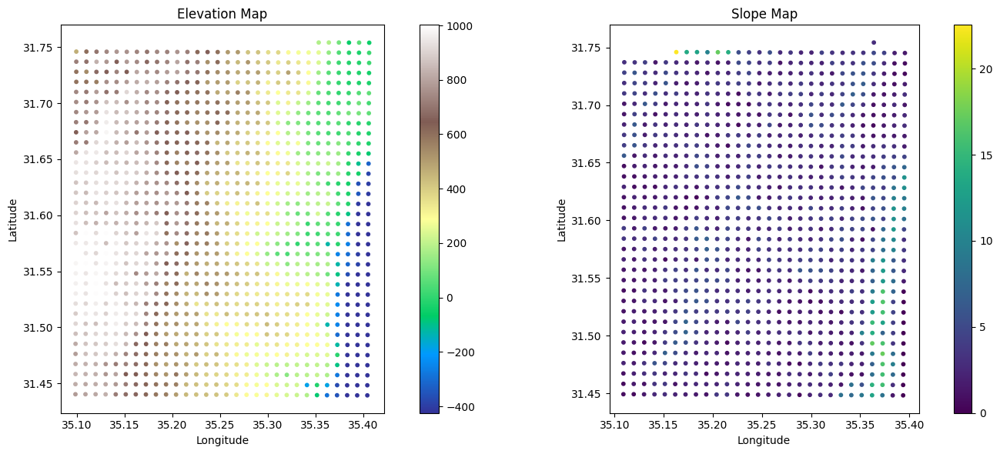

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import geopandas as gpd
from mpl_toolkits.axes_grid1 import make_axes_locatable

# Define the file path
file_path = '/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to "spatial PINN Hebrew"/dem slope/pinn_with_downscaled_dem_calculated_slope.csv'

# Load the modified CSV file
df = pd.read_csv(file_path)

# Display the first few rows
print(df.head())

# Convert DataFrame to GeoDataFrame
gdf = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df.longitude, df.latitude), crs="EPSG:4326")

# Create figure with two subplots (side by side)
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(14, 6))

# Elevation Map
ax1 = axes[0]
divider = make_axes_locatable(ax1)
cax1 = divider.append_axes("right", size="5%", pad=0.1)
sc1 = gdf.plot(column='elevation', cmap='terrain', legend=True, ax=ax1, cax=cax1, markersize=10)
ax1.set_title("Elevation Map")
ax1.set_xlabel("Longitude")
ax1.set_ylabel("Latitude")

# Slope Map
ax2 = axes[1]
divider = make_axes_locatable(ax2)
cax2 = divider.append_axes("right", size="5%", pad=0.1)
sc2 = gdf.plot(column='slope_calculated', cmap='viridis', legend=True, ax=ax2, cax=cax2, markersize=10)
ax2.set_title("Slope Map")
ax2.set_xlabel("Longitude")
ax2.set_ylabel("Latitude")

# Show the plots
plt.tight_layout()
plt.show()


In [2]:
import pandas as pd
import os

# Define the base directory
base_dir = "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to \"spatial PINN Hebrew\"/rain/"

# Define the filenames
years = [2012, 2013, 2014, 2015, 2016, 2018, 2019, 2020]
file_names = [f"filtered_North_Dead_Sea_RM{year}_cut.csv" for year in years]

# Loop through each file and display its head
for file_name in file_names:
    file_path = os.path.join(base_dir, file_name)
    
    # Check if file exists before proceeding
    if os.path.exists(file_path):
        df = pd.read_csv(file_path)
        print(f"--- Head of {file_name} ---")
        print(df.head(), "\n")
    else:
        print(f"File not found: {file_name}")


--- Head of filtered_North_Dead_Sea_RM2012_cut.csv ---
                  time  latitude  longitude  rainrate
0  2012-01-01 00:00:00   31.7542    35.3533       0.0
1  2012-01-01 00:00:00   31.7542    35.3639       0.0
2  2012-01-01 00:00:00   31.7542    35.3744       0.0
3  2012-01-01 00:00:00   31.7541    35.3850       0.0
4  2012-01-01 00:00:00   31.7541    35.3956       0.0 

--- Head of filtered_North_Dead_Sea_RM2013_cut.csv ---
                  time  latitude  longitude  rainrate
0  2013-01-01 00:00:00   31.7542    35.3533       0.0
1  2013-01-01 00:00:00   31.7542    35.3639       0.0
2  2013-01-01 00:00:00   31.7542    35.3744       0.0
3  2013-01-01 00:00:00   31.7541    35.3850       0.0
4  2013-01-01 00:00:00   31.7541    35.3956       0.0 

--- Head of filtered_North_Dead_Sea_RM2014_cut.csv ---
                  time  latitude  longitude  rainrate
0  2014-01-01 00:00:00   31.7542    35.3533       0.0
1  2014-01-01 00:00:00   31.7542    35.3639       0.0
2  2014-01-01 00:00:0

In [3]:
import pandas as pd
import os
from tqdm import tqdm

# Define file paths
base_dir = "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to \"spatial PINN Hebrew\"/rain/"
dem_slope_file = "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to \"spatial PINN Hebrew\"/dem slope/pinn_with_downscaled_dem_calculated_slope.csv"

# Define the years to process
years = [2012, 2013, 2014, 2015, 2016, 2018, 2019, 2020]
file_names = [f"filtered_North_Dead_Sea_RM{year}_cut.csv" for year in years]

# Load elevation and slope data
print("Loading DEM/Slope data...")
dem_df = pd.read_csv(dem_slope_file)
print("DEM/Slope data loaded successfully!")

# Iterate through each rain data file
for file_name in tqdm(file_names, desc="Processing rain data files"):
    file_path = os.path.join(base_dir, file_name)

    # Check if file exists
    if not os.path.exists(file_path):
        print(f"❌ File not found: {file_name}, skipping...")
        continue

    print(f"🔹 Processing {file_name}...")

    # Load rain data
    rain_df = pd.read_csv(file_path)

    # Merge with DEM/Slope data on latitude and longitude
    merged_df = rain_df.merge(dem_df, on=['latitude', 'longitude'], how='left')

    # Check merge success
    missing_elevation = merged_df['elevation'].isna().sum()
    missing_slope = merged_df['slope_calculated'].isna().sum()
    
    print(f"✅ Merged {file_name}: {len(merged_df)} rows")
    print(f"   ➡️ Missing elevation values: {missing_elevation}")
    print(f"   ➡️ Missing slope values: {missing_slope}")

    # Save the updated file (overwrite original)
    merged_df.to_csv(file_path, index=False)
    print(f"💾 File saved: {file_name}")

print("🎉 All files processed successfully!")


Loading DEM/Slope data...
DEM/Slope data loaded successfully!


Processing rain data files:   0%|                         | 0/8 [00:00<?, ?it/s]

🔹 Processing filtered_North_Dead_Sea_RM2012_cut.csv...
✅ Merged filtered_North_Dead_Sea_RM2012_cut.csv: 41665536 rows
   ➡️ Missing elevation values: 0
   ➡️ Missing slope values: 4261248


Processing rain data files:  12%|██▏              | 1/8 [01:37<11:21, 97.32s/it]

💾 File saved: filtered_North_Dead_Sea_RM2012_cut.csv
🔹 Processing filtered_North_Dead_Sea_RM2013_cut.csv...
✅ Merged filtered_North_Dead_Sea_RM2013_cut.csv: 41513472 rows
   ➡️ Missing elevation values: 0
   ➡️ Missing slope values: 4245696


Processing rain data files:  25%|████▎            | 2/8 [03:13<09:41, 96.92s/it]

💾 File saved: filtered_North_Dead_Sea_RM2013_cut.csv
🔹 Processing filtered_North_Dead_Sea_RM2014_cut.csv...
✅ Merged filtered_North_Dead_Sea_RM2014_cut.csv: 41513472 rows
   ➡️ Missing elevation values: 0
   ➡️ Missing slope values: 4245696


Processing rain data files:  38%|██████▍          | 3/8 [04:50<08:04, 96.96s/it]

💾 File saved: filtered_North_Dead_Sea_RM2014_cut.csv
🔹 Processing filtered_North_Dead_Sea_RM2015_cut.csv...
✅ Merged filtered_North_Dead_Sea_RM2015_cut.csv: 41513472 rows
   ➡️ Missing elevation values: 0
   ➡️ Missing slope values: 4245696


Processing rain data files:  50%|████████▌        | 4/8 [06:28<06:29, 97.37s/it]

💾 File saved: filtered_North_Dead_Sea_RM2015_cut.csv
🔹 Processing filtered_North_Dead_Sea_RM2016_cut.csv...
✅ Merged filtered_North_Dead_Sea_RM2016_cut.csv: 41665536 rows
   ➡️ Missing elevation values: 0
   ➡️ Missing slope values: 4261248


Processing rain data files:  62%|██████████▋      | 5/8 [08:07<04:53, 97.76s/it]

💾 File saved: filtered_North_Dead_Sea_RM2016_cut.csv
🔹 Processing filtered_North_Dead_Sea_RM2018_cut.csv...
✅ Merged filtered_North_Dead_Sea_RM2018_cut.csv: 41513472 rows
   ➡️ Missing elevation values: 0
   ➡️ Missing slope values: 4245696


Processing rain data files:  75%|████████████▊    | 6/8 [09:46<03:16, 98.07s/it]

💾 File saved: filtered_North_Dead_Sea_RM2018_cut.csv
🔹 Processing filtered_North_Dead_Sea_RM2019_cut.csv...
✅ Merged filtered_North_Dead_Sea_RM2019_cut.csv: 41513472 rows
   ➡️ Missing elevation values: 0
   ➡️ Missing slope values: 4245696


Processing rain data files:  88%|██████████████▉  | 7/8 [11:25<01:38, 98.57s/it]

💾 File saved: filtered_North_Dead_Sea_RM2019_cut.csv
🔹 Processing filtered_North_Dead_Sea_RM2020_cut.csv...
✅ Merged filtered_North_Dead_Sea_RM2020_cut.csv: 41665536 rows
   ➡️ Missing elevation values: 0
   ➡️ Missing slope values: 4261248


Processing rain data files: 100%|█████████████████| 8/8 [13:04<00:00, 98.09s/it]

💾 File saved: filtered_North_Dead_Sea_RM2020_cut.csv
🎉 All files processed successfully!


📂 Loaded 2013 Rain Data:
                  time  latitude  longitude  rainrate  elevation  \
0  2013-01-01 00:00:00   31.7542    35.3533       0.0  179.91008   
1  2013-01-01 00:00:00   31.7542    35.3639       0.0  182.38225   
2  2013-01-01 00:00:00   31.7542    35.3744       0.0   94.52771   
3  2013-01-01 00:00:00   31.7541    35.3850       0.0  -57.00375   
4  2013-01-01 00:00:00   31.7541    35.3956       0.0   60.18594   

   slope_calculated  
0               NaN  
1          2.973726  
2               NaN  
3               NaN  
4               NaN  


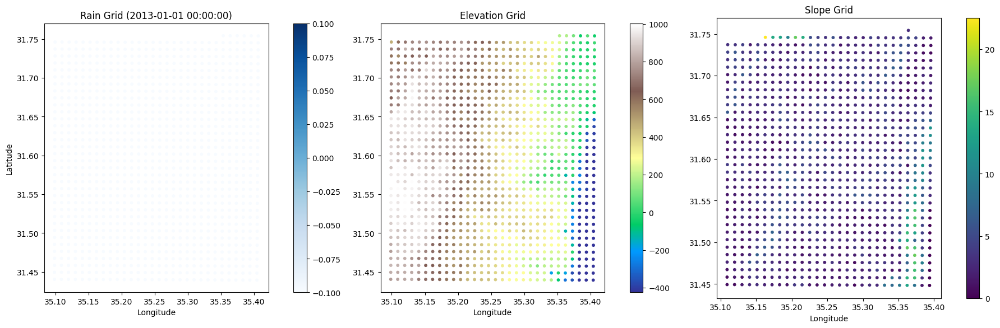

In [4]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable

# Define the rain data file for 2013
rain_file = "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to \"spatial PINN Hebrew\"/rain/filtered_North_Dead_Sea_RM2013_cut.csv"

# Load the rain data
rain_df = pd.read_csv(rain_file)

# Show the first few rows
print("📂 Loaded 2013 Rain Data:")
print(rain_df.head())

# Extract the first timestamp
first_timestamp = rain_df['time'].iloc[0]
first_timestep_df = rain_df[rain_df['time'] == first_timestamp]

# Convert to GeoDataFrame
gdf = gpd.GeoDataFrame(first_timestep_df, geometry=gpd.points_from_xy(first_timestep_df.longitude, first_timestep_df.latitude), crs="EPSG:4326")

# Create figure with three subplots
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(18, 6))

# Rain Grid
ax1 = axes[0]
divider1 = make_axes_locatable(ax1)
cax1 = divider1.append_axes("right", size="5%", pad=0.1)
gdf.plot(column='rainrate', cmap='Blues', legend=True, ax=ax1, cax=cax1, markersize=10)
ax1.set_title(f"Rain Grid ({first_timestamp})")
ax1.set_xlabel("Longitude")
ax1.set_ylabel("Latitude")

# Elevation Grid
ax2 = axes[1]
divider2 = make_axes_locatable(ax2)
cax2 = divider2.append_axes("right", size="5%", pad=0.1)
gdf.plot(column='elevation', cmap='terrain', legend=True, ax=ax2, cax=cax2, markersize=10)
ax2.set_title("Elevation Grid")
ax2.set_xlabel("Longitude")

# Slope Grid
ax3 = axes[2]
divider3 = make_axes_locatable(ax3)
cax3 = divider3.append_axes("right", size="5%", pad=0.1)
gdf.plot(column='slope_calculated', cmap='viridis', legend=True, ax=ax3, cax=cax3, markersize=10)
ax3.set_title("Slope Grid")
ax3.set_xlabel("Longitude")

# Show plots
plt.tight_layout()
plt.show()


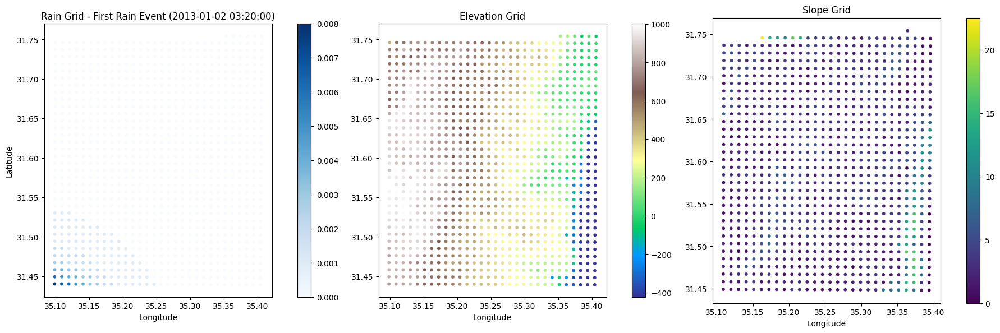

In [6]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable

# Define the rain data file for 2013
rain_file = "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to \"spatial PINN Hebrew\"/rain/filtered_North_Dead_Sea_RM2013_cut.csv"

# Load the rain data
rain_df = pd.read_csv(rain_file)

# Convert 'time' column to datetime
rain_df['time'] = pd.to_datetime(rain_df['time'])

# Find the first timestamp where rainrate is nonzero
nonzero_rain_df = rain_df[rain_df['rainrate'] > 0]
if not nonzero_rain_df.empty:
    first_rain_timestamp = nonzero_rain_df['time'].min()
else:
    print("⚠️ No nonzero rain values found in dataset!")
    first_rain_timestamp = rain_df['time'].iloc[0]  # Default to first timestamp

# Filter data for the first rain event
first_rain_df = rain_df[rain_df['time'] == first_rain_timestamp]

# Convert to GeoDataFrame
gdf = gpd.GeoDataFrame(first_rain_df, 
                        geometry=gpd.points_from_xy(first_rain_df.longitude, first_rain_df.latitude), 
                        crs="EPSG:4326")

# Create figure with three subplots
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(18, 6))

# 📌 Rain Grid (Rainrate)
ax1 = axes[0]
divider1 = make_axes_locatable(ax1)
cax1 = divider1.append_axes("right", size="5%", pad=0.1)
gdf.plot(column='rainrate', cmap='Blues', legend=True, ax=ax1, cax=cax1, markersize=10)
ax1.set_title(f"Rain Grid - First Rain Event ({first_rain_timestamp})")
ax1.set_xlabel("Longitude")
ax1.set_ylabel("Latitude")

# 📌 Elevation Grid
ax2 = axes[1]
divider2 = make_axes_locatable(ax2)
cax2 = divider2.append_axes("right", size="5%", pad=0.1)
gdf.plot(column='elevation', cmap='terrain', legend=True, ax=ax2, cax=cax2, markersize=10)
ax2.set_title("Elevation Grid")
ax2.set_xlabel("Longitude")

# 📌 Slope Grid
ax3 = axes[2]
divider3 = make_axes_locatable(ax3)
cax3 = divider3.append_axes("right", size="5%", pad=0.1)
gdf.plot(column='slope_calculated', cmap='viridis', legend=True, ax=ax3, cax=cax3, markersize=10)
ax3.set_title("Slope Grid")
ax3.set_xlabel("Longitude")

# Show plots
plt.tight_layout()
plt.show()


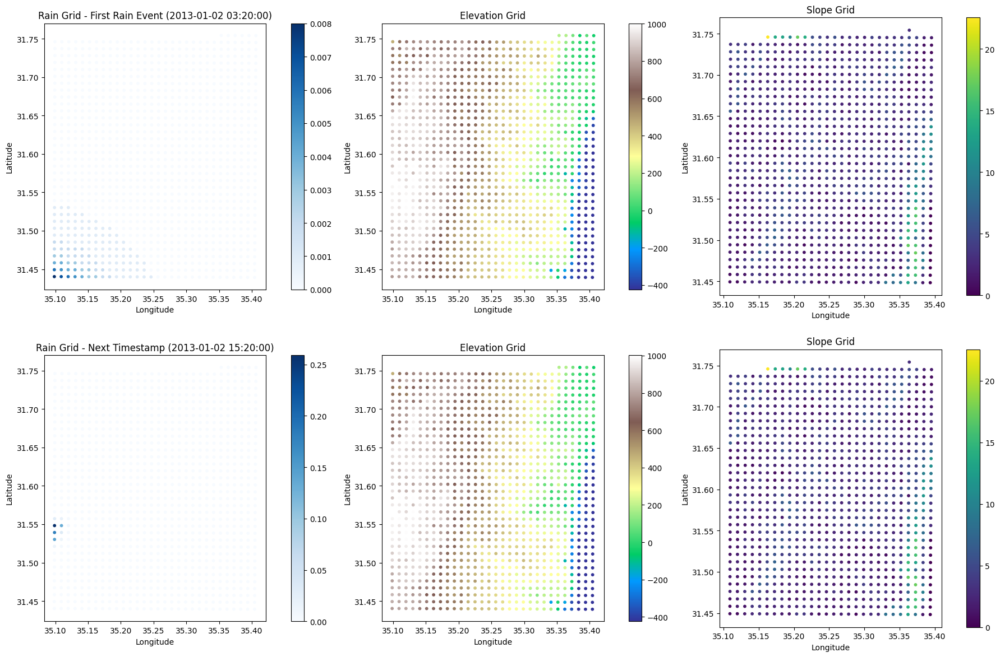

In [7]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable

# Load the rain data
rain_file = "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to \"spatial PINN Hebrew\"/rain/filtered_North_Dead_Sea_RM2013_cut.csv"
rain_df = pd.read_csv(rain_file)

# Convert 'time' column to datetime
rain_df['time'] = pd.to_datetime(rain_df['time'])

# Find the first timestamp where rainrate is nonzero
nonzero_rain_df = rain_df[rain_df['rainrate'] > 0]
if not nonzero_rain_df.empty:
    first_rain_timestamp = nonzero_rain_df['time'].min()
    # Find the next timestamp
    sorted_timestamps = nonzero_rain_df['time'].sort_values().unique()
    next_rain_timestamp = sorted_timestamps[1] if len(sorted_timestamps) > 1 else first_rain_timestamp
else:
    print("⚠️ No nonzero rain values found in dataset!")
    first_rain_timestamp = rain_df['time'].iloc[0]
    next_rain_timestamp = first_rain_timestamp  # Fallback if no rain is found

# Filter data for the two timestamps
first_rain_df = rain_df[rain_df['time'] == first_rain_timestamp]
next_rain_df = rain_df[rain_df['time'] == next_rain_timestamp]

# Convert to GeoDataFrames
gdf_first = gpd.GeoDataFrame(first_rain_df, 
                             geometry=gpd.points_from_xy(first_rain_df.longitude, first_rain_df.latitude), 
                             crs="EPSG:4326")

gdf_next = gpd.GeoDataFrame(next_rain_df, 
                            geometry=gpd.points_from_xy(next_rain_df.longitude, next_rain_df.latitude), 
                            crs="EPSG:4326")

# Create figure with six subplots (2 rows: first & next timestamps)
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(18, 12))

def plot_grid(ax, gdf, column, cmap, title):
    """Helper function to plot a GeoDataFrame with a colorbar."""
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.1)
    gdf.plot(column=column, cmap=cmap, legend=True, ax=ax, cax=cax, markersize=10)
    ax.set_title(title)
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")

# 📌 First timestamp (Row 1)
plot_grid(axes[0, 0], gdf_first, 'rainrate', 'Blues', f"Rain Grid - First Rain Event ({first_rain_timestamp})")
plot_grid(axes[0, 1], gdf_first, 'elevation', 'terrain', "Elevation Grid")
plot_grid(axes[0, 2], gdf_first, 'slope_calculated', 'viridis', "Slope Grid")

# 📌 Next timestamp (Row 2)
plot_grid(axes[1, 0], gdf_next, 'rainrate', 'Blues', f"Rain Grid - Next Timestamp ({next_rain_timestamp})")
plot_grid(axes[1, 1], gdf_next, 'elevation', 'terrain', "Elevation Grid")
plot_grid(axes[1, 2], gdf_next, 'slope_calculated', 'viridis', "Slope Grid")

# Show plots
plt.tight_layout()
plt.show()


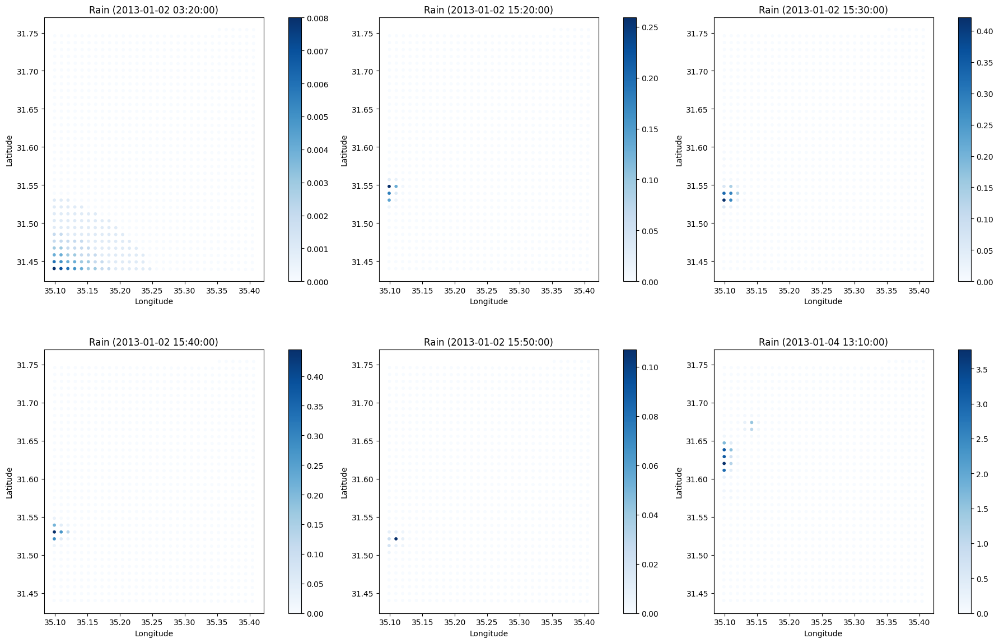

In [8]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable

# Load the rain data
rain_file = "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to \"spatial PINN Hebrew\"/rain/filtered_North_Dead_Sea_RM2013_cut.csv"
rain_df = pd.read_csv(rain_file)

# Convert 'time' column to datetime
rain_df['time'] = pd.to_datetime(rain_df['time'])

# Find the first timestamp where rainrate is nonzero
nonzero_rain_df = rain_df[rain_df['rainrate'] > 0]
if not nonzero_rain_df.empty:
    first_rain_timestamp = nonzero_rain_df['time'].min()
    # Get the next 5 timestamps
    sorted_timestamps = nonzero_rain_df['time'].sort_values().unique()
    next_rain_timestamps = sorted_timestamps[:6]  # Get first 6 timestamps (including first)
else:
    print("⚠️ No nonzero rain values found in dataset!")
    next_rain_timestamps = [rain_df['time'].iloc[0]] * 6  # Fallback if no rain is found

# Convert data for each timestamp into GeoDataFrames
gdfs = []
for timestamp in next_rain_timestamps:
    subset_df = rain_df[rain_df['time'] == timestamp]
    gdf = gpd.GeoDataFrame(subset_df, 
                            geometry=gpd.points_from_xy(subset_df.longitude, subset_df.latitude), 
                            crs="EPSG:4326")
    gdfs.append((timestamp, gdf))

# Create figure with six subplots (2 rows × 3 columns)
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(18, 12))

def plot_grid(ax, gdf, column, cmap, title):
    """Helper function to plot a GeoDataFrame with a colorbar."""
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.1)
    gdf.plot(column=column, cmap=cmap, legend=True, ax=ax, cax=cax, markersize=10)
    ax.set_title(title)
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")

# 📌 Plot the first 6 timestamps
for i, (timestamp, gdf) in enumerate(gdfs):
    row, col = divmod(i, 3)  # Arrange in 2 rows, 3 columns
    plot_grid(axes[row, col], gdf, 'rainrate', 'Blues', f"Rain ({timestamp})")

# Show plots
plt.tight_layout()
plt.show()


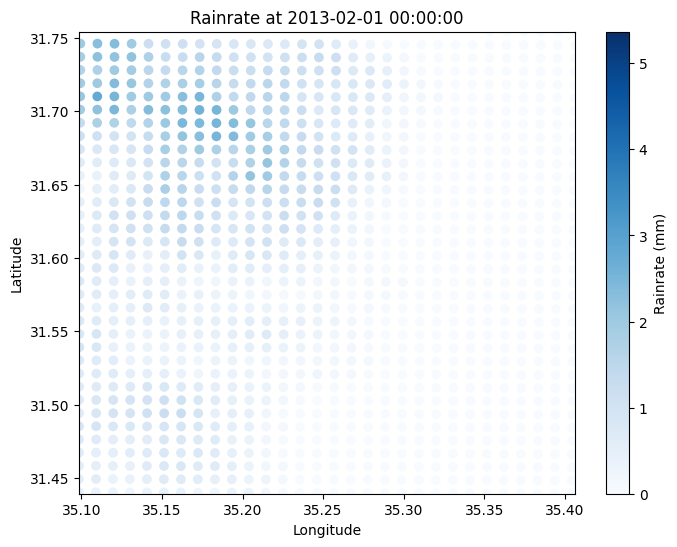

In [15]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Load the rain data
rain_file = "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to \"spatial PINN Hebrew\"/rain/filtered_North_Dead_Sea_RM2013_cut.csv"
rain_df = pd.read_csv(rain_file)

# Convert 'time' column to datetime
rain_df['time'] = pd.to_datetime(rain_df['time'])

# Filter data for January 2, 2013
selected_date = "2013-02-01"
daily_df = rain_df[rain_df['time'].dt.strftime('%Y-%m-%d') == selected_date]

# Get unique timestamps for the day (sorted)
timestamps = sorted(daily_df['time'].unique())

# Set up the figure and axis
fig, ax = plt.subplots(figsize=(8, 6))
sc = ax.scatter([], [], c=[], cmap="Blues", vmin=0, vmax=daily_df["rainrate"].max())
ax.set_xlim(daily_df["longitude"].min(), daily_df["longitude"].max())
ax.set_ylim(daily_df["latitude"].min(), daily_df["latitude"].max())
ax.set_xlabel("Longitude")
ax.set_ylabel("Latitude")
ax.set_title(f"Rain Animation for {selected_date}")

# Colorbar
cbar = plt.colorbar(sc, ax=ax)
cbar.set_label("Rainrate (mm)")

# Animation function
def update(frame):
    current_time = timestamps[frame]
    subset = daily_df[daily_df["time"] == current_time]
    sc.set_offsets(subset[["longitude", "latitude"]].values)
    sc.set_array(subset["rainrate"].values)
    ax.set_title(f"Rainrate at {current_time}")

# Create animation
ani = animation.FuncAnimation(fig, update, frames=len(timestamps), interval=200, repeat=True)

# Display animation in Jupyter
HTML(ani.to_jshtml())


In [16]:
import pandas as pd

# Define the file path
file_path = "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to \"spatial PINN Hebrew\"/discharge/Northern Dead Sea discharge_2012.csv"

# Load the CSV file
df = pd.read_csv(file_path)

# Display the first few rows
print(df.head())


   name  shd_id                 date  rg_qms source       lon       lat
0  דרגה   48125  2012-01-01 00:00:00     0.0    HSI  35.36552  31.60015
1  דרגה   48125  2012-01-01 00:10:00     0.0    HSI  35.36552  31.60015
2  דרגה   48125  2012-01-01 00:20:00     0.0    HSI  35.36552  31.60015
3  דרגה   48125  2012-01-01 00:30:00     0.0    HSI  35.36552  31.60015
4  דרגה   48125  2012-01-01 00:40:00     0.0    HSI  35.36552  31.60015


In [17]:
import pandas as pd
import os

# Define the directory containing the files
directory = "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to \"spatial PINN Hebrew\"/discharge"

# List of files to process
years = [2012, 2013, 2014, 2015, 2016, 2018, 2019, 2020]

for year in years:
    file_path = os.path.join(directory, f"Northern Dead Sea discharge_{year}.csv")
    df = pd.read_csv(file_path)
    
    # Drop the specified columns
    df = df.drop(columns=["shd_id", "source"], errors='ignore')
    
    # Save the modified file
    df.to_csv(file_path, index=False)
    print(f"Processed: {file_path}")


Processed: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to "spatial PINN Hebrew"/discharge/Northern Dead Sea discharge_2012.csv
Processed: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to "spatial PINN Hebrew"/discharge/Northern Dead Sea discharge_2013.csv
Processed: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to "spatial PINN Hebrew"/discharge/Northern Dead Sea discharge_2014.csv
Processed: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to "spatial PINN Hebrew"/discharge/Northern Dead Sea discharge_2015.csv
Processed: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to "spatial PINN Hebrew"/discharge/Northern Dead Sea discharge_2016.csv
Processed: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to "spatia

In [18]:
import pandas as pd

# Define the file path
file_path = "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to \"spatial PINN Hebrew\"/discharge/Northern Dead Sea discharge_2012.csv"

# Load the CSV file
df = pd.read_csv(file_path)

# Display the first few rows
print(df.head())


   name                 date  rg_qms       lon       lat
0  דרגה  2012-01-01 00:00:00     0.0  35.36552  31.60015
1  דרגה  2012-01-01 00:10:00     0.0  35.36552  31.60015
2  דרגה  2012-01-01 00:20:00     0.0  35.36552  31.60015
3  דרגה  2012-01-01 00:30:00     0.0  35.36552  31.60015
4  דרגה  2012-01-01 00:40:00     0.0  35.36552  31.60015


In [19]:
import pandas as pd
import os

# Define the directory containing the files
directory = "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to \"spatial PINN Hebrew\"/discharge"

# List of files to process
years = [2012, 2013, 2014, 2015, 2016, 2018, 2019, 2020]

# Dictionary for updating lat/lon values
updated_locations = {
    "דרגה": (31.6013, 35.3630),
    "תקוע": (31.5834, 35.3523),
    "ערוגות במעלה כביש90": (31.4573, 35.3937)
}

for year in years:
    file_path = os.path.join(directory, f"Northern Dead Sea discharge_{year}.csv")
    df = pd.read_csv(file_path)
    
    # Drop the specified columns
    df = df.drop(columns=["shd_id", "source"], errors='ignore')
    
    # Update lat/lon based on name mapping
    df.loc[df['name'].isin(updated_locations), ['lat', 'lon']] = df['name'].map(updated_locations).apply(pd.Series)
    
    # Save the modified file
    df.to_csv(file_path, index=False)
    print(f"Processed: {file_path}")


Processed: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to "spatial PINN Hebrew"/discharge/Northern Dead Sea discharge_2012.csv
Processed: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to "spatial PINN Hebrew"/discharge/Northern Dead Sea discharge_2013.csv
Processed: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to "spatial PINN Hebrew"/discharge/Northern Dead Sea discharge_2014.csv
Processed: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to "spatial PINN Hebrew"/discharge/Northern Dead Sea discharge_2015.csv
Processed: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to "spatial PINN Hebrew"/discharge/Northern Dead Sea discharge_2016.csv
Processed: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to "spatia

In [29]:
import pandas as pd
import os

# Define the base path
base_path = "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to 'spatial PINN Hebrew'/discharge"

# List of years to check
years = [2012, 2013, 2014, 2015, 2016, 2018, 2019, 2020]

# Loop through each file and print the head
for year in years:
    file_path = os.path.join(base_path, f"Northern Dead Sea discharge_{year}.csv")
    
    if os.path.exists(file_path):
        print(f"\nHead of file: {file_path}")
        df = pd.read_csv(file_path)
        print(df.head())
    else:
        print(f"\nFile not found: {file_path}")



File not found: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to 'spatial PINN Hebrew'/discharge/Northern Dead Sea discharge_2012.csv

File not found: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to 'spatial PINN Hebrew'/discharge/Northern Dead Sea discharge_2013.csv

File not found: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to 'spatial PINN Hebrew'/discharge/Northern Dead Sea discharge_2014.csv

File not found: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to 'spatial PINN Hebrew'/discharge/Northern Dead Sea discharge_2015.csv

File not found: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to 'spatial PINN Hebrew'/discharge/Northern Dead Sea discharge_2016.csv

File not found: /media/data-ssd/PINN/DATA/model data after proccessing/full POC mode

In [4]:
import os
import glob
import pandas as pd

# Directory containing your cropped CSV files
data_dir = "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to 'spatial PINN Hebrew'/merged/sep2may"

# Retrieve a list of CSV files in the directory
csv_files = glob.glob(os.path.join(data_dir, "*.csv"))

# Define the months to check: September (9) to December (12)
check_months = [9, 10, 11, 12]

for file in csv_files:
    print(f"Checking file: {os.path.basename(file)}")
    
    # Read the CSV file and convert the 'time' column to datetime
    df = pd.read_csv(file)
    df['time'] = pd.to_datetime(df['time'], errors='coerce')
    
    # Focus on the rows where rg_qms is valid (i.e. the 3 pixels that have data)
    df_valid = df[df['rg_qms'].notna()]
    
    # Further filter to records in September to December
    df_sept_dec = df_valid[df_valid['time'].dt.month.isin(check_months)]
    
    if df_sept_dec.empty:
        print("  No valid rg_qms data in September to December for this file.")
        print("-" * 50)
        continue
    
    # Identify the unique stations (pixels) from these rows
    stations = df_sept_dec[['latitude', 'longitude']].drop_duplicates().reset_index(drop=True)
    
    # It is expected to have 3 stations, but we check all that are present
    for _, station in stations.iterrows():
        lat = station['latitude']
        lon = station['longitude']
        df_station = df_sept_dec[(df_sept_dec['latitude'] == lat) & (df_sept_dec['longitude'] == lon)]
        max_rg_qms = df_station['rg_qms'].max()
        if max_rg_qms > 0:
            print(f"  Station at (lat: {lat}, lon: {lon}) has a nonzero rg_qms value (max = {max_rg_qms}) in Sept-Dec.")
        else:
            print(f"  Station at (lat: {lat}, lon: {lon}) has all rg_qms values equal to zero in Sept-Dec.")
    
    print("-" * 50)


Checking file: Merged_North_Dead_Sea_2015.csv
  Station at (lat: 31.6013, lon: 35.363) has a nonzero rg_qms value (max = 0.0506) in Sept-Dec.
  Station at (lat: 31.5834, lon: 35.3523) has all rg_qms values equal to zero in Sept-Dec.
  Station at (lat: 31.4573, lon: 35.3937) has a nonzero rg_qms value (max = 6.1941) in Sept-Dec.
--------------------------------------------------
Checking file: Merged_North_Dead_Sea_2018.csv
  Station at (lat: 31.6013, lon: 35.363) has a nonzero rg_qms value (max = 22.819) in Sept-Dec.
  Station at (lat: 31.5834, lon: 35.3523) has a nonzero rg_qms value (max = 5.87) in Sept-Dec.
  Station at (lat: 31.4573, lon: 35.3937) has a nonzero rg_qms value (max = 86.0322) in Sept-Dec.
--------------------------------------------------
Checking file: Merged_North_Dead_Sea_2013.csv
  Station at (lat: 31.6013, lon: 35.363) has a nonzero rg_qms value (max = 7.6125) in Sept-Dec.
  Station at (lat: 31.5834, lon: 35.3523) has a nonzero rg_qms value (max = 15.22) in Sept-

In [5]:
import os
import glob
import pandas as pd

# Directory containing your cropped CSV files
data_dir = "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to 'spatial PINN Hebrew'/merged/sep2may"

# Retrieve a list of CSV files in the directory
csv_files = glob.glob(os.path.join(data_dir, "*.csv"))

# Define the month to check: September (9)
check_month = 9

for file in csv_files:
    print(f"Checking file: {os.path.basename(file)}")
    
    # Read the CSV file and convert the 'time' column to datetime
    df = pd.read_csv(file)
    df['time'] = pd.to_datetime(df['time'], errors='coerce')
    
    # Focus on rows with valid rg_qms values (i.e., the 3 pixels) and filter for September only
    df_valid = df[df['rg_qms'].notna()]
    df_sept = df_valid[df_valid['time'].dt.month == check_month]
    
    if df_sept.empty:
        print("  No valid rg_qms data in September for this file.")
        print("-" * 50)
        continue
    
    # Identify the unique stations (pixels) from these rows
    stations = df_sept[['latitude', 'longitude']].drop_duplicates().reset_index(drop=True)
    
    for _, station in stations.iterrows():
        lat = station['latitude']
        lon = station['longitude']
        df_station = df_sept[(df_sept['latitude'] == lat) & (df_sept['longitude'] == lon)]
        max_rg_qms = df_station['rg_qms'].max()
        if max_rg_qms > 0:
            print(f"  Station at (lat: {lat}, lon: {lon}) has a nonzero rg_qms value (max = {max_rg_qms}) in September.")
        else:
            print(f"  Station at (lat: {lat}, lon: {lon}) has all rg_qms values equal to zero in September.")
    
    print("-" * 50)


Checking file: Merged_North_Dead_Sea_2015.csv
  Station at (lat: 31.6013, lon: 35.363) has all rg_qms values equal to zero in September.
  Station at (lat: 31.5834, lon: 35.3523) has all rg_qms values equal to zero in September.
  Station at (lat: 31.4573, lon: 35.3937) has all rg_qms values equal to zero in September.
--------------------------------------------------
Checking file: Merged_North_Dead_Sea_2018.csv
  Station at (lat: 31.6013, lon: 35.363) has all rg_qms values equal to zero in September.
  Station at (lat: 31.5834, lon: 35.3523) has all rg_qms values equal to zero in September.
  Station at (lat: 31.4573, lon: 35.3937) has all rg_qms values equal to zero in September.
--------------------------------------------------
Checking file: Merged_North_Dead_Sea_2013.csv
  Station at (lat: 31.6013, lon: 35.363) has all rg_qms values equal to zero in September.
  Station at (lat: 31.5834, lon: 35.3523) has all rg_qms values equal to zero in September.
  Station at (lat: 31.4573,

In [6]:
import os
import glob
import pandas as pd

# Directory containing your cropped CSV files
data_dir = "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to 'spatial PINN Hebrew'/merged/sep2may"

# Retrieve a list of CSV files in the directory
csv_files = glob.glob(os.path.join(data_dir, "*.csv"))

# Define the month to check: October (10)
check_month = 10

for file in csv_files:
    print(f"Checking file: {os.path.basename(file)}")
    
    # Read the CSV file and convert the 'time' column to datetime
    df = pd.read_csv(file)
    df['time'] = pd.to_datetime(df['time'], errors='coerce')
    
    # Focus on rows with valid rg_qms values (the 3 pixels) and filter for October only
    df_valid = df[df['rg_qms'].notna()]
    df_oct = df_valid[df_valid['time'].dt.month == check_month]
    
    if df_oct.empty:
        print("  No valid rg_qms data in October for this file.")
        print("-" * 50)
        continue
    
    # Identify the unique stations (pixels) from these rows
    stations = df_oct[['latitude', 'longitude']].drop_duplicates().reset_index(drop=True)
    
    for _, station in stations.iterrows():
        lat = station['latitude']
        lon = station['longitude']
        df_station = df_oct[(df_oct['latitude'] == lat) & (df_oct['longitude'] == lon)]
        max_rg_qms = df_station['rg_qms'].max()
        if max_rg_qms > 0:
            print(f"  Station at (lat: {lat}, lon: {lon}) has a nonzero rg_qms value (max = {max_rg_qms}) in October.")
        else:
            print(f"  Station at (lat: {lat}, lon: {lon}) has all rg_qms values equal to zero in October.")
    
    print("-" * 50)


Checking file: Merged_North_Dead_Sea_2015.csv
  Station at (lat: 31.6013, lon: 35.363) has a nonzero rg_qms value (max = 0.0286) in October.
  Station at (lat: 31.5834, lon: 35.3523) has all rg_qms values equal to zero in October.
  Station at (lat: 31.4573, lon: 35.3937) has a nonzero rg_qms value (max = 6.1941) in October.
--------------------------------------------------
Checking file: Merged_North_Dead_Sea_2018.csv
  Station at (lat: 31.6013, lon: 35.363) has a nonzero rg_qms value (max = 22.819) in October.
  Station at (lat: 31.5834, lon: 35.3523) has a nonzero rg_qms value (max = 5.87) in October.
  Station at (lat: 31.4573, lon: 35.3937) has a nonzero rg_qms value (max = 7.851) in October.
--------------------------------------------------
Checking file: Merged_North_Dead_Sea_2013.csv
  Station at (lat: 31.6013, lon: 35.363) has all rg_qms values equal to zero in October.
  Station at (lat: 31.5834, lon: 35.3523) has all rg_qms values equal to zero in October.
  Station at (la

In [7]:
import os
import glob
import pandas as pd

# Directory containing your cropped CSV files
data_dir = "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to 'spatial PINN Hebrew'/merged/sep2may"

# Retrieve a list of CSV files in the directory
csv_files = glob.glob(os.path.join(data_dir, "*.csv"))

# Define the month to check: May (5)
check_month = 5

for file in csv_files:
    print(f"Checking file: {os.path.basename(file)}")
    
    # Read the CSV file and convert the 'time' column to datetime
    df = pd.read_csv(file)
    df['time'] = pd.to_datetime(df['time'], errors='coerce')
    
    # Focus on rows with valid rg_qms values (the 3 pixels) and filter for May only
    df_valid = df[df['rg_qms'].notna()]
    df_may = df_valid[df_valid['time'].dt.month == check_month]
    
    if df_may.empty:
        print("  No valid rg_qms data in May for this file.")
        print("-" * 50)
        continue
    
    # Identify the unique stations (pixels) from these rows
    stations = df_may[['latitude', 'longitude']].drop_duplicates().reset_index(drop=True)
    
    for _, station in stations.iterrows():
        lat = station['latitude']
        lon = station['longitude']
        df_station = df_may[(df_may['latitude'] == lat) & (df_may['longitude'] == lon)]
        max_rg_qms = df_station['rg_qms'].max()
        if max_rg_qms > 0:
            print(f"  Station at (lat: {lat}, lon: {lon}) has a nonzero rg_qms value (max = {max_rg_qms}) in May.")
        else:
            print(f"  Station at (lat: {lat}, lon: {lon}) has all rg_qms values equal to zero in May.")
    
    print("-" * 50)


Checking file: Merged_North_Dead_Sea_2015.csv
  Station at (lat: 31.6013, lon: 35.363) has all rg_qms values equal to zero in May.
  Station at (lat: 31.5834, lon: 35.3523) has all rg_qms values equal to zero in May.
  Station at (lat: 31.4573, lon: 35.3937) has all rg_qms values equal to zero in May.
--------------------------------------------------
Checking file: Merged_North_Dead_Sea_2018.csv
  Station at (lat: 31.6013, lon: 35.363) has a nonzero rg_qms value (max = 0.0704) in May.
  Station at (lat: 31.5834, lon: 35.3523) has all rg_qms values equal to zero in May.
  Station at (lat: 31.4573, lon: 35.3937) has all rg_qms values equal to zero in May.
--------------------------------------------------
Checking file: Merged_North_Dead_Sea_2013.csv
  Station at (lat: 31.6013, lon: 35.363) has all rg_qms values equal to zero in May.
  Station at (lat: 31.5834, lon: 35.3523) has all rg_qms values equal to zero in May.
  Station at (lat: 31.4573, lon: 35.3937) has all rg_qms values equal

In [8]:
import os
import glob
import pandas as pd

# Directory containing your CSV files in the "sep2may" folder
data_dir = "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to 'spatial PINN Hebrew'/merged/sep2may"

# Retrieve a list of CSV files in the directory
csv_files = glob.glob(os.path.join(data_dir, "*.csv"))

# Define the months to delete: May (5), September (9), October (10)
delete_months = {5, 9, 10}

for file in csv_files:
    print(f"Processing file: {os.path.basename(file)}")
    
    # Read the CSV file into a DataFrame and convert the 'time' column to datetime
    df = pd.read_csv(file)
    df['time'] = pd.to_datetime(df['time'], errors='coerce')
    
    # Filter out rows where the month is in delete_months
    df_filtered = df[~df['time'].dt.month.isin(delete_months)]
    
    # Overwrite the original file with the filtered DataFrame
    df_filtered.to_csv(file, index=False)
    
    print(f"Updated file saved: {os.path.basename(file)}")
    print("-" * 50)


Processing file: Merged_North_Dead_Sea_2015.csv
Updated file saved: Merged_North_Dead_Sea_2015.csv
--------------------------------------------------
Processing file: Merged_North_Dead_Sea_2018.csv
Updated file saved: Merged_North_Dead_Sea_2018.csv
--------------------------------------------------
Processing file: Merged_North_Dead_Sea_2013.csv
Updated file saved: Merged_North_Dead_Sea_2013.csv
--------------------------------------------------
Processing file: Merged_North_Dead_Sea_2014.csv
Updated file saved: Merged_North_Dead_Sea_2014.csv
--------------------------------------------------
Processing file: Merged_North_Dead_Sea_2016.csv
Updated file saved: Merged_North_Dead_Sea_2016.csv
--------------------------------------------------
Processing file: Merged_North_Dead_Sea_2019.csv
Updated file saved: Merged_North_Dead_Sea_2019.csv
--------------------------------------------------
Processing file: Merged_North_Dead_Sea_2012.csv
Updated file saved: Merged_North_Dead_Sea_2012.csv
-

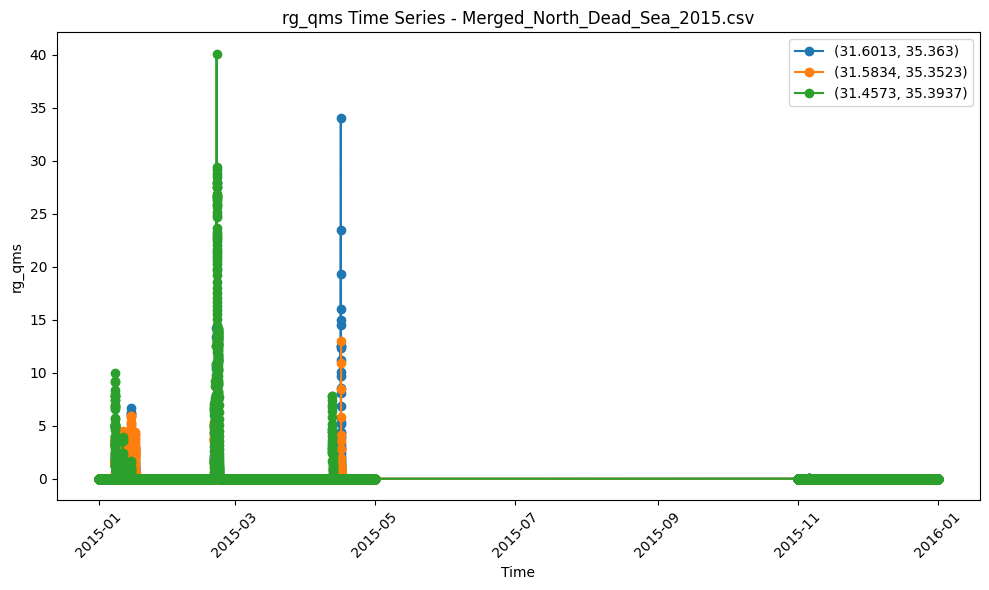

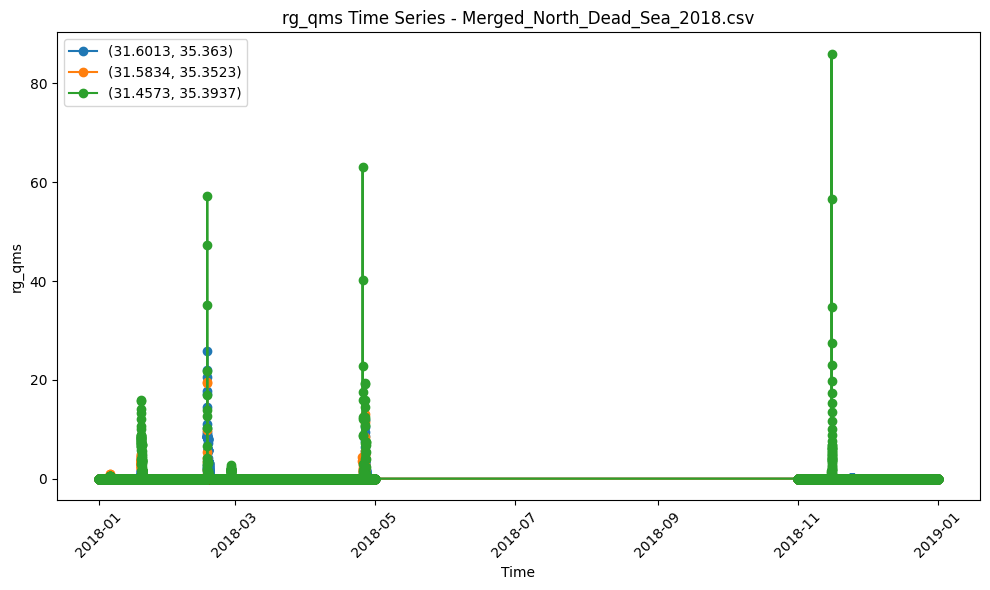

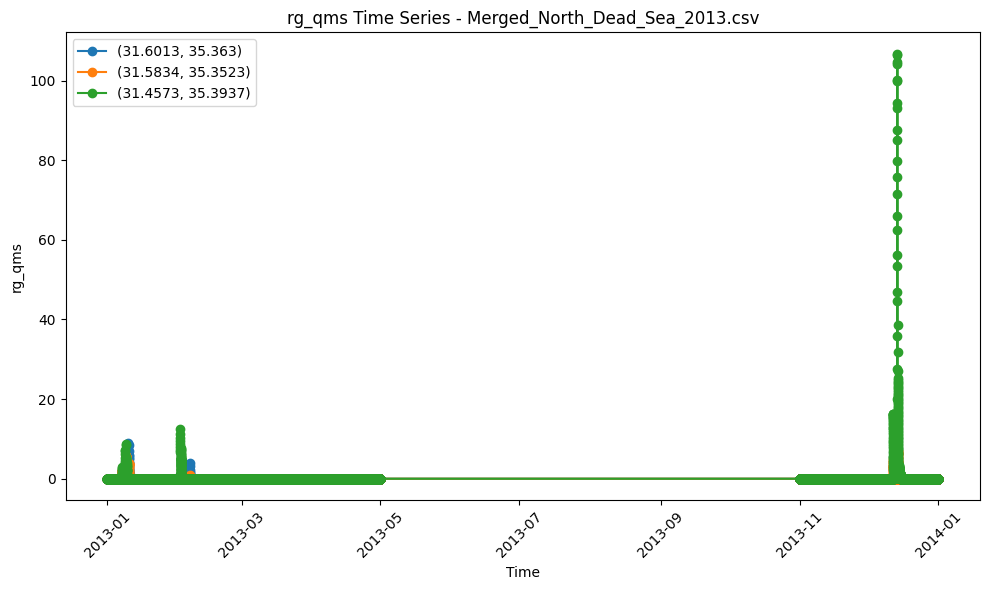

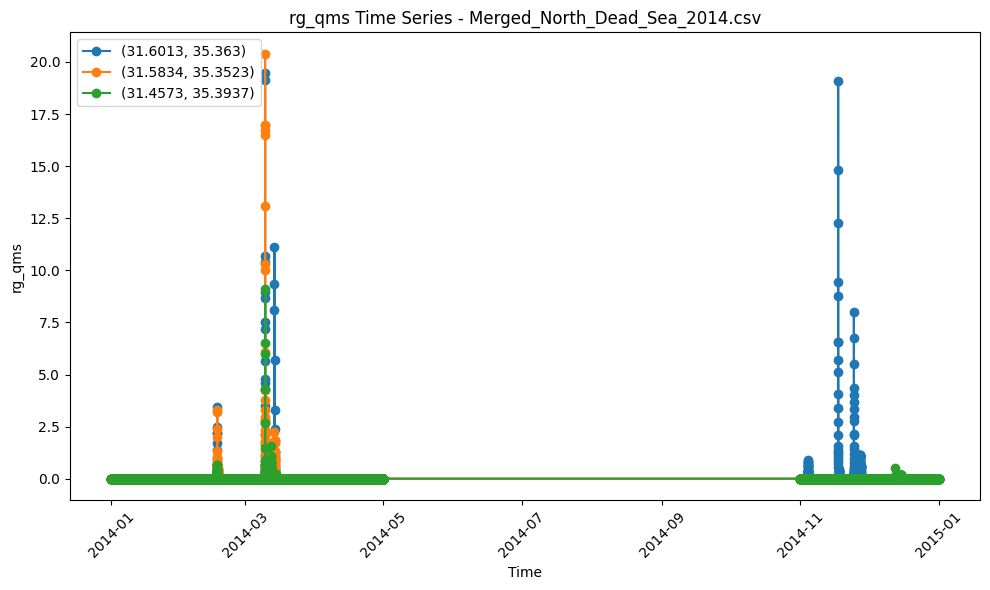

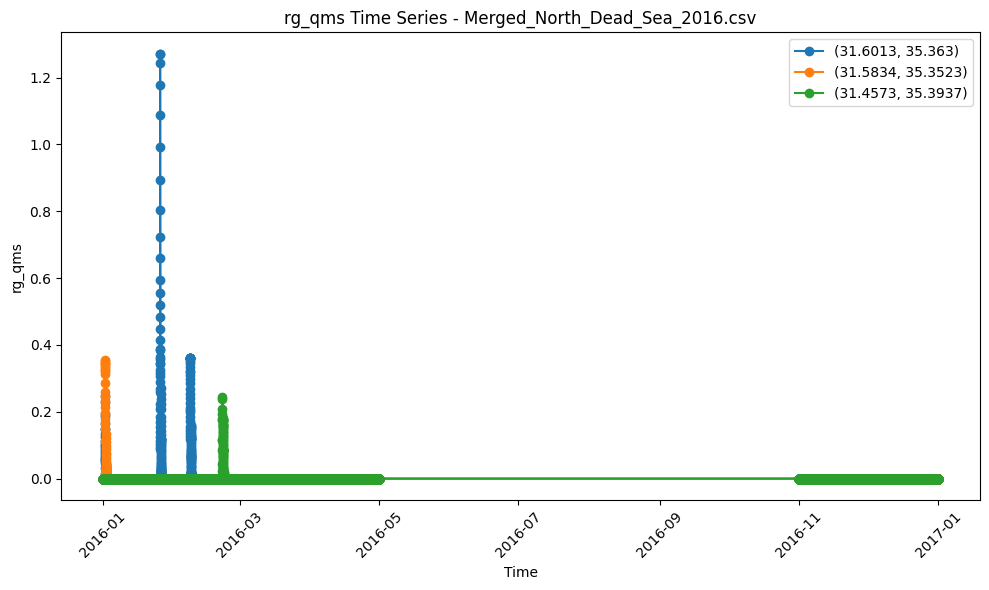

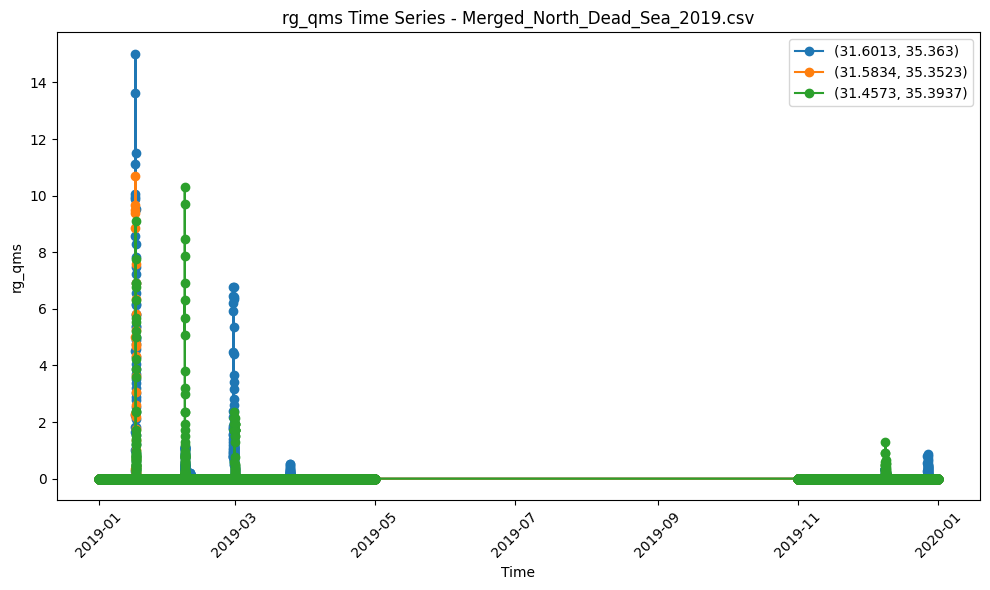

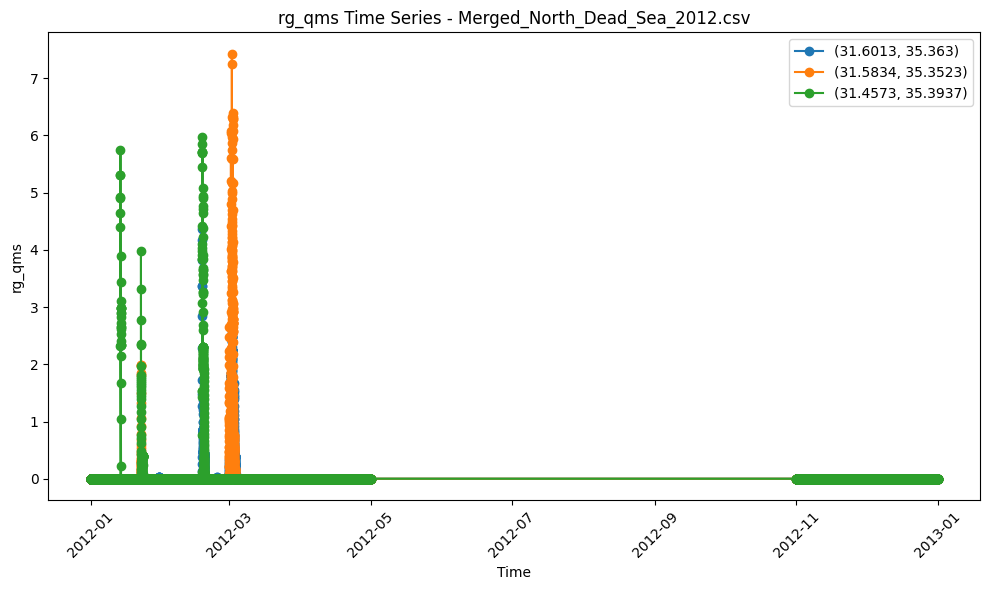

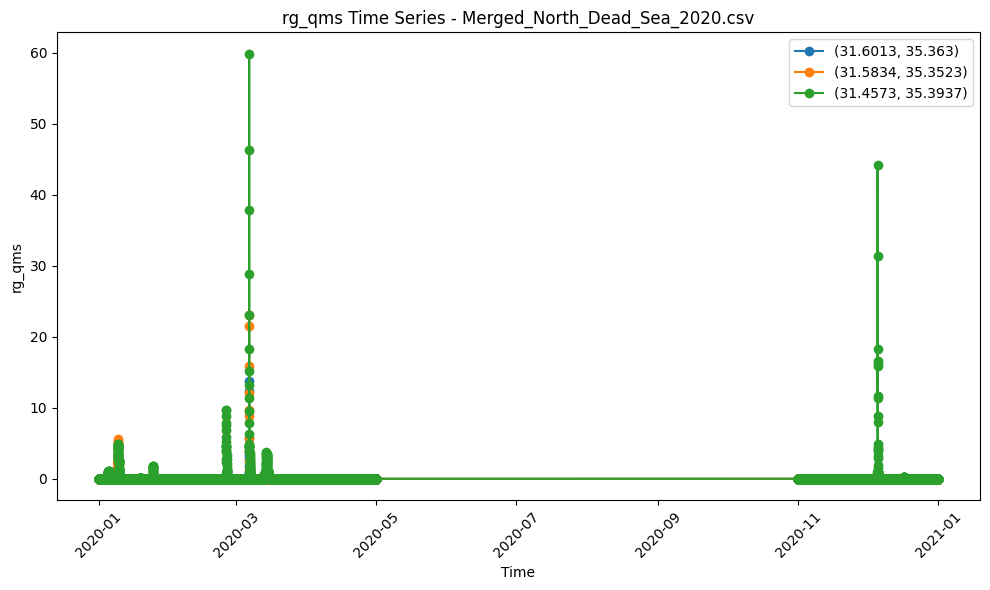

In [9]:
import os
import glob
import pandas as pd
import matplotlib.pyplot as plt

# Directory containing your CSV files in the "sep2may" folder
data_dir = "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to 'spatial PINN Hebrew'/merged/sep2may"

# Retrieve a list of CSV files in the directory
csv_files = glob.glob(os.path.join(data_dir, "*.csv"))

# Loop over each file (each file is assumed to be one year)
for file in csv_files:
    # Load data and convert 'time' column to datetime
    df = pd.read_csv(file)
    df['time'] = pd.to_datetime(df['time'], errors='coerce')
    
    # Filter for rows with valid rg_qms values (i.e. the three pixels)
    df_valid = df[df['rg_qms'].notna()]
    
    # Identify unique stations based on (latitude, longitude)
    stations = df_valid[['latitude', 'longitude']].drop_duplicates().reset_index(drop=True)
    
    # Create a static figure for the current file
    plt.figure(figsize=(10, 6))
    
    # Plot the time series for each station on the same graph
    for _, station in stations.iterrows():
        lat = station['latitude']
        lon = station['longitude']
        df_station = df_valid[(df_valid['latitude'] == lat) & (df_valid['longitude'] == lon)]
        df_station = df_station.sort_values('time')
        
        plt.plot(df_station['time'], df_station['rg_qms'], marker='o', label=f"({lat}, {lon})")
    
    # Set the title and axis labels, and format the plot
    plt.title(f"rg_qms Time Series - {os.path.basename(file)}")
    plt.xlabel("Time")
    plt.ylabel("rg_qms")
    plt.legend()
    plt.xticks(rotation=45)
    plt.tight_layout()
    
    # Show the static plot
    plt.show()


In [8]:
import pandas as pd

# Define the file path for the 2012 file in the "sep2may" folder
file_path = "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/Merged_North_Dead_Sea_2012.csv"

# Read the CSV file into a DataFrame
df_2012 = pd.read_csv(file_path)

# Display the first few rows of the DataFrame
print(df_2012.head())
print("------------------------------")
print(df_2012.shape)
print("------------------------------")
print(df_2012.describe())
print("------------------------------")

# Convert the 'time' column to datetime objects
df_2012['time'] = pd.to_datetime(df_2012['time'], errors='coerce')

# Find the earliest and latest dates
earliest_date = df_2012['time'].min()
latest_date = df_2012['time'].max()

# Print the results
print("Earliest date in the file:", earliest_date)
print("Latest date in the file:", latest_date)

print("------------------------------")


# Extract the month from the 'time' column
df_2012['month'] = df_2012['time'].dt.month

# Get the unique months present in the data
unique_months = sorted(df_2012['month'].dropna().unique())

print("Unique months present in the data:", unique_months)


                  time  latitude  longitude  rainrate  elevation  \
0  2012-01-01 00:00:00   31.7542    35.3533       0.0  179.91008   
1  2012-01-01 00:00:00   31.7542    35.3639       0.0  182.38225   
2  2012-01-01 00:00:00   31.7542    35.3744       0.0   94.52771   
3  2012-01-01 00:00:00   31.7541    35.3850       0.0  -57.00375   
4  2012-01-01 00:00:00   31.7541    35.3956       0.0   60.18594   

   slope_calculated  rg_qms  
0               NaN     NaN  
1          2.973726     NaN  
2               NaN     NaN  
3               NaN     NaN  
4               NaN     NaN  
------------------------------
(27675648, 7)
------------------------------
           latitude     longitude      rainrate     elevation  \
count  2.767565e+07  2.767565e+07  2.767565e+07  2.767565e+07   
mean   3.159364e+01  3.525278e+01  1.157160e-02  4.307687e+02   
std    9.137636e-02  9.163674e-02  1.089024e-01  3.566620e+02   
min    3.143930e+01  3.509850e+01  0.000000e+00 -4.240100e+02   
25%    3.1

In [9]:
78624/3

26208.0

In [10]:
26208*1056

27675648

Processing file: Merged_North_Dead_Sea_2012.csv


/tmp/ipykernel_6313/354985728.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_valid['month'] = df_valid['time'].dt.month



Overall rg_qms distribution:
count    78624.000000
mean         0.018519
std          0.225758
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          7.430000
Name: rg_qms, dtype: float64

Monthly rg_qms distribution:
         count      mean       std  min  25%  50%  75%    max
month                                                        
1      13392.0  0.013347  0.185786  0.0  0.0  0.0  0.0  5.740
2      12528.0  0.031960  0.293769  0.0  0.0  0.0  0.0  5.976
3      13392.0  0.065478  0.424954  0.0  0.0  0.0  0.0  7.430
4      12960.0  0.000000  0.000000  0.0  0.0  0.0  0.0  0.000
11     12960.0  0.000000  0.000000  0.0  0.0  0.0  0.0  0.000
12     13392.0  0.000000  0.000000  0.0  0.0  0.0  0.0  0.000
Processing file: Merged_North_Dead_Sea_2013.csv


/tmp/ipykernel_6313/354985728.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_valid['month'] = df_valid['time'].dt.month



Overall rg_qms distribution:
count    78192.000000
mean         0.076624
std          1.478497
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max        106.796000
Name: rg_qms, dtype: float64

Monthly rg_qms distribution:
         count      mean       std  min  25%  50%  75%       max
month                                                           
1      13392.0  0.079007  0.478414  0.0  0.0  0.0  0.0    8.9647
2      12096.0  0.026642  0.376838  0.0  0.0  0.0  0.0   12.4944
3      13392.0  0.000000  0.000000  0.0  0.0  0.0  0.0    0.0000
4      12960.0  0.000000  0.000000  0.0  0.0  0.0  0.0    0.0000
11     12960.0  0.000000  0.000000  0.0  0.0  0.0  0.0    0.0000
12     13392.0  0.344314  3.509364  0.0  0.0  0.0  0.0  106.7960
Processing file: Merged_North_Dead_Sea_2014.csv


/tmp/ipykernel_6313/354985728.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_valid['month'] = df_valid['time'].dt.month



Overall rg_qms distribution:
count    78192.000000
mean         0.010503
std          0.264605
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max         20.400000
Name: rg_qms, dtype: float64

Monthly rg_qms distribution:
         count      mean       std  min  25%  50%  75%      max
month                                                          
1      13392.0  0.000000  0.000000  0.0  0.0  0.0  0.0   0.0000
2      12096.0  0.005002  0.081448  0.0  0.0  0.0  0.0   3.4405
3      13392.0  0.036669  0.547054  0.0  0.0  0.0  0.0  20.4000
4      12960.0  0.000000  0.000000  0.0  0.0  0.0  0.0   0.0000
11     12960.0  0.017996  0.324859  0.0  0.0  0.0  0.0  19.0813
12     13392.0  0.002723  0.019893  0.0  0.0  0.0  0.0   0.4980
Processing file: Merged_North_Dead_Sea_2015.csv


/tmp/ipykernel_6313/354985728.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_valid['month'] = df_valid['time'].dt.month



Overall rg_qms distribution:
count    78192.000000
mean         0.069196
std          0.844823
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max         40.114700
Name: rg_qms, dtype: float64

Monthly rg_qms distribution:
         count      mean       std  min  25%  50%  75%      max
month                                                          
1      13392.0  0.112634  0.566396  0.0  0.0  0.0  0.0   9.9850
2      12096.0  0.282672  1.945587  0.0  0.0  0.0  0.0  40.1147
3      13392.0  0.000000  0.000000  0.0  0.0  0.0  0.0   0.0000
4      12960.0  0.037246  0.617902  0.0  0.0  0.0  0.0  34.0028
11     12960.0  0.000020  0.000776  0.0  0.0  0.0  0.0   0.0506
12     13392.0  0.000000  0.000000  0.0  0.0  0.0  0.0   0.0000
Processing file: Merged_North_Dead_Sea_2016.csv


/tmp/ipykernel_6313/354985728.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_valid['month'] = df_valid['time'].dt.month



Overall rg_qms distribution:
count    78624.000000
mean         0.000691
std          0.016095
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          1.272000
Name: rg_qms, dtype: float64

Monthly rg_qms distribution:
         count      mean       std  min  25%  50%  75%    max
month                                                        
1      13392.0  0.002497  0.035046  0.0  0.0  0.0  0.0  1.272
2      12528.0  0.001666  0.017506  0.0  0.0  0.0  0.0  0.360
3      13392.0  0.000000  0.000000  0.0  0.0  0.0  0.0  0.000
4      12960.0  0.000000  0.000000  0.0  0.0  0.0  0.0  0.000
11     12960.0  0.000000  0.000000  0.0  0.0  0.0  0.0  0.000
12     13392.0  0.000000  0.000000  0.0  0.0  0.0  0.0  0.000
Processing file: Merged_North_Dead_Sea_2018.csv


/tmp/ipykernel_6313/354985728.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_valid['month'] = df_valid['time'].dt.month



Overall rg_qms distribution:
count    78192.000000
mean         0.034242
std          0.741357
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max         86.032200
Name: rg_qms, dtype: float64

Monthly rg_qms distribution:
         count      mean       std  min  25%  50%  75%      max
month                                                          
1      13392.0  0.044351  0.509636  0.0  0.0  0.0  0.0  15.8520
2      12096.0  0.080342  1.069146  0.0  0.0  0.0  0.0  57.2400
3      13392.0  0.000000  0.000000  0.0  0.0  0.0  0.0   0.0000
4      12960.0  0.048237  0.898611  0.0  0.0  0.0  0.0  62.9900
11     12960.0  0.037544  1.081074  0.0  0.0  0.0  0.0  86.0322
12     13392.0  0.000000  0.000000  0.0  0.0  0.0  0.0   0.0000
Processing file: Merged_North_Dead_Sea_2019.csv


/tmp/ipykernel_6313/354985728.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_valid['month'] = df_valid['time'].dt.month



Overall rg_qms distribution:
count    78192.000000
mean         0.011281
std          0.237507
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max         15.020500
Name: rg_qms, dtype: float64

Monthly rg_qms distribution:
         count      mean       std  min  25%  50%  75%      max
month                                                          
1      13392.0  0.036184  0.490189  0.0  0.0  0.0  0.0  15.0205
2      12096.0  0.026563  0.303576  0.0  0.0  0.0  0.0  10.3230
3      13392.0  0.003192  0.060117  0.0  0.0  0.0  0.0   2.1440
4      12960.0  0.000000  0.000000  0.0  0.0  0.0  0.0   0.0000
11     12960.0  0.000000  0.000000  0.0  0.0  0.0  0.0   0.0000
12     13392.0  0.002495  0.031958  0.0  0.0  0.0  0.0   1.2820
Processing file: Merged_North_Dead_Sea_2020.csv


/tmp/ipykernel_6313/354985728.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_valid['month'] = df_valid['time'].dt.month



Overall rg_qms distribution:
count    78624.000000
mean         0.019711
std          0.487042
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max         59.898600
Name: rg_qms, dtype: float64

Monthly rg_qms distribution:
         count      mean       std  min  25%  50%  75%      max
month                                                          
1      13392.0  0.032210  0.284821  0.0  0.0  0.0  0.0   5.5900
2      12528.0  0.010107  0.232708  0.0  0.0  0.0  0.0   9.6882
3      13392.0  0.056574  0.956247  0.0  0.0  0.0  0.0  59.8986
4      12960.0  0.000000  0.000000  0.0  0.0  0.0  0.0   0.0000
11     12960.0  0.000000  0.000000  0.0  0.0  0.0  0.0   0.0000
12     13392.0  0.017485  0.586675  0.0  0.0  0.0  0.0  44.2250


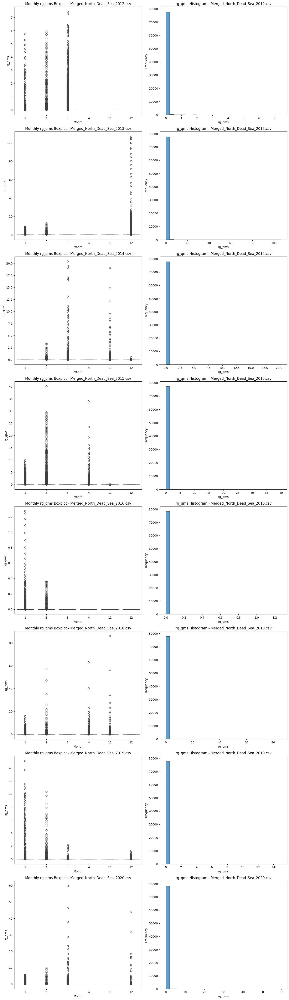

In [14]:
# Uncomment the following line if running in a Jupyter Notebook:
# %matplotlib inline

import os
import glob
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# New directory containing your CSV files in the "nov2apr" folder
data_dir = "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr"

# Retrieve and sort a list of CSV files in the directory
csv_files = sorted(glob.glob(os.path.join(data_dir, "*.csv")))

if not csv_files:
    print("No CSV files found in the directory.")
else:
    n_files = len(csv_files)
    # Create a figure with 2 subplots per file (each file gets one row with 2 columns)
    fig, axes = plt.subplots(n_files, 2, figsize=(14, 6 * n_files))
    
    # Ensure axes is 2D (if only one file is found)
    if n_files == 1:
        axes = [axes]
    
    # Loop over each CSV file and create the plots
    for idx, file in enumerate(csv_files):
        print("=" * 80)
        print(f"Processing file: {os.path.basename(file)}")
        
        # Read the CSV file into a DataFrame and convert 'time' to datetime
        df = pd.read_csv(file)
        df['time'] = pd.to_datetime(df['time'], errors='coerce')
        
        # Drop rows without valid rg_qms values
        df_valid = df.dropna(subset=['rg_qms'])
        
        # Create a column 'month' by extracting the month from the 'time' column
        df_valid['month'] = df_valid['time'].dt.month
        
        # Overall descriptive statistics (printed to console)
        overall_stats = df_valid['rg_qms'].describe()
        print("\nOverall rg_qms distribution:")
        print(overall_stats)
        
        # Monthly descriptive statistics (printed to console)
        monthly_stats = df_valid.groupby('month')['rg_qms'].describe()
        print("\nMonthly rg_qms distribution:")
        print(monthly_stats)
        
        # Plot 1: Boxplot of rg_qms by month
        ax_box = axes[idx][0] if n_files > 1 else axes[0]
        sns.boxplot(x='month', y='rg_qms', data=df_valid, ax=ax_box)
        ax_box.set_title(f"Monthly rg_qms Boxplot - {os.path.basename(file)}")
        ax_box.set_xlabel("Month")
        ax_box.set_ylabel("rg_qms")
        
        # Plot 2: Histogram of overall rg_qms distribution
        ax_hist = axes[idx][1] if n_files > 1 else axes[1]
        ax_hist.hist(df_valid['rg_qms'], bins=30, edgecolor='k', alpha=0.7)
        ax_hist.set_title(f"rg_qms Histogram - {os.path.basename(file)}")
        ax_hist.set_xlabel("rg_qms")
        ax_hist.set_ylabel("Frequency")
    
    plt.tight_layout()
    plt.show()


File: Merged_North_Dead_Sea_2012.csv
Values exactly 0: 77085
Values above 0:  1539


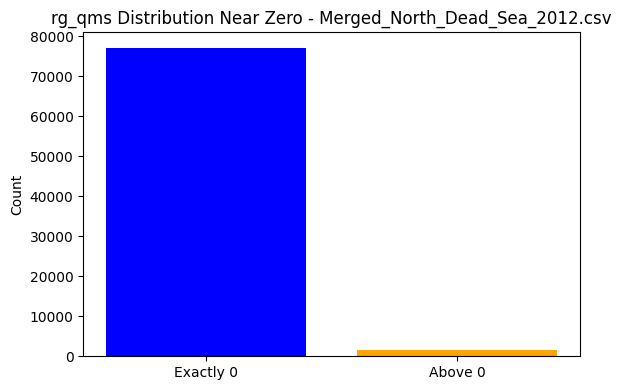

File: Merged_North_Dead_Sea_2013.csv
Values exactly 0: 74521
Values above 0:  3671


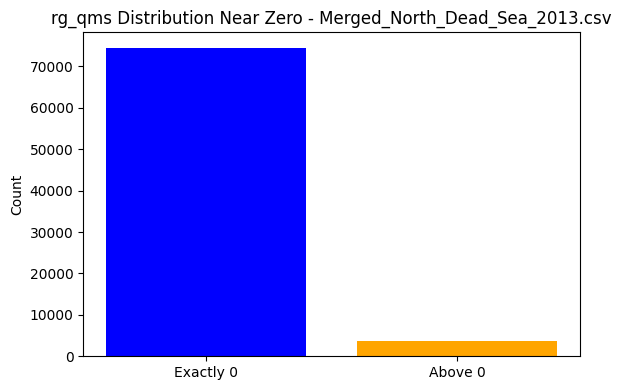

File: Merged_North_Dead_Sea_2014.csv
Values exactly 0: 76190
Values above 0:  2002


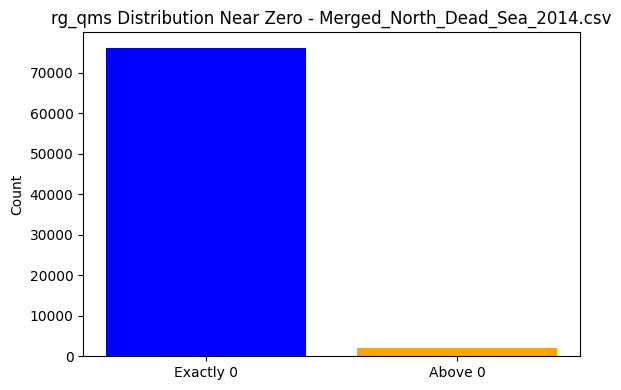

File: Merged_North_Dead_Sea_2015.csv
Values exactly 0: 75364
Values above 0:  2828


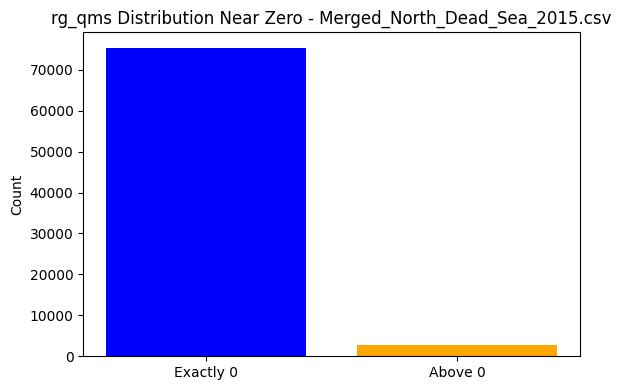

File: Merged_North_Dead_Sea_2016.csv
Values exactly 0: 78070
Values above 0:  554


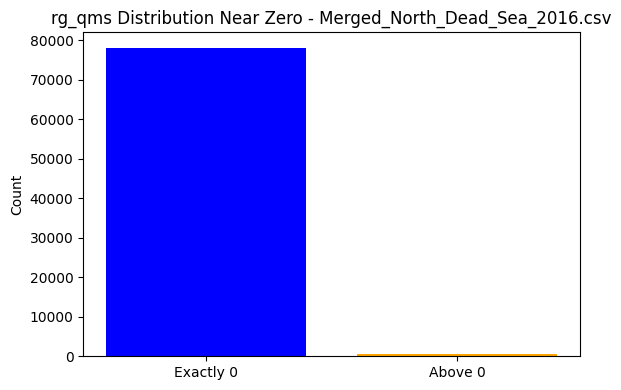

File: Merged_North_Dead_Sea_2018.csv
Values exactly 0: 75712
Values above 0:  2480


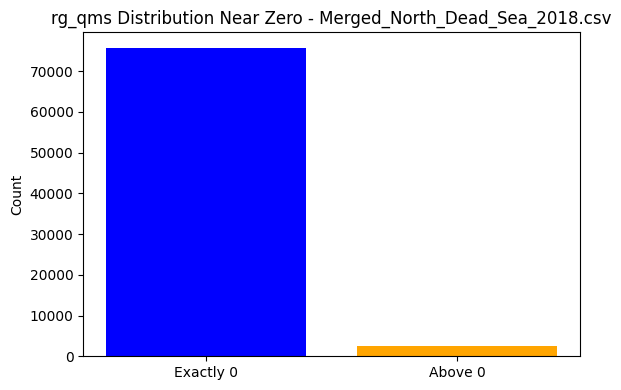

File: Merged_North_Dead_Sea_2019.csv
Values exactly 0: 76941
Values above 0:  1251


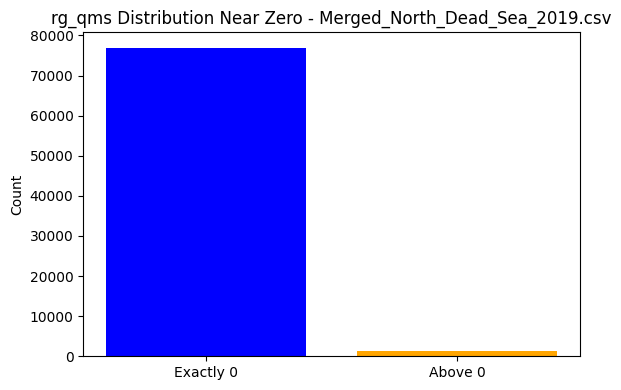

File: Merged_North_Dead_Sea_2020.csv
Values exactly 0: 76816
Values above 0:  1808


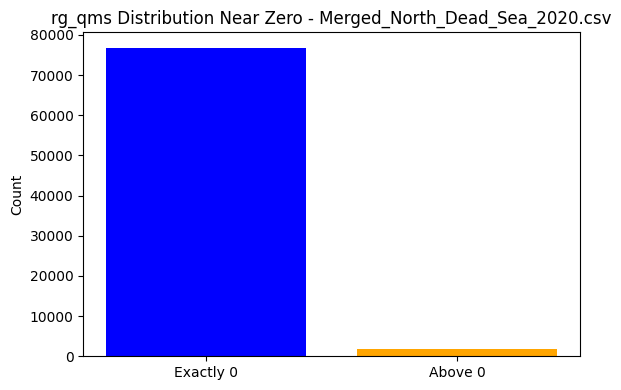

In [15]:
# Uncomment if running in a Jupyter Notebook:
# %matplotlib inline

import os
import glob
import pandas as pd
import matplotlib.pyplot as plt

# Path to your CSV files in the "nov2apr" folder
data_dir = "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr"

# Retrieve and sort CSV files in the directory
csv_files = sorted(glob.glob(os.path.join(data_dir, "*.csv")))

if not csv_files:
    print("No CSV files found in the directory.")
else:
    for file in csv_files:
        # Read the CSV file and convert 'time' to datetime
        df = pd.read_csv(file)
        df['time'] = pd.to_datetime(df['time'], errors='coerce')
        
        # Drop rows with missing rg_qms values (focusing on the valid ones)
        df_valid = df.dropna(subset=['rg_qms'])
        
        # Count the number of values exactly equal to 0 and those greater than 0
        count_zero = (df_valid['rg_qms'] == 0).sum()
        count_above = (df_valid['rg_qms'] > 0).sum()
        
        print("="*80)
        print(f"File: {os.path.basename(file)}")
        print(f"Values exactly 0: {count_zero}")
        print(f"Values above 0:  {count_above}")
        
        # Plot a bar chart for the counts
        plt.figure(figsize=(6, 4))
        plt.bar(['Exactly 0', 'Above 0'], [count_zero, count_above], color=['blue', 'orange'])
        plt.title(f"rg_qms Distribution Near Zero - {os.path.basename(file)}")
        plt.ylabel("Count")
        plt.tight_layout()
        plt.show()


In [16]:
import os
import glob
import pandas as pd

# Define the folder path where your CSV files are stored
folder_path = "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/"

# Build the pattern to match files, e.g., Merged_North_Dead_Sea_2012.csv, 2013, etc.
pattern = os.path.join(folder_path, "Merged_North_Dead_Sea_*.csv")

# Retrieve a list of all matching CSV files
csv_files = glob.glob(pattern)

# Loop through each file and print its head
for file in sorted(csv_files):
    print(f"Head of file: {file}")
    df = pd.read_csv(file)
    print(df.head())
    print("=" * 50)


Head of file: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/Merged_North_Dead_Sea_2012.csv
                  time  latitude  longitude  rainrate  elevation  \
0  2012-01-01 00:00:00   31.7542    35.3533       0.0  179.91008   
1  2012-01-01 00:00:00   31.7542    35.3639       0.0  182.38225   
2  2012-01-01 00:00:00   31.7542    35.3744       0.0   94.52771   
3  2012-01-01 00:00:00   31.7541    35.3850       0.0  -57.00375   
4  2012-01-01 00:00:00   31.7541    35.3956       0.0   60.18594   

   slope_calculated  rg_qms  
0               NaN     NaN  
1          2.973726     NaN  
2               NaN     NaN  
3               NaN     NaN  
4               NaN     NaN  
Head of file: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/Merged_North_Dead_Sea_2013.csv
                  time  latitude  longitude  rainrate  el

Created folder: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs

Processing file: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/Merged_North_Dead_Sea_2012.csv
Original df shape: (27675648, 7)
Filtered event-based df shape: (1108800, 8)
Saved filtered df to: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2012_events.csv


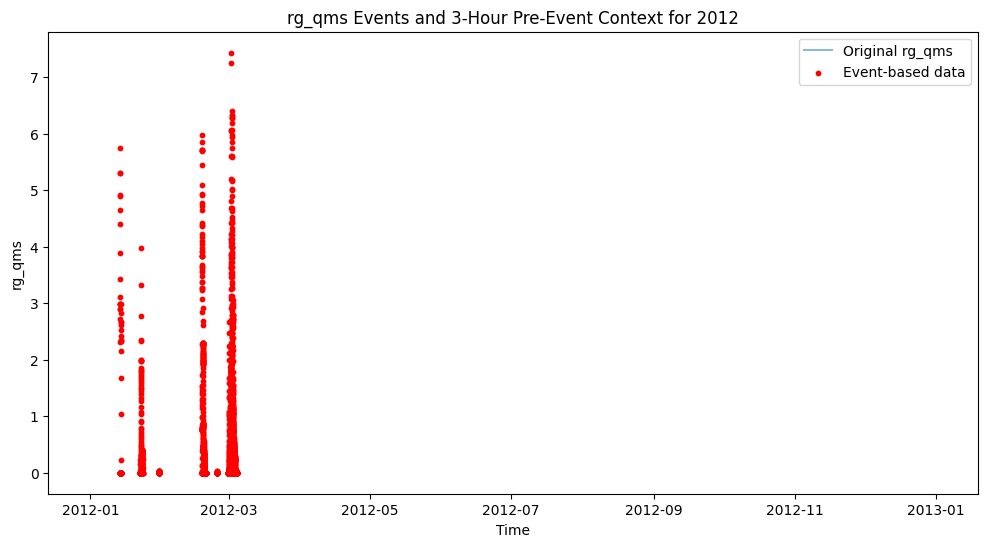


Processing file: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/Merged_North_Dead_Sea_2013.csv
Original df shape: (27523584, 7)
Filtered event-based df shape: (1785696, 8)
Saved filtered df to: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2013_events.csv


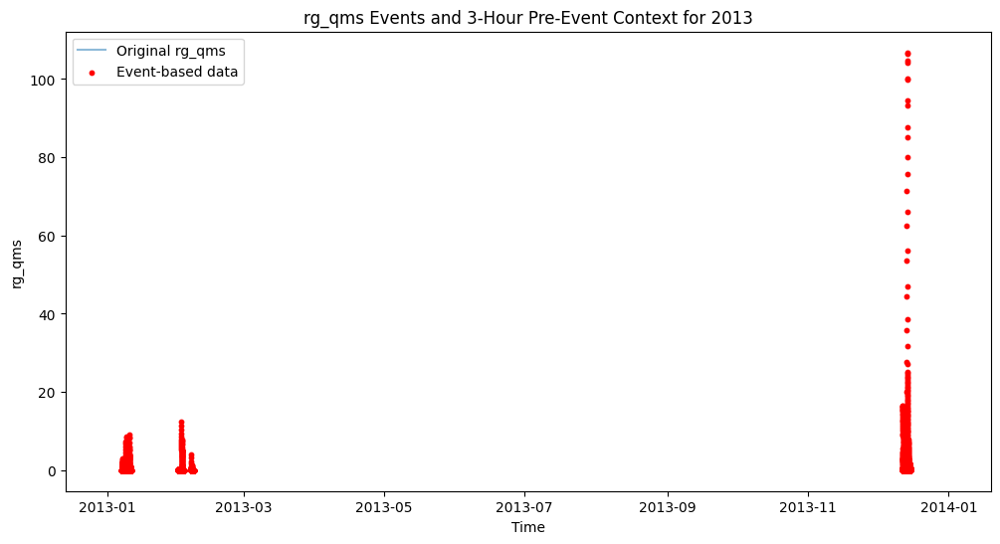


Processing file: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/Merged_North_Dead_Sea_2014.csv
Original df shape: (27523584, 7)
Filtered event-based df shape: (1673760, 8)
Saved filtered df to: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2014_events.csv


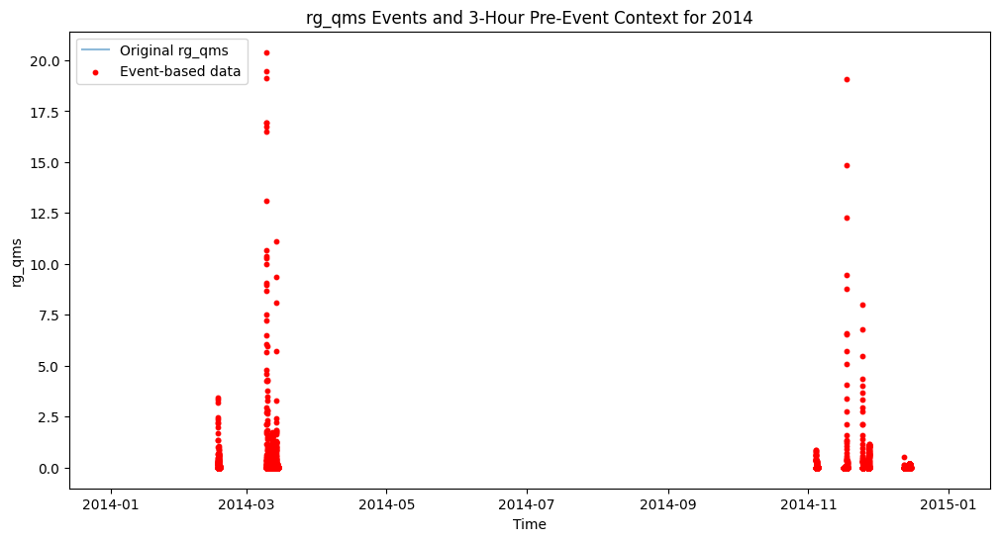


Processing file: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/Merged_North_Dead_Sea_2015.csv
Original df shape: (27523584, 7)
Filtered event-based df shape: (1709664, 8)
Saved filtered df to: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2015_events.csv


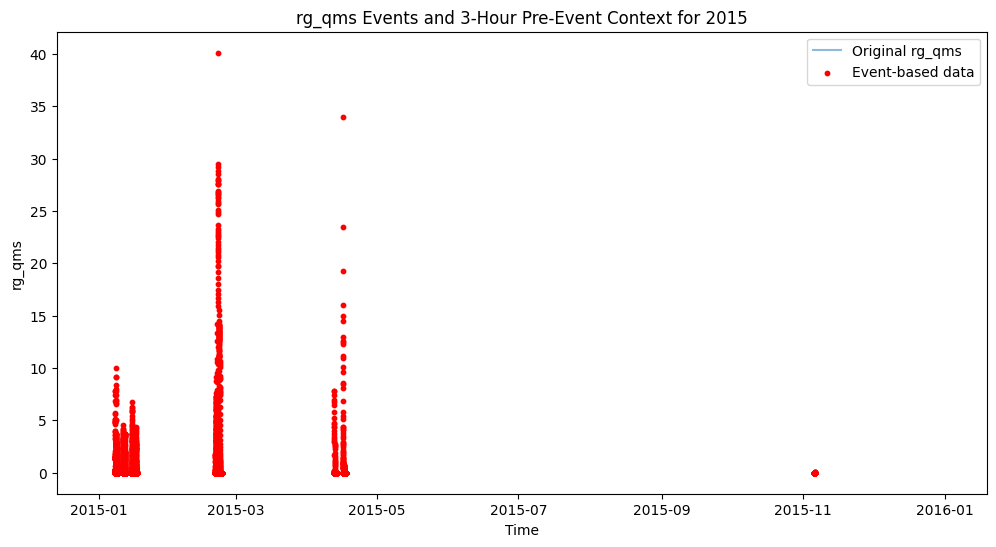


Processing file: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/Merged_North_Dead_Sea_2016.csv
Original df shape: (27675648, 7)
Filtered event-based df shape: (598752, 8)
Saved filtered df to: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2016_events.csv


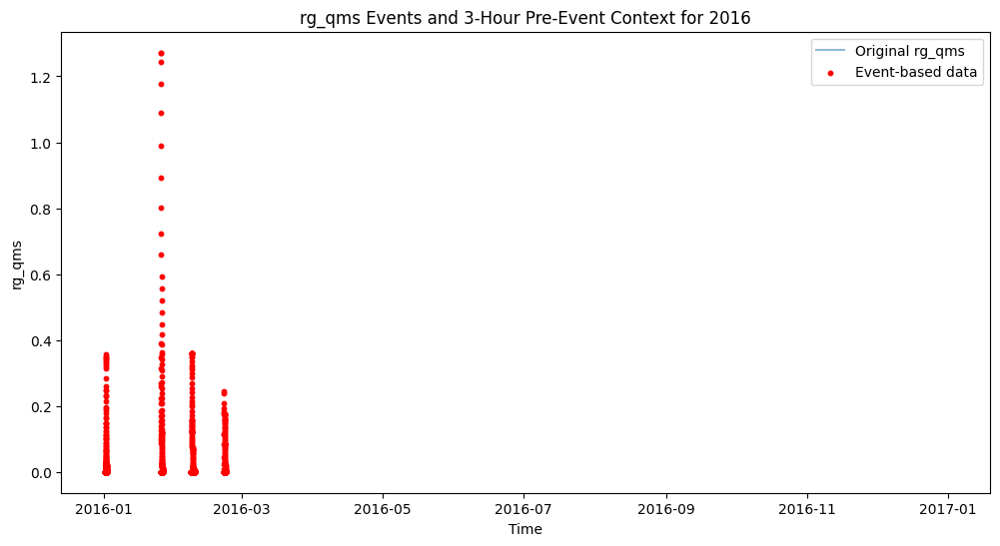


Processing file: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/Merged_North_Dead_Sea_2018.csv
Original df shape: (27523584, 7)
Filtered event-based df shape: (1680096, 8)
Saved filtered df to: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2018_events.csv


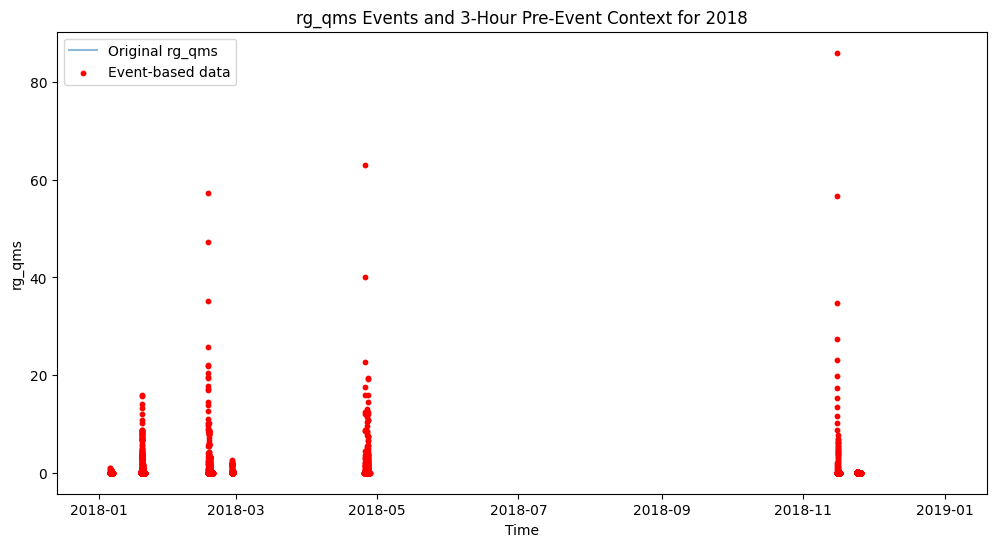


Processing file: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/Merged_North_Dead_Sea_2019.csv
Original df shape: (27523584, 7)
Filtered event-based df shape: (1086624, 8)
Saved filtered df to: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2019_events.csv


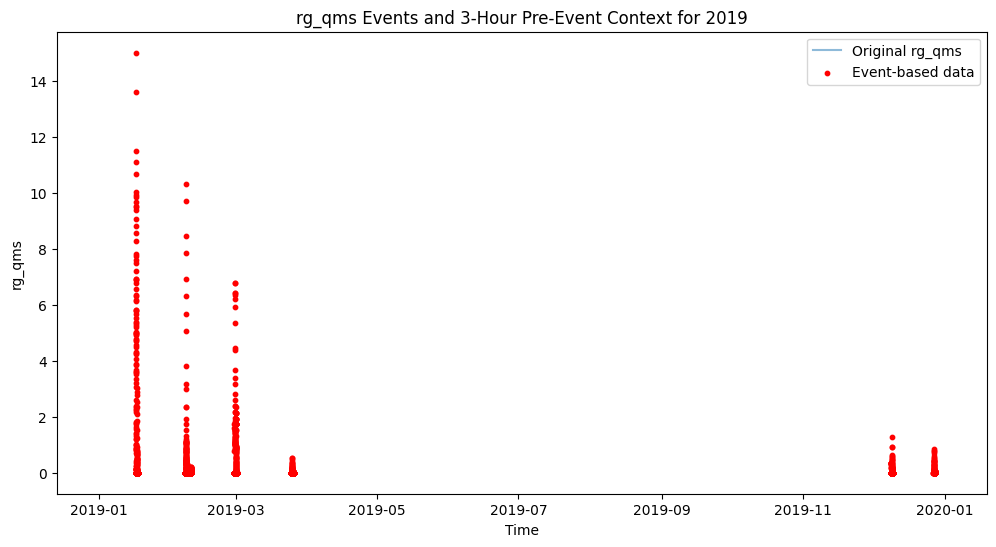


Processing file: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/Merged_North_Dead_Sea_2020.csv
Original df shape: (27675648, 7)
Filtered event-based df shape: (1726560, 8)
Saved filtered df to: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2020_events.csv


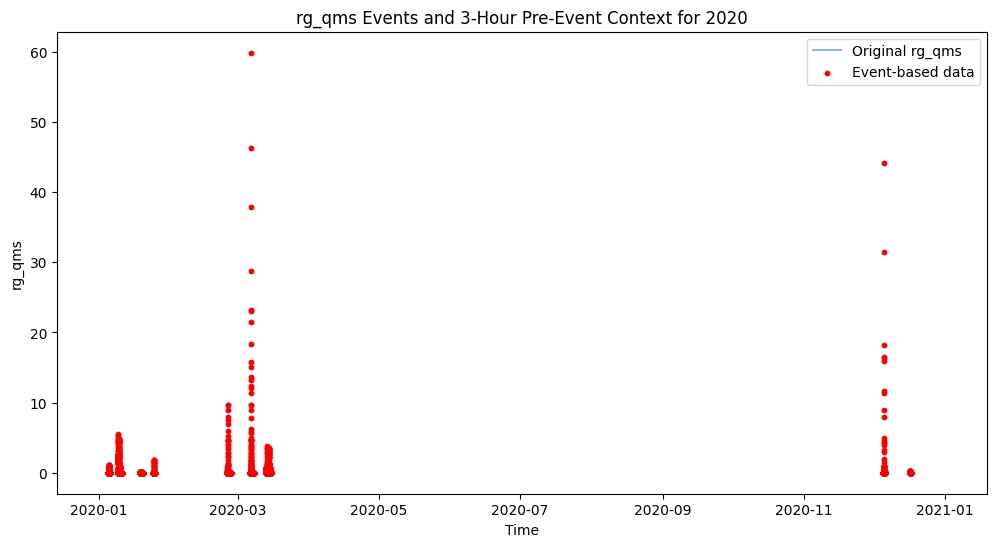

In [17]:
import os
import glob
import pandas as pd
import matplotlib.pyplot as plt

# Define the folder path where your CSV files are stored
folder_path = "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/"
# Create the output folder for event-based data
event_folder = os.path.join(folder_path, "event_base_dfs")
if not os.path.exists(event_folder):
    os.makedirs(event_folder)
    print(f"Created folder: {event_folder}")
else:
    print(f"Folder already exists: {event_folder}")

# Build the pattern to match yearly CSV files
pattern = os.path.join(folder_path, "Merged_North_Dead_Sea_*.csv")
csv_files = sorted(glob.glob(pattern))

for file in csv_files:
    print(f"\nProcessing file: {file}")
    
    # Read CSV and parse the first column as datetime.
    # (Assuming the first column in your CSV is the timestamp.)
    df = pd.read_csv(file, parse_dates=[0])
    print("Original df shape:", df.shape)
    
    # Assume the first column is the datetime column. If needed, rename it.
    datetime_col = df.columns[0]
    df['datetime'] = pd.to_datetime(df[datetime_col])
    
    # Identify rows where rg_qms > 0 (these mark our events)
    event_rows = df[df['rg_qms'] > 0]
    
    # Set to hold indices of rows to include (both event rows and 3 hours before them)
    selected_indices = set()
    
    for idx, row in event_rows.iterrows():
        event_time = row['datetime']
        start_time = event_time - pd.Timedelta(hours=3)
        # Select all rows in the interval [start_time, event_time]
        indices = df[(df['datetime'] >= start_time) & (df['datetime'] <= event_time)].index
        selected_indices.update(indices)
    
    # Create the filtered dataframe using the union of all selected rows
    df_event = df.loc[sorted(selected_indices)]
    print("Filtered event-based df shape:", df_event.shape)
    
    # Save the new dataframe. Extract the year from the filename.
    base_name = os.path.basename(file)
    # This assumes the filename ends with "YYYY.csv". Adjust the split logic if needed.
    year = base_name.split('_')[-1].split('.')[0]
    output_file = os.path.join(event_folder, f"Merged_North_Dead_Sea_{year}_events.csv")
    df_event.to_csv(output_file, index=False)
    print(f"Saved filtered df to: {output_file}")
    
    # Visualization: Plot the full rg_qms time series and overlay the event-based data
    plt.figure(figsize=(12, 6))
    plt.plot(df['datetime'], df['rg_qms'], label='Original rg_qms', alpha=0.5)
    plt.scatter(df_event['datetime'], df_event['rg_qms'], color='red', label='Event-based data', s=10)
    plt.xlabel('Time')
    plt.ylabel('rg_qms')
    plt.title(f"rg_qms Events and 3-Hour Pre-Event Context for {year}")
    plt.legend()
    plt.show()


In [19]:
import os
import glob
import pandas as pd

# Define the folder path where your CSV files are stored
folder_path = "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/"

# Build the pattern to match your CSV files (e.g., Merged_North_Dead_Sea_2012.csv, etc.)
pattern = os.path.join(folder_path, "Merged_North_Dead_Sea_*.csv")
csv_files = sorted(glob.glob(pattern))

# Loop over each file
for file in csv_files:
    print(f"\nProcessing file: {file}")
    
    # Read CSV, parse the first column as datetime
    df = pd.read_csv(file, parse_dates=[0])
    
    # Display the first few rows of the file
    print("Head of the file:")
    print(df.head())
    
    # Print the shape of the dataframe
    print("Dataframe shape:", df.shape)
    
    # Assume the first column is the datetime column; count unique timestamps
    datetime_col = df.columns[0]
    unique_timestamps = df[datetime_col].nunique()
    print("Number of unique timestamps:", unique_timestamps)



Processing file: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/Merged_North_Dead_Sea_2012.csv
Head of the file:
        time  latitude  longitude  rainrate  elevation  slope_calculated  \
0 2012-01-01   31.7542    35.3533       0.0  179.91008               NaN   
1 2012-01-01   31.7542    35.3639       0.0  182.38225          2.973726   
2 2012-01-01   31.7542    35.3744       0.0   94.52771               NaN   
3 2012-01-01   31.7541    35.3850       0.0  -57.00375               NaN   
4 2012-01-01   31.7541    35.3956       0.0   60.18594               NaN   

   rg_qms  
0     NaN  
1     NaN  
2     NaN  
3     NaN  
4     NaN  
Dataframe shape: (27675648, 7)
Number of unique timestamps: 26208

Processing file: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/Merged_North_Dead_Sea_2013.csv
Head of the file:
       

In [21]:
import os
import glob
import pandas as pd

# Define the folder path where the event-based CSV files are stored
folder_path = "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/"
event_folder = os.path.join(folder_path, "event_base_dfs")

# Build the pattern to match event-based CSV files, e.g., Merged_North_Dead_Sea_2012_events.csv, etc.
pattern = os.path.join(event_folder, "Merged_North_Dead_Sea_*_events.csv")
event_files = sorted(glob.glob(pattern))

# Loop over each event-based file
for file in event_files:
    print(f"\nProcessing file: {file}")
    
    # Read CSV, parsing the 'datetime' column as datetime
    df = pd.read_csv(file, parse_dates=['datetime'])
    
    # Display the first few rows of the file
    print("Head of the file:")
    print(df.head())
    
    # Print the shape of the dataframe
    print("Dataframe shape:", df.shape)
    
    # Count the unique timestamps in the 'datetime' column
    unique_timestamps = df['datetime'].nunique()
    print("Number of unique timestamps:", unique_timestamps)



Processing file: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2012_events.csv
Head of the file:
                  time  latitude  longitude  rainrate  elevation  \
0  2012-01-13 18:40:00   31.7542    35.3533       0.0  179.91008   
1  2012-01-13 18:40:00   31.7542    35.3639       0.0  182.38225   
2  2012-01-13 18:40:00   31.7542    35.3744       0.0   94.52771   
3  2012-01-13 18:40:00   31.7541    35.3850       0.0  -57.00375   
4  2012-01-13 18:40:00   31.7541    35.3956       0.0   60.18594   

   slope_calculated  rg_qms            datetime  
0               NaN     NaN 2012-01-13 18:40:00  
1          2.973726     NaN 2012-01-13 18:40:00  
2               NaN     NaN 2012-01-13 18:40:00  
3               NaN     NaN 2012-01-13 18:40:00  
4               NaN     NaN 2012-01-13 18:40:00  
Dataframe shape: (1108800, 8)
Number of unique timestamps: 1050

Proce

In [22]:
1050*1056

1108800

In [25]:
import os
import glob
import pandas as pd

# Define the folder path where your event-based CSV files are stored
folder_path = "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/"
event_folder = os.path.join(folder_path, "event_base_dfs")

# Build the pattern to match event-based CSV files (e.g., Merged_North_Dead_Sea_2012_events.csv, etc.)
pattern = os.path.join(event_folder, "Merged_North_Dead_Sea_*_events.csv")
event_files = sorted(glob.glob(pattern))

# Loop over each event-based file and diagnose the rg_qms column
for file in event_files:
    print(f"\nProcessing file: {file}")
    try:
        # Read the CSV file, parsing the 'datetime' column as datetime
        df = pd.read_csv(file, parse_dates=['datetime'])
    except Exception as e:
        print(f"Error reading file {file}: {e}")
        continue

    # Check if 'rg_qms' column exists
    if 'rg_qms' not in df.columns:
        print("Column 'rg_qms' not found in this dataframe.")
        continue

    # Print overall information about the dataframe
    total_rows = df.shape[0]
    print("Total rows in file:", total_rows)
    
    # Print count of non-null values in rg_qms
    non_null_count = df['rg_qms'].count()
    print("Non-null 'rg_qms' count:", non_null_count)
    
    # Print summary statistics for the rg_qms column
    print("Summary statistics for 'rg_qms':")
    print(df['rg_qms'].describe())
    
    # Print the first few unique values in rg_qms
    unique_values = df['rg_qms'].unique()
    print("First 10 unique values in 'rg_qms':", unique_values[:10])
    
    # Also print the head of the rg_qms column to inspect the values
    print("Head of 'rg_qms' column:")
    print(df['rg_qms'].head())



Processing file: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2012_events.csv
Total rows in file: 1108800
Non-null 'rg_qms' count: 3150
Summary statistics for 'rg_qms':
count    3150.000000
mean        0.462231
std         1.033129
min         0.000000
25%         0.000000
50%         0.000000
75%         0.359800
max         7.430000
Name: rg_qms, dtype: float64
First 10 unique values in 'rg_qms': [   nan 0.     2.32   4.64   4.9186 5.74   5.3    4.9008 4.4065 3.8901]
Head of 'rg_qms' column:
0   NaN
1   NaN
2   NaN
3   NaN
4   NaN
Name: rg_qms, dtype: float64

Processing file: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2013_events.csv
Total rows in file: 1785696
Non-null 'rg_qms' count: 5073
Summary statistics for 'rg_qms':
count    5073


Processing file: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2012_events.csv


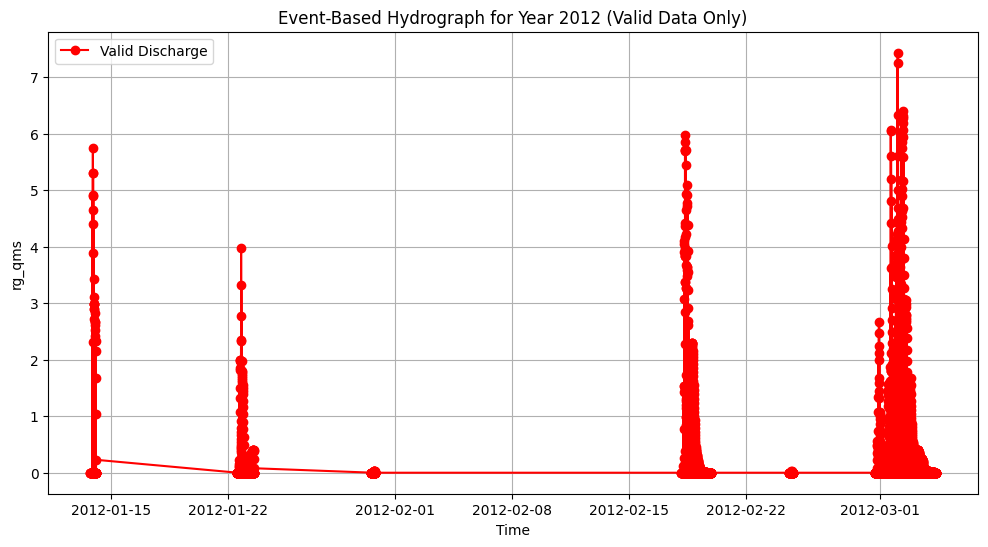


Processing file: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2013_events.csv


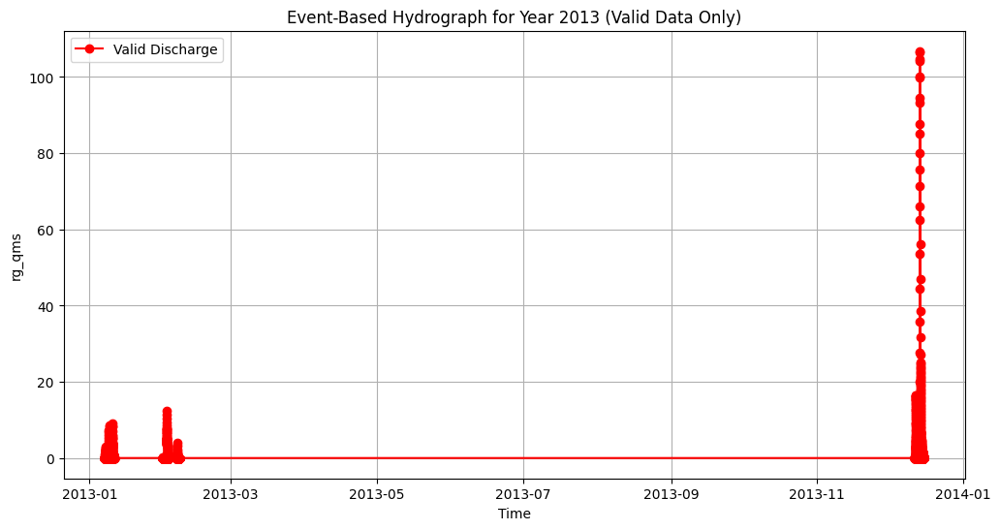


Processing file: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2014_events.csv


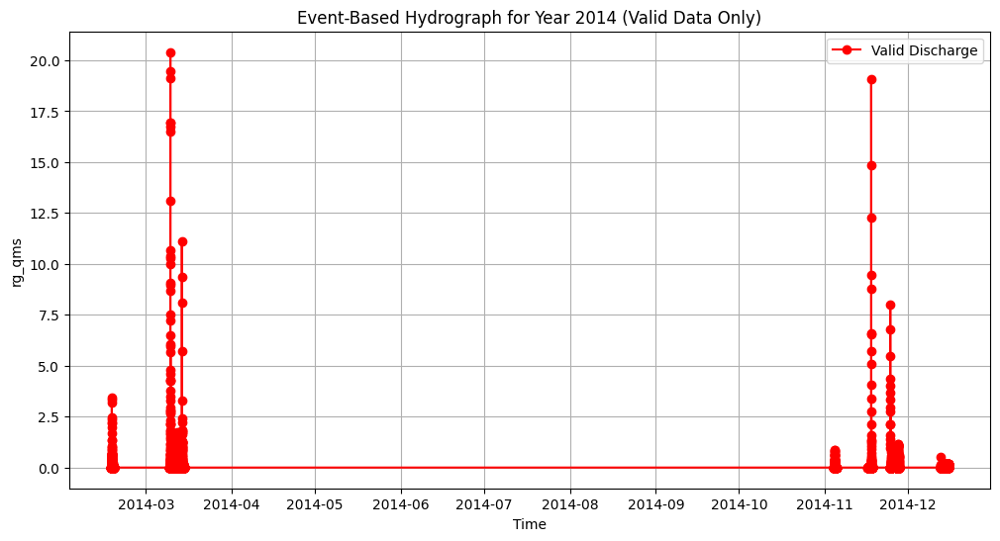


Processing file: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2015_events.csv


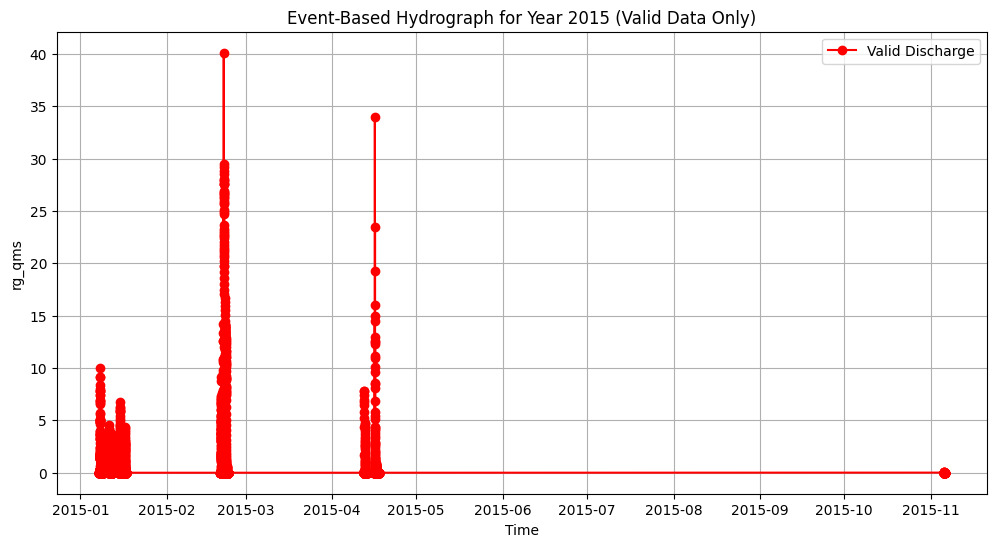


Processing file: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2016_events.csv


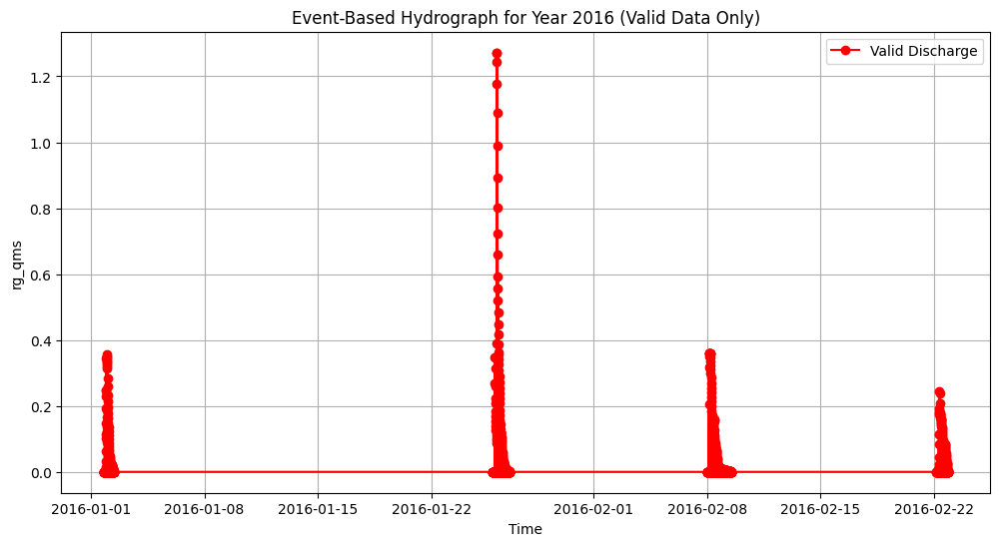


Processing file: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2018_events.csv


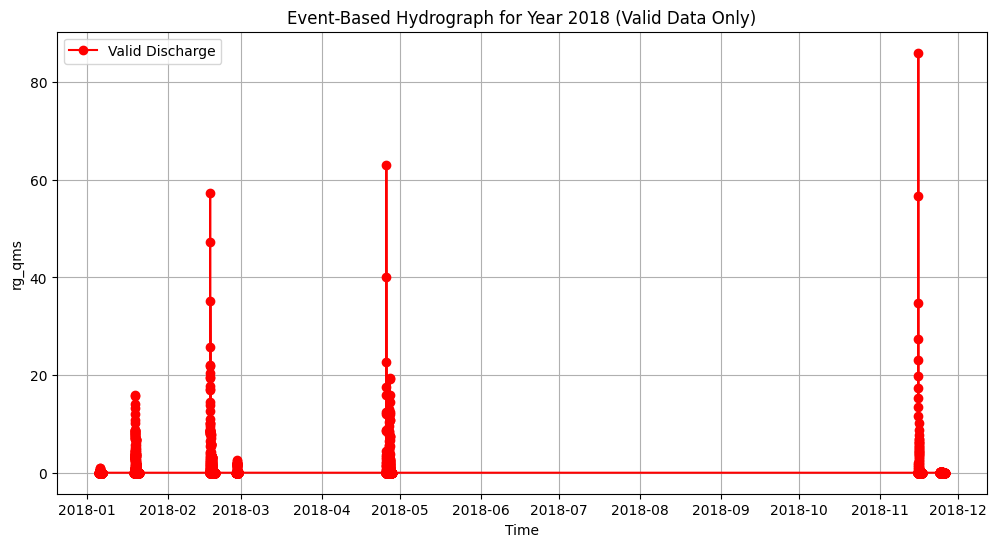


Processing file: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2019_events.csv


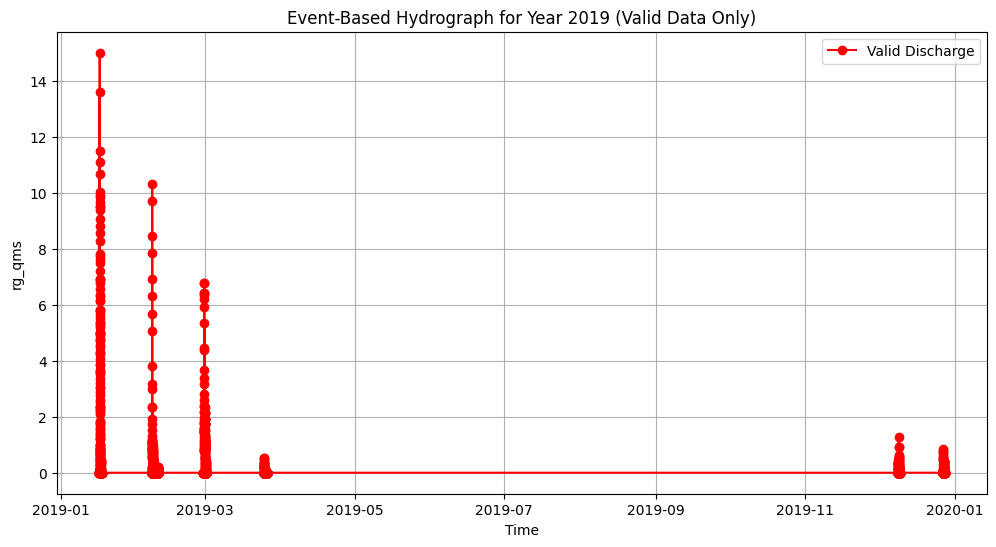


Processing file: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2020_events.csv


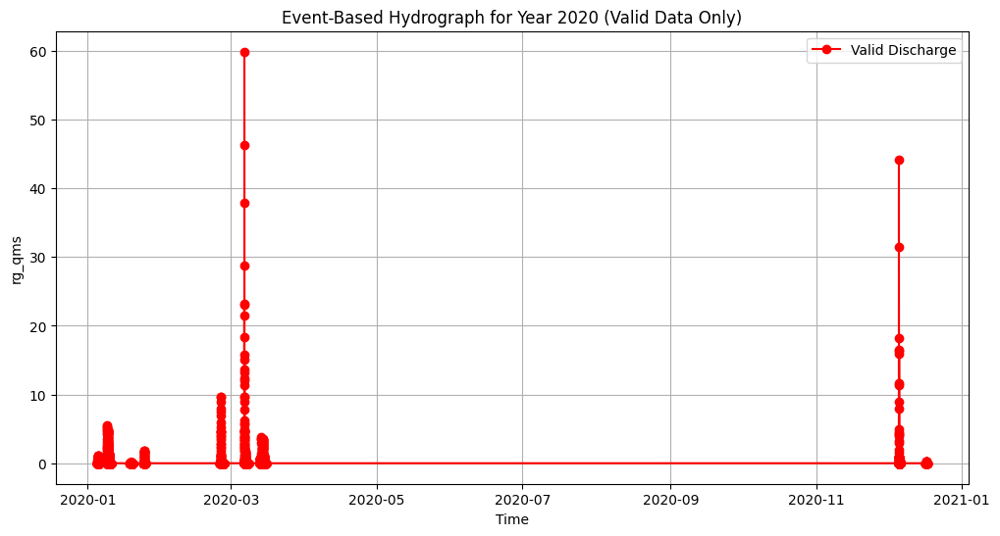

In [26]:
import os
import glob
import pandas as pd
import matplotlib.pyplot as plt

# Define the folder path where your event-based CSV files are stored
folder_path = "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/"
event_folder = os.path.join(folder_path, "event_base_dfs")

# Build the pattern to match event-based CSV files
pattern = os.path.join(event_folder, "Merged_North_Dead_Sea_*_events.csv")
event_files = sorted(glob.glob(pattern))

# Loop over each event-based file
for file in event_files:
    print(f"\nProcessing file: {file}")
    
    # Read the event-based CSV file, parsing 'datetime' as datetime
    df = pd.read_csv(file, parse_dates=['datetime'])
    
    # Filter the dataframe to only include rows with valid rg_qms values
    df_valid = df[df['rg_qms'].notnull()]
    
    # Extract the year from the file name.
    base_name = os.path.basename(file)
    parts = base_name.split('_')
    year = parts[4] if len(parts) >= 5 else "Unknown"
    
    # Plot only the valid discharge data
    plt.figure(figsize=(12, 6))
    plt.plot(df_valid['datetime'], df_valid['rg_qms'], 'o-', color='red', label='Valid Discharge')
    plt.xlabel('Time')
    plt.ylabel('rg_qms')
    plt.title(f"Event-Based Hydrograph for Year {year} (Valid Data Only)")
    plt.grid(True)
    plt.legend()
    plt.show()



Processing file: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2012_events.csv


/tmp/ipykernel_6313/2551274236.py:37: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap('tab10', len(stations))


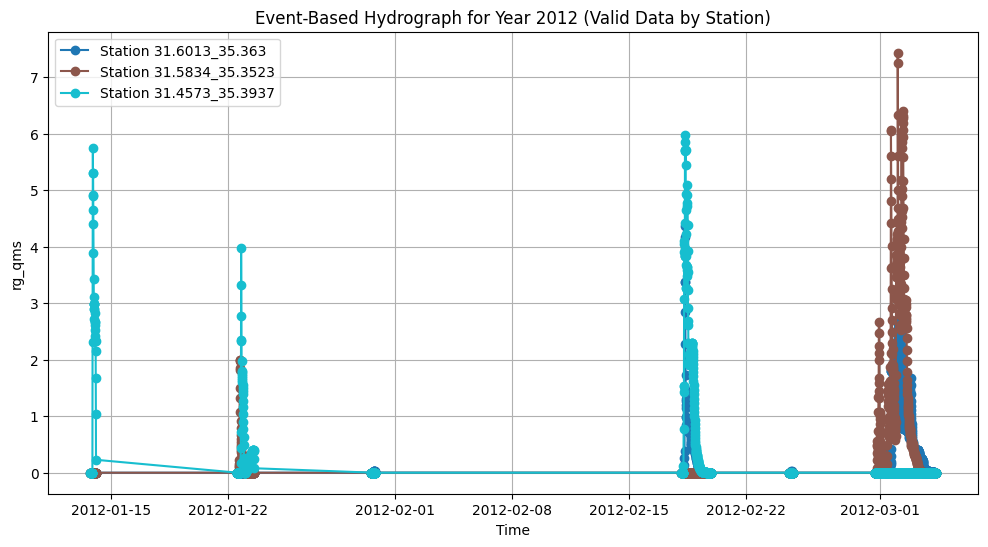


Processing file: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2013_events.csv


/tmp/ipykernel_6313/2551274236.py:37: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap('tab10', len(stations))


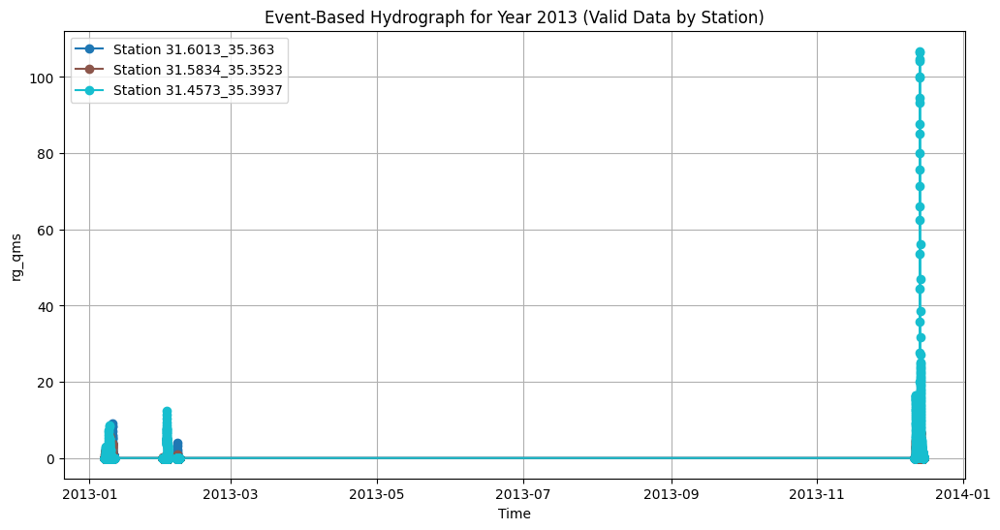


Processing file: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2014_events.csv


/tmp/ipykernel_6313/2551274236.py:37: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap('tab10', len(stations))


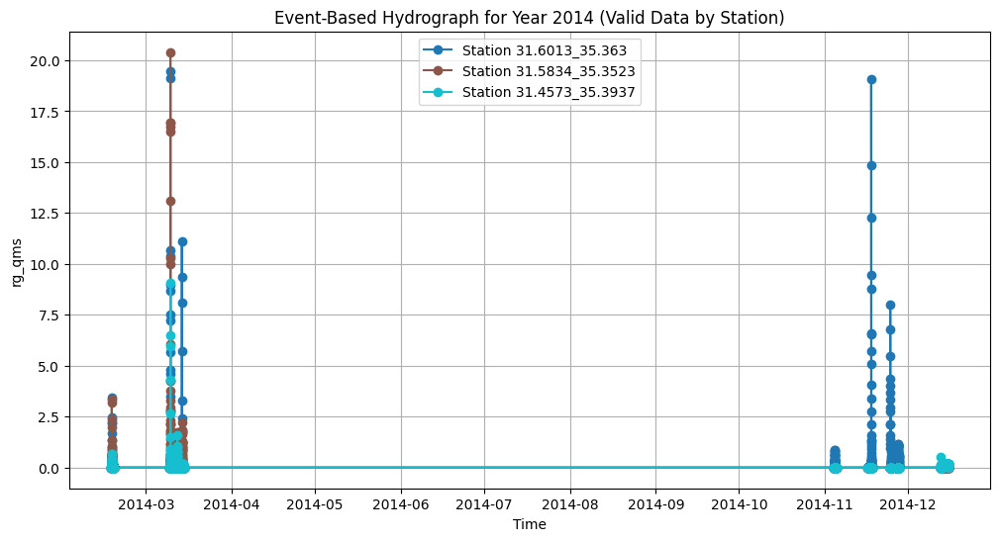


Processing file: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2015_events.csv


/tmp/ipykernel_6313/2551274236.py:37: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap('tab10', len(stations))


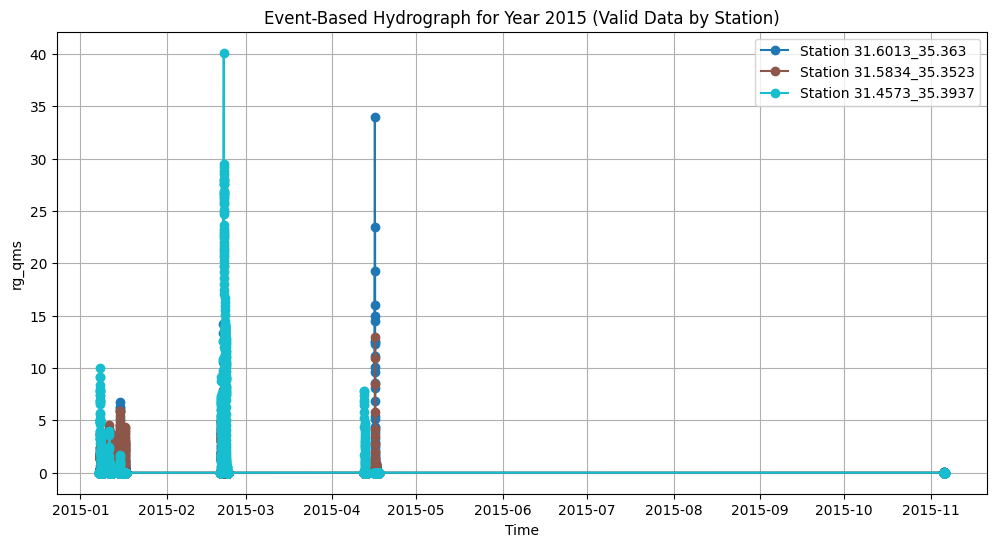


Processing file: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2016_events.csv


/tmp/ipykernel_6313/2551274236.py:37: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap('tab10', len(stations))


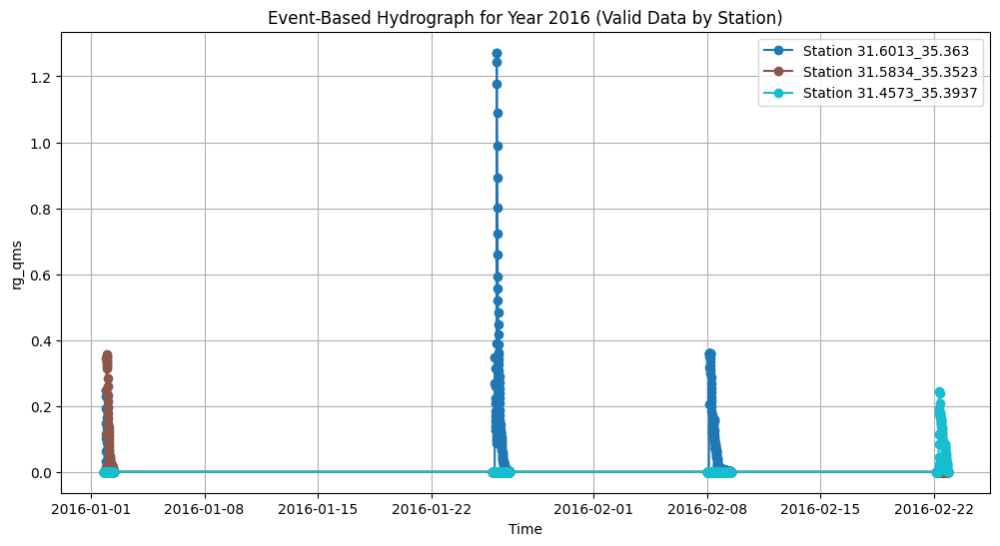


Processing file: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2018_events.csv


/tmp/ipykernel_6313/2551274236.py:37: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap('tab10', len(stations))


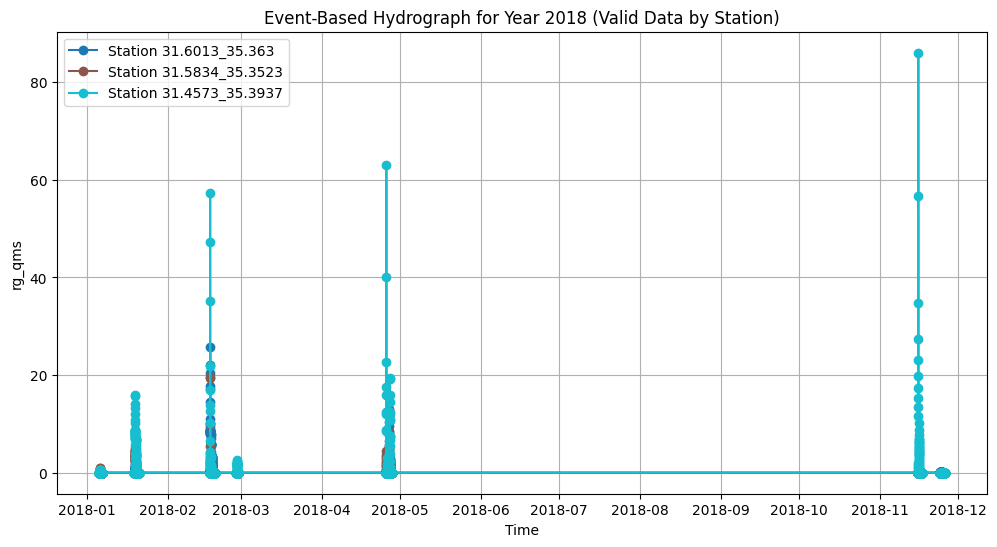


Processing file: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2019_events.csv


/tmp/ipykernel_6313/2551274236.py:37: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap('tab10', len(stations))


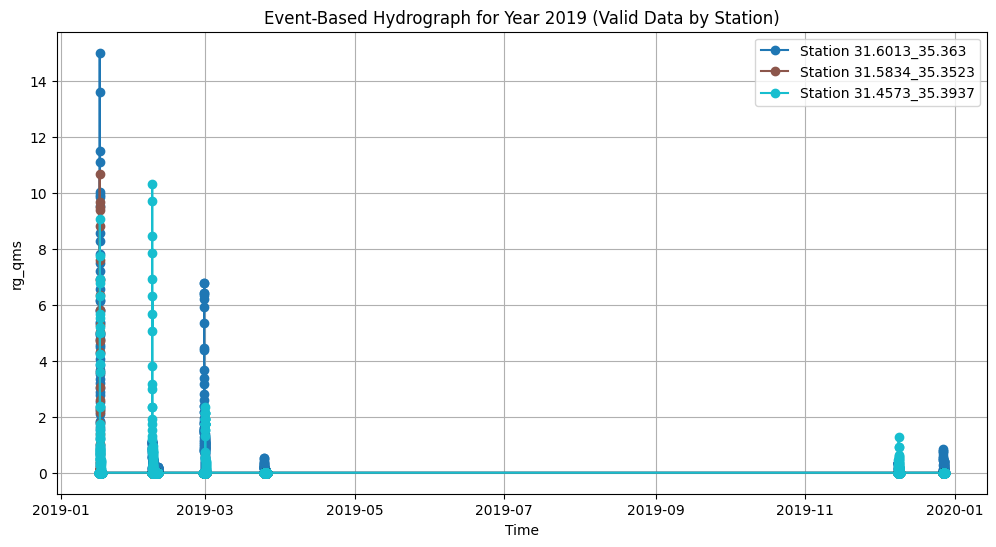


Processing file: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2020_events.csv


/tmp/ipykernel_6313/2551274236.py:37: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap('tab10', len(stations))


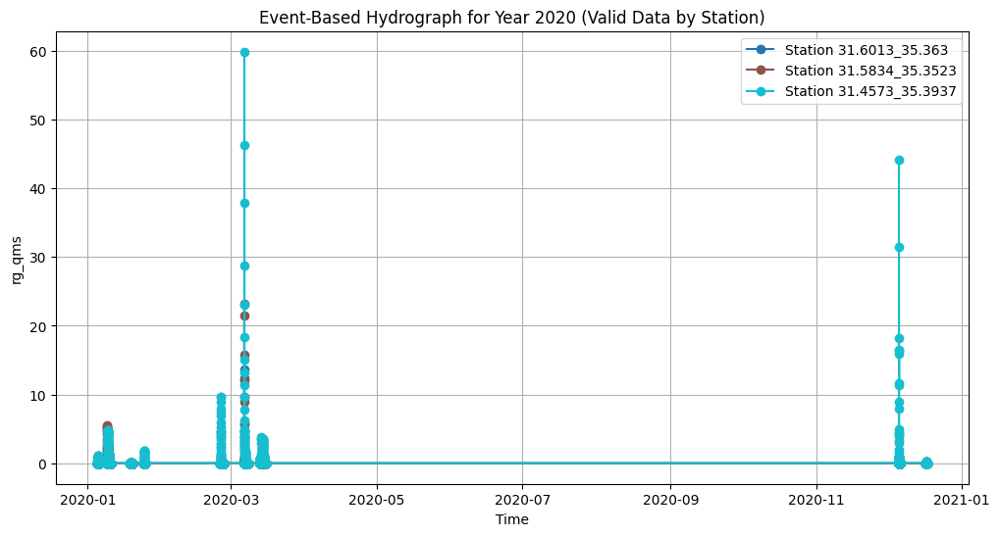

In [27]:
import os
import glob
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.cm as cm

# Define the folder path where your event-based CSV files are stored
folder_path = "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/"
event_folder = os.path.join(folder_path, "event_base_dfs")

# Build the pattern to match event-based CSV files
pattern = os.path.join(event_folder, "Merged_North_Dead_Sea_*_events.csv")
event_files = sorted(glob.glob(pattern))

# Loop over each event-based file
for file in event_files:
    print(f"\nProcessing file: {file}")
    
    # Read the event-based CSV file with the 'datetime' column parsed as datetime
    df = pd.read_csv(file, parse_dates=['datetime'])
    
    # Create a station identifier using latitude and longitude (assumed to be columns 1 and 2)
    df['station'] = df.iloc[:, 1].astype(str) + "_" + df.iloc[:, 2].astype(str)
    
    # Filter the data to only include rows with valid rg_qms values
    df_valid = df[df['rg_qms'].notnull()]
    
    # Extract the year from the filename. Assumes a filename like "Merged_North_Dead_Sea_2012_events.csv"
    base_name = os.path.basename(file)
    parts = base_name.split('_')
    year = parts[4] if len(parts) >= 5 else "Unknown"
    
    # Get unique station names from the valid data
    stations = df_valid['station'].unique()
    
    # Create a color map to assign different colors to each station
    cmap = cm.get_cmap('tab10', len(stations))
    
    # Create the plot
    plt.figure(figsize=(12, 6))
    for idx, station in enumerate(stations):
        station_data = df_valid[df_valid['station'] == station]
        plt.plot(station_data['datetime'], station_data['rg_qms'], 
                 marker='o', linestyle='-', color=cmap(idx), label=f"Station {station}")
    
    plt.xlabel("Time")
    plt.ylabel("rg_qms")
    plt.title(f"Event-Based Hydrograph for Year {year} (Valid Data by Station)")
    plt.legend()
    plt.grid(True)
    plt.show()



Processing file: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2012_events.csv
Total valid rg_qms rows: 3150
Number of zero values: 1611
Percentage of zeros: 51.14%


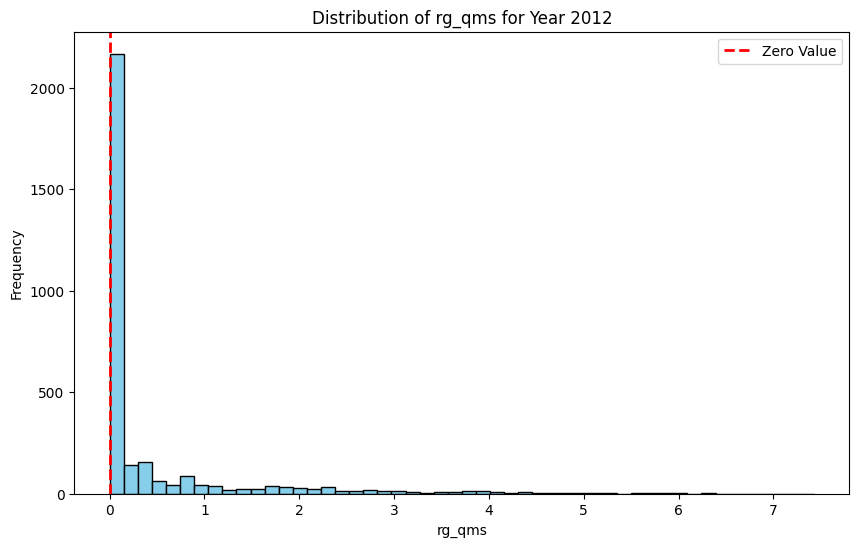


Processing file: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2013_events.csv
Total valid rg_qms rows: 5073
Number of zero values: 1402
Percentage of zeros: 27.64%


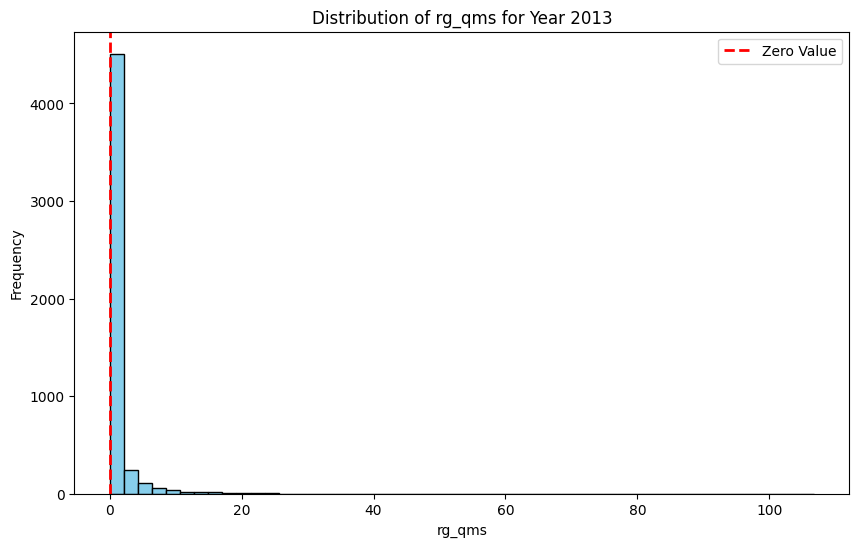


Processing file: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2014_events.csv
Total valid rg_qms rows: 4755
Number of zero values: 2753
Percentage of zeros: 57.90%


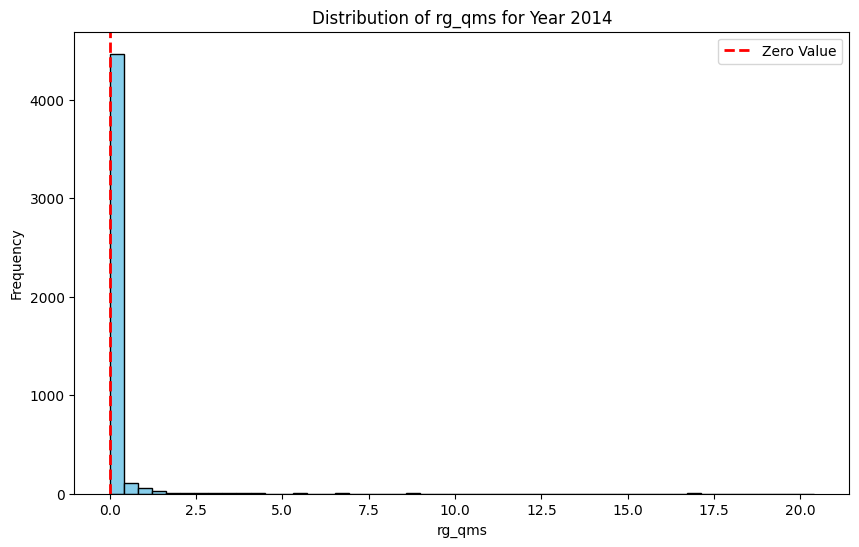


Processing file: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2015_events.csv
Total valid rg_qms rows: 4857
Number of zero values: 2029
Percentage of zeros: 41.77%


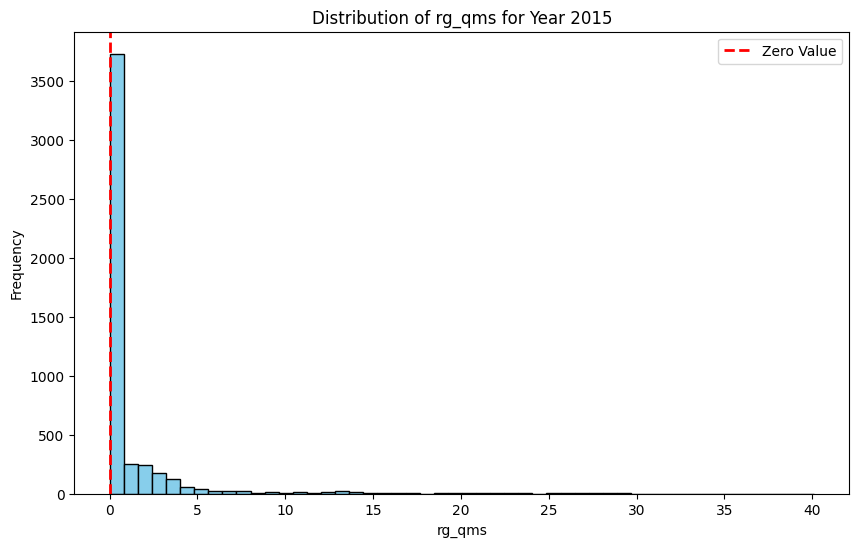


Processing file: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2016_events.csv
Total valid rg_qms rows: 1701
Number of zero values: 1147
Percentage of zeros: 67.43%


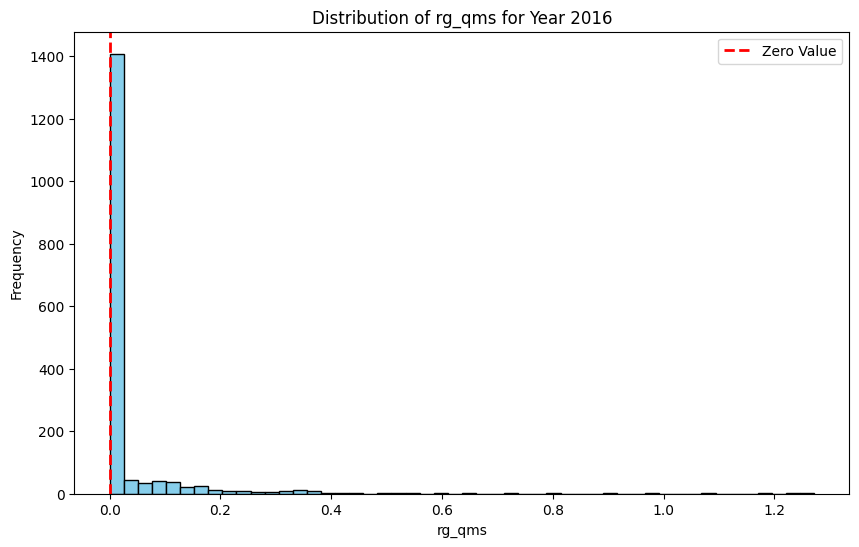


Processing file: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2018_events.csv
Total valid rg_qms rows: 4773
Number of zero values: 2293
Percentage of zeros: 48.04%


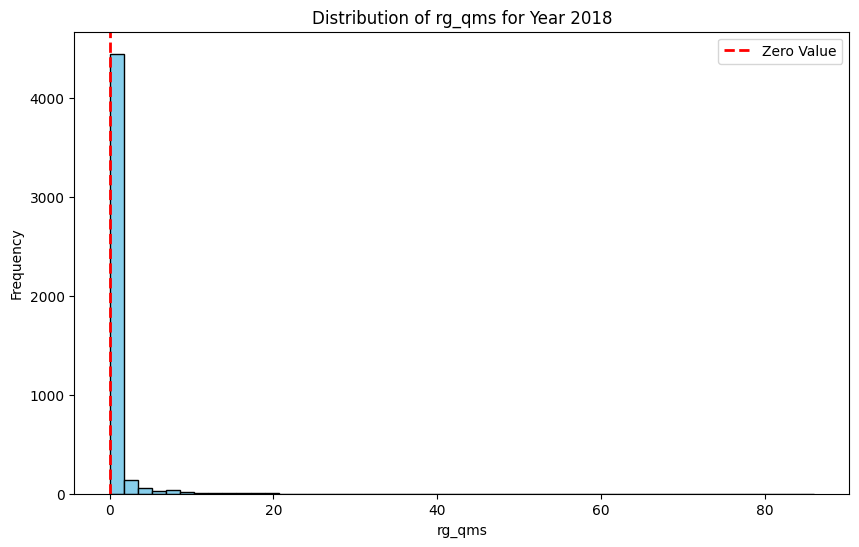


Processing file: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2019_events.csv
Total valid rg_qms rows: 3087
Number of zero values: 1836
Percentage of zeros: 59.48%


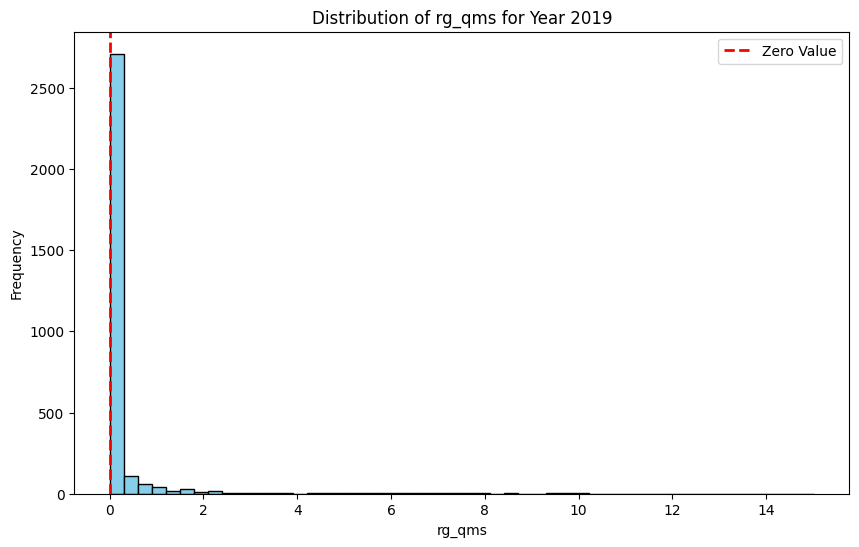


Processing file: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2020_events.csv
Total valid rg_qms rows: 4905
Number of zero values: 3097
Percentage of zeros: 63.14%


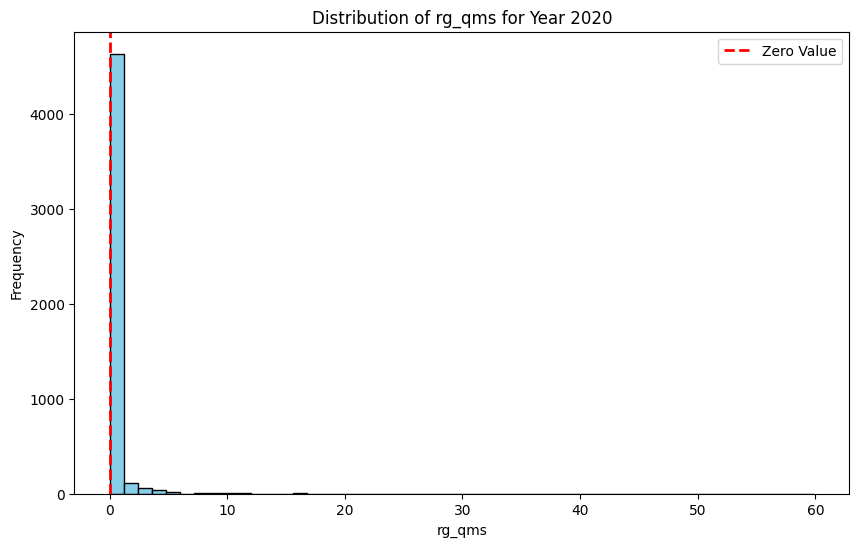

In [28]:
import os
import glob
import pandas as pd
import matplotlib.pyplot as plt

# Define the folder path where your event-based CSV files are stored
folder_path = "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/"
event_folder = os.path.join(folder_path, "event_base_dfs")

# Build the pattern to match event-based CSV files (e.g., Merged_North_Dead_Sea_2012_events.csv, etc.)
pattern = os.path.join(event_folder, "Merged_North_Dead_Sea_*_events.csv")
event_files = sorted(glob.glob(pattern))

# Loop over each event-based file
for file in event_files:
    print(f"\nProcessing file: {file}")
    
    # Read the CSV file, parsing 'datetime' as datetime
    df = pd.read_csv(file, parse_dates=['datetime'])
    
    # Filter the dataframe to only include rows with valid (non-NaN) rg_qms values
    df_valid = df[df['rg_qms'].notnull()]
    total_valid = df_valid.shape[0]
    zero_count = (df_valid['rg_qms'] == 0).sum()
    
    print(f"Total valid rg_qms rows: {total_valid}")
    print(f"Number of zero values: {zero_count}")
    print(f"Percentage of zeros: {100 * zero_count / total_valid:.2f}%")
    
    # Extract the year from the filename.
    base_name = os.path.basename(file)
    parts = base_name.split('_')
    year = parts[4] if len(parts) >= 5 else "Unknown"
    
    # Plot the histogram of rg_qms
    plt.figure(figsize=(10, 6))
    plt.hist(df_valid['rg_qms'], bins=50, color='skyblue', edgecolor='black')
    plt.title(f"Distribution of rg_qms for Year {year}")
    plt.xlabel("rg_qms")
    plt.ylabel("Frequency")
    # Mark the zero value
    plt.axvline(0, color='red', linestyle='dashed', linewidth=2, label="Zero Value")
    plt.legend()
    plt.show()


In [32]:
import os
import glob
import pandas as pd

# Define the folder path containing the event-based CSV files
folder_path = "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs"
pattern = os.path.join(folder_path, "Merged_North_Dead_Sea_*_events.csv")
files = sorted(glob.glob(pattern))

# Loop over each event-based file
for file in files:
    print(f"\nFile: {file}")
    
    # Read CSV file, parsing the 'datetime' column as datetime.
    # (These event-based files are assumed to have a 'datetime' column.)
    df = pd.read_csv(file, parse_dates=['datetime'])
    
    # Create a new column with just the date (without time)
    df['date'] = df['datetime'].dt.date
    
    # Group by the full timestamp (i.e., each unique spatial snapshot) and count rows (pixels)
    time_counts = df.groupby('datetime').size().reset_index(name='pixel_count')
    
    # Now group the timestamp counts by day
    grouped_by_day = time_counts.groupby(time_counts['datetime'].dt.date)
    
    complete_days = []   # Days where every timestamp has exactly 1056 pixels
    incomplete_days = [] # Days where at least one timestamp does NOT have 1056 pixels
    
    for day, group in grouped_by_day:
        if (group['pixel_count'] == 1056).all():
            complete_days.append(day)
        else:
            incomplete_days.append(day)
            # Uncomment the next line if you want to see details for problematic timestamps:
            # print(f"  {day} pixel counts:\n{group}")
    
    print("Days with complete spatial data (1056 pixels per timestamp):", complete_days)
    if incomplete_days:
        print("Days with incomplete spatial data:", incomplete_days)
    print("-" * 50)



File: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2012_events.csv
Days with complete spatial data (1056 pixels per timestamp): [datetime.date(2012, 1, 13), datetime.date(2012, 1, 14), datetime.date(2012, 1, 22), datetime.date(2012, 1, 23), datetime.date(2012, 1, 30), datetime.date(2012, 2, 18), datetime.date(2012, 2, 19), datetime.date(2012, 2, 24), datetime.date(2012, 2, 29), datetime.date(2012, 3, 1), datetime.date(2012, 3, 2), datetime.date(2012, 3, 3), datetime.date(2012, 3, 4)]
--------------------------------------------------

File: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2013_events.csv
Days with complete spatial data (1056 pixels per timestamp): [datetime.date(2013, 1, 7), datetime.date(2013, 1, 8), datetime.date(2013, 1, 9), 

In [33]:
import os
import glob
import pandas as pd

# Define the folder path for event-based CSV files
folder_path = "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs"
pattern = os.path.join(folder_path, "Merged_North_Dead_Sea_*_events.csv")
files = sorted(glob.glob(pattern))

grand_total_complete_days = 0

for file in files:
    print(f"\nFile: {file}")
    
    # Read the CSV file with 'datetime' parsed as datetime
    df = pd.read_csv(file, parse_dates=['datetime'])
    
    # Create a new column with just the date portion
    df['date'] = df['datetime'].dt.date
    
    # For each unique timestamp, count how many spatial pixels exist
    time_counts = df.groupby('datetime').size().reset_index(name='pixel_count')
    
    # Group the counts by day (i.e. by the date portion of the timestamp)
    grouped_by_day = time_counts.groupby(time_counts['datetime'].dt.date)
    
    complete_days = []   # Days where every timestamp has exactly 1056 pixels
    incomplete_days = [] # Days where at least one timestamp does NOT have 1056 pixels
    
    for day, group in grouped_by_day:
        if (group['pixel_count'] == 1056).all():
            complete_days.append(day)
        else:
            incomplete_days.append(day)
    
    num_complete = len(complete_days)
    print("Days with complete spatial data (1056 pixels per timestamp):", complete_days)
    print(f"Count for this file: {num_complete}")
    print("-" * 50)
    
    grand_total_complete_days += num_complete

print("Grand total of days with complete spatial data across all files:", grand_total_complete_days)



File: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2012_events.csv
Days with complete spatial data (1056 pixels per timestamp): [datetime.date(2012, 1, 13), datetime.date(2012, 1, 14), datetime.date(2012, 1, 22), datetime.date(2012, 1, 23), datetime.date(2012, 1, 30), datetime.date(2012, 2, 18), datetime.date(2012, 2, 19), datetime.date(2012, 2, 24), datetime.date(2012, 2, 29), datetime.date(2012, 3, 1), datetime.date(2012, 3, 2), datetime.date(2012, 3, 3), datetime.date(2012, 3, 4)]
Count for this file: 13
--------------------------------------------------

File: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2013_events.csv
Days with complete spatial data (1056 pixels per timestamp): [datetime.date(2013, 1, 7), datetime.date(2013, 1, 8), dat

In [34]:
import os
import glob
import pandas as pd

# Define the folder path containing the event-based CSV files
folder_path = "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs"
pattern = os.path.join(folder_path, "Merged_North_Dead_Sea_*_events.csv")
files = sorted(glob.glob(pattern))

# Loop over each event-based file
for file in files:
    print(f"\nFile: {file}")
    
    # Read CSV file, parsing 'datetime' as datetime
    df = pd.read_csv(file, parse_dates=['datetime'])
    
    # Create a 'date' column containing just the date portion
    df['date'] = df['datetime'].dt.date
    
    # Group the data by day
    grouped = df.groupby('date')
    
    # For each day, list the timestamps that have a discharge value and count them
    for day, group in grouped:
        # Filter rows that have a valid discharge value (rg_qms not NaN)
        discharge_group = group.dropna(subset=['rg_qms'])
        # Get the unique timestamps for which discharge is present
        unique_timestamps = discharge_group['datetime'].unique()
        count_timestamps = len(unique_timestamps)
        
        print(f"Date: {day}")
        print(f"Number of timestamps with discharge: {count_timestamps}")
        print("Timestamps with discharge:")
        for ts in unique_timestamps:
            print(f"   {ts}")
        print()
    
    print("-" * 50)



File: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2012_events.csv
Date: 2012-01-13
Number of timestamps with discharge: 32
Timestamps with discharge:
   2012-01-13 18:40:00
   2012-01-13 18:50:00
   2012-01-13 19:00:00
   2012-01-13 19:10:00
   2012-01-13 19:20:00
   2012-01-13 19:30:00
   2012-01-13 19:40:00
   2012-01-13 19:50:00
   2012-01-13 20:00:00
   2012-01-13 20:10:00
   2012-01-13 20:20:00
   2012-01-13 20:30:00
   2012-01-13 20:40:00
   2012-01-13 20:50:00
   2012-01-13 21:00:00
   2012-01-13 21:10:00
   2012-01-13 21:20:00
   2012-01-13 21:30:00
   2012-01-13 21:40:00
   2012-01-13 21:50:00
   2012-01-13 22:00:00
   2012-01-13 22:10:00
   2012-01-13 22:20:00
   2012-01-13 22:30:00
   2012-01-13 22:40:00
   2012-01-13 22:50:00
   2012-01-13 23:00:00
   2012-01-13 23:10:00
   2012-01-13 23:20:00
   2012-01-13 23:30:00
   2012-01-13 23:40:00
   2012-01-

In [35]:
import os
import glob
import pandas as pd

# Define the folder path containing the event-based CSV files
folder_path = "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs"
pattern = os.path.join(folder_path, "Merged_North_Dead_Sea_*_events.csv")
files = sorted(glob.glob(pattern))

# Loop over each event-based file
for file in files:
    print(f"\nFile: {file}")
    
    # Read the CSV file with 'datetime' parsed as datetime
    df = pd.read_csv(file, parse_dates=['datetime'])
    
    # Create a 'date' column (date portion only)
    df['date'] = df['datetime'].dt.date
    
    # Group the data by day
    grouped_days = df.groupby('date')
    
    for day, day_group in grouped_days:
        # Filter rows with valid discharge values (rg_qms not NaN)
        discharge_data = day_group.dropna(subset=['rg_qms'])
        
        # Group discharge_data by the full timestamp
        ts_grouped = discharge_data.groupby('datetime')
        ts_count = ts_grouped.ngroups
        
        print(f"Date: {day} - Number of timestamps with discharge: {ts_count}")
        for ts, ts_group in ts_grouped:
            # Get all discharge values for this timestamp (should be 3 values for 3 stations)
            rg_values = ts_group['rg_qms'].tolist()
            print(f"   {ts} -> rg_qms: {rg_values}")
        print()
    
    print("-" * 50)



File: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2012_events.csv
Date: 2012-01-13 - Number of timestamps with discharge: 32
   2012-01-13 18:40:00 -> rg_qms: [0.0, 0.0, 0.0]
   2012-01-13 18:50:00 -> rg_qms: [0.0, 0.0, 0.0]
   2012-01-13 19:00:00 -> rg_qms: [0.0, 0.0, 0.0]
   2012-01-13 19:10:00 -> rg_qms: [0.0, 0.0, 0.0]
   2012-01-13 19:20:00 -> rg_qms: [0.0, 0.0, 0.0]
   2012-01-13 19:30:00 -> rg_qms: [0.0, 0.0, 0.0]
   2012-01-13 19:40:00 -> rg_qms: [0.0, 0.0, 0.0]
   2012-01-13 19:50:00 -> rg_qms: [0.0, 0.0, 0.0]
   2012-01-13 20:00:00 -> rg_qms: [0.0, 0.0, 0.0]
   2012-01-13 20:10:00 -> rg_qms: [0.0, 0.0, 0.0]
   2012-01-13 20:20:00 -> rg_qms: [0.0, 0.0, 0.0]
   2012-01-13 20:30:00 -> rg_qms: [0.0, 0.0, 0.0]
   2012-01-13 20:40:00 -> rg_qms: [0.0, 0.0, 0.0]
   2012-01-13 20:50:00 -> rg_qms: [0.0, 0.0, 0.0]
   2012-01-13 21:00:00 -> rg_qms: [0.0, 0.0, 0.0]

In [44]:
32 + 17 + 68 + 81 + 36 + 126 + 132 +31 + 44 + 144 + 144 + 144 + 51 

1050 * 1056 

1108800

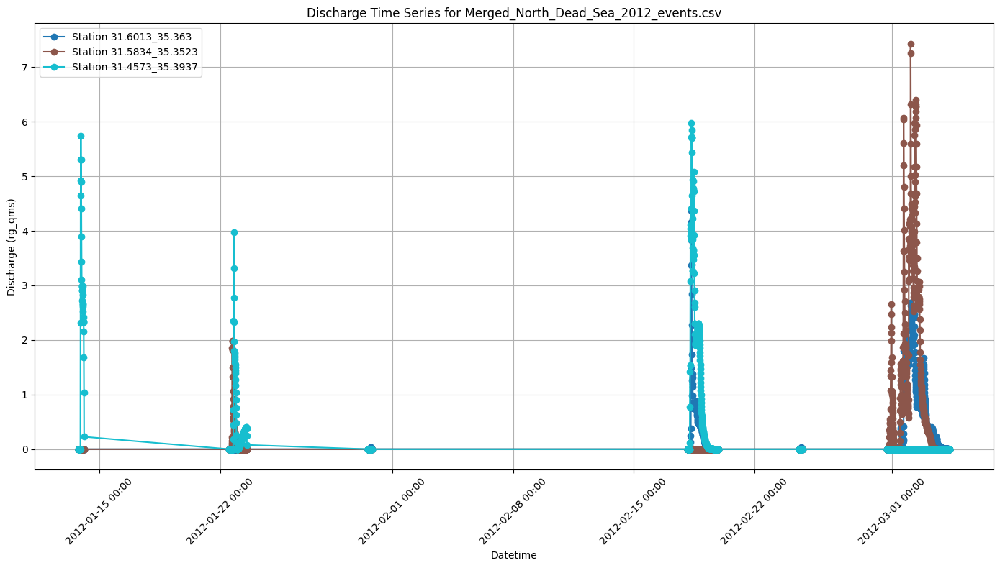

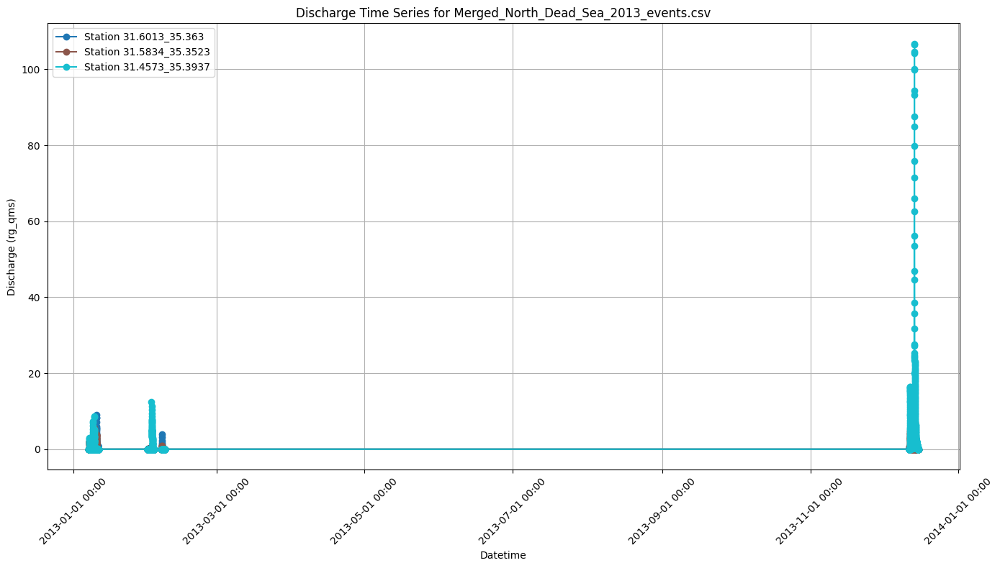

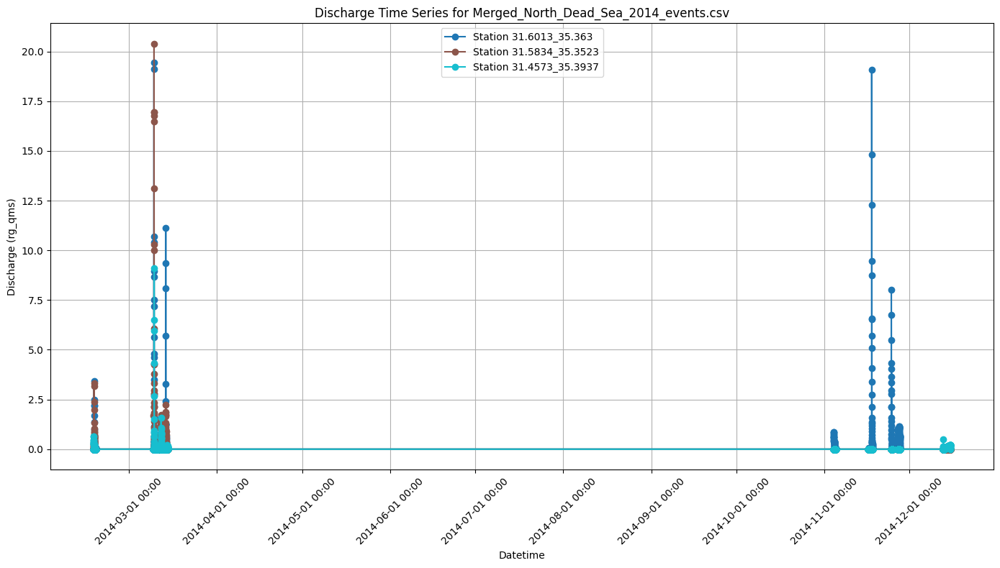

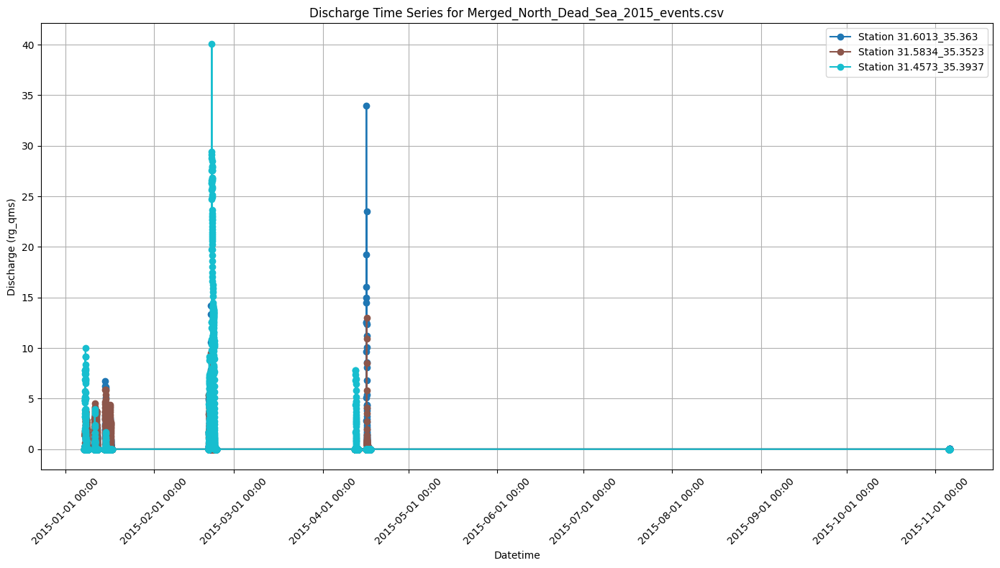

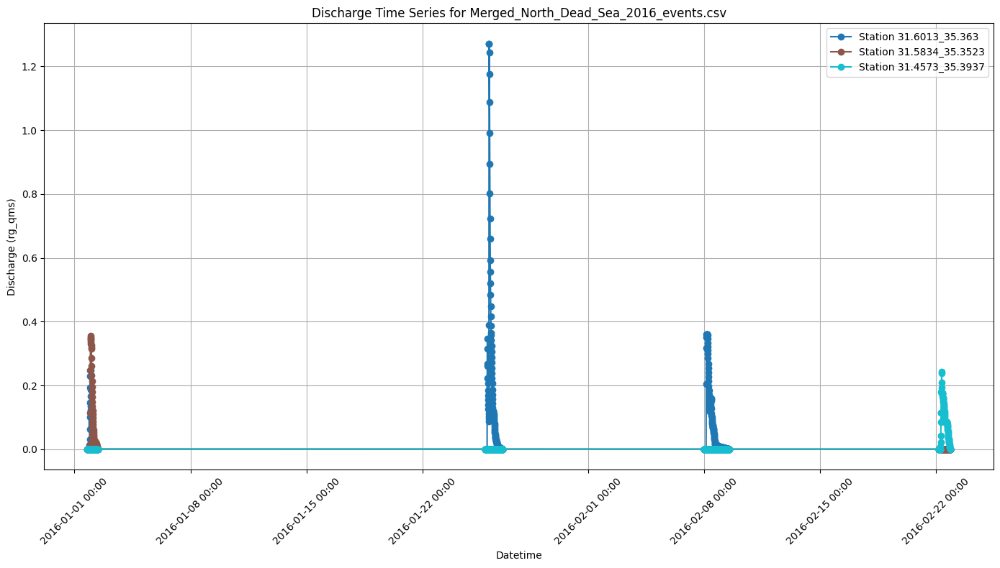

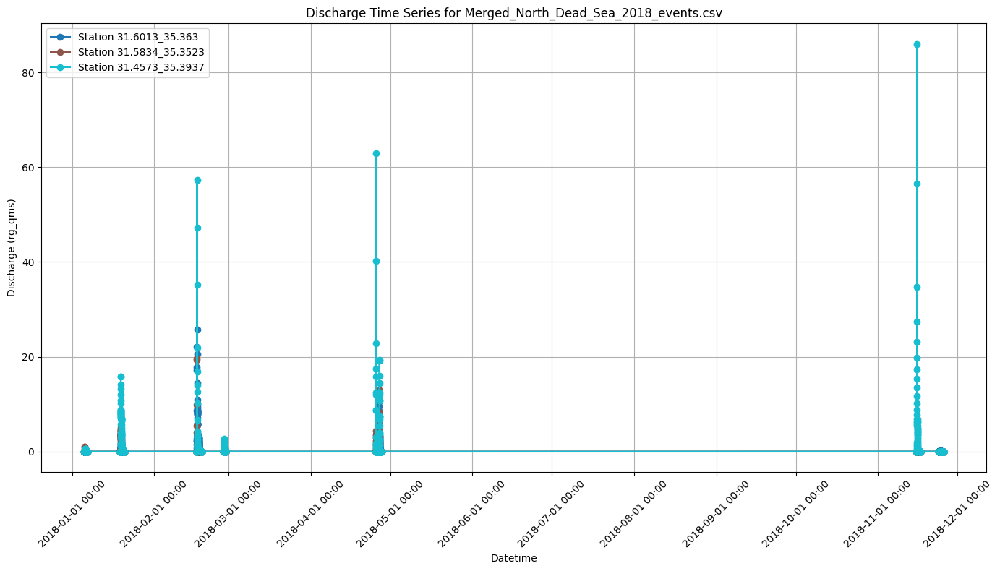

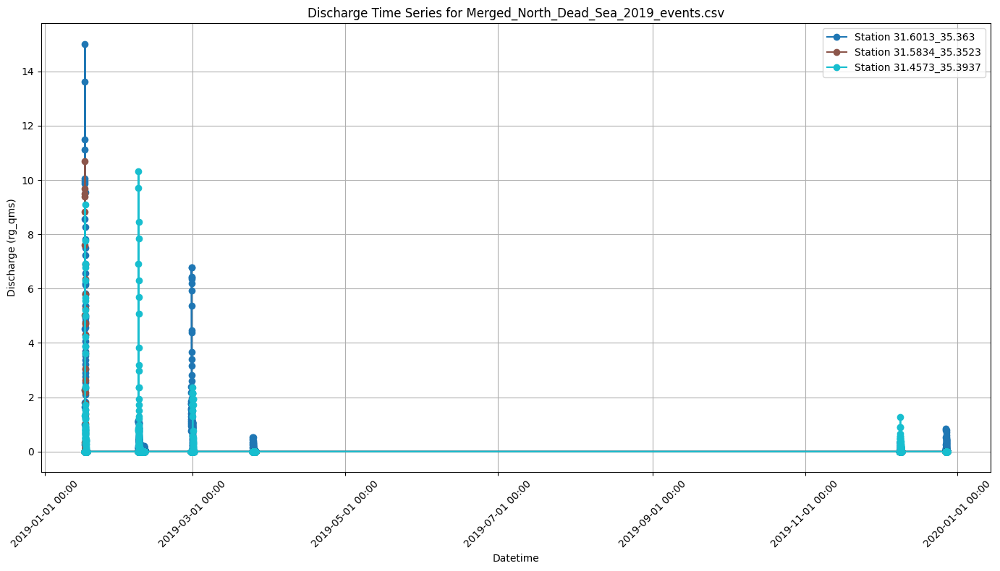

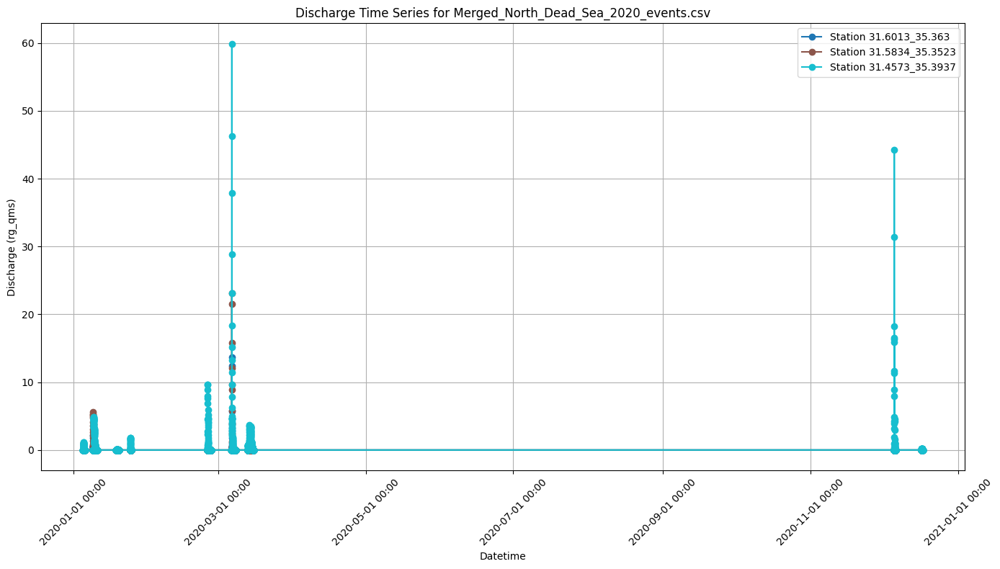

In [36]:
import os
import glob
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import numpy as np

# Define the folder path for event-based CSV files
folder_path = "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs"
pattern = os.path.join(folder_path, "Merged_North_Dead_Sea_*_events.csv")
files = sorted(glob.glob(pattern))

for file in files:
    # Read the CSV file, parsing the 'datetime' column
    df = pd.read_csv(file, parse_dates=['datetime'])
    
    # Ensure a station identifier exists. (Assumes latitude is column 2 and longitude is column 3.)
    if 'station' not in df.columns:
        df['station'] = df.iloc[:, 1].astype(str) + "_" + df.iloc[:, 2].astype(str)
    
    # Filter for rows with a valid discharge (rg_qms)
    df_valid = df[df['rg_qms'].notna()].copy()
    
    if df_valid.empty:
        print(f"No valid discharge data in file: {file}")
        continue
    
    # Get unique stations and assign a color to each (using a colormap)
    stations = df_valid['station'].unique()
    colors = plt.cm.tab10(np.linspace(0, 1, len(stations)))
    color_dict = {station: colors[i] for i, station in enumerate(stations)}
    
    # Create the figure and plot each station's data
    plt.figure(figsize=(14, 8))
    for station in stations:
        station_data = df_valid[df_valid['station'] == station]
        plt.plot(station_data['datetime'], station_data['rg_qms'], marker='o', linestyle='-',
                 color=color_dict[station], label=f"Station {station}")
    
    # Format the x-axis for better date display
    plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
    plt.xticks(rotation=45)
    
    plt.xlabel("Datetime")
    plt.ylabel("Discharge (rg_qms)")
    plt.title(f"Discharge Time Series for {os.path.basename(file)}")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()


In [40]:
import pandas as pd

# Path to the 2012 event-based file
file_2012 = "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2012_events.csv"

# Read the CSV and display the first few rows
df_2012 = pd.read_csv(file_2012)
print(df_2012.head(100))


                   time  latitude  longitude  rainrate   elevation  \
0   2012-01-13 18:40:00   31.7542    35.3533     0.000  179.910080   
1   2012-01-13 18:40:00   31.7542    35.3639     0.000  182.382250   
2   2012-01-13 18:40:00   31.7542    35.3744     0.000   94.527710   
3   2012-01-13 18:40:00   31.7541    35.3850     0.000  -57.003750   
4   2012-01-13 18:40:00   31.7541    35.3956     0.000   60.185940   
..                  ...       ...        ...       ...         ...   
95  2012-01-13 18:40:00   31.7270    35.4060     0.000  -39.065838   
96  2012-01-13 18:40:00   31.7191    35.0994     0.237  590.516360   
97  2012-01-13 18:40:00   31.7191    35.1099     0.304  593.841100   
98  2012-01-13 18:40:00   31.7190    35.1205     0.657  572.267900   
99  2012-01-13 18:40:00   31.7190    35.1311     0.721  753.679300   

    slope_calculated  rg_qms             datetime  
0                NaN     NaN  2012-01-13 18:40:00  
1           2.973726     NaN  2012-01-13 18:40:00  
2  

In [48]:
import os
import glob
import pandas as pd
import numpy as np

# Define input folder (event_base_dfs) and output folder (remapping time dfs)
base_folder = "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr"
input_folder = os.path.join(base_folder, "event_base_dfs")
output_folder = os.path.join(base_folder, "remapping time dfs")

# Create output folder if it doesn't exist
os.makedirs(output_folder, exist_ok=True)

# Build file pattern to get all event-based CSV files
pattern = os.path.join(input_folder, "Merged_North_Dead_Sea_*_events.csv")
files = sorted(glob.glob(pattern))

for file in files:
    print(f"\nProcessing file: {file}")
    # Read CSV file, parsing the time column
    # Use "datetime" if present; otherwise "time"
    header = pd.read_csv(file, nrows=0).columns
    if "datetime" in header:
        df = pd.read_csv(file, parse_dates=["datetime"])
        time_col = "datetime"
    elif "time" in header:
        df = pd.read_csv(file, parse_dates=["time"])
        time_col = "time"
    else:
        print("No time column ('datetime' or 'time') found in file.")
        continue
    
    # Sort the DataFrame by the time column
    df = df.sort_values(by=time_col).reset_index(drop=True)
    
    # Convert the time column to string to ensure consistent mapping
    df[time_col] = df[time_col].astype(str)
    
    # Extract unique time stamps (as strings) from the chosen column
    unique_times = np.sort(df[time_col].unique())
    N = len(unique_times)
    
    if N < 2:
        print("Not enough unique time stamps to re-map (need at least 2). Skipping file.")
        continue
    
    # Create mapping from each unique time stamp (as string) to a continuous tau in [0,1]
    time_to_tau = {t: i/(N-1) for i, t in enumerate(unique_times)}
    
    # Apply mapping to the DataFrame to create new column 'tau'
    df['tau'] = df[time_col].apply(lambda t: time_to_tau[t])
    
    # Remove the original time columns ('datetime' and 'time') if present
    for col in ["datetime", "time"]:
        if col in df.columns:
            df.drop(columns=[col], inplace=True)
    
    # Save the new DataFrame into the output folder, preserving the filename but adding a suffix
    base_filename = os.path.basename(file)
    out_file = os.path.join(output_folder, base_filename.replace("_events.csv", "_remapped.csv"))
    df.to_csv(out_file, index=False)
    print(f"Saved remapped file to: {out_file}")
    
    # -- Check transformation --
    unique_tau = df['tau'].unique()
    print(f"Unique tau count: {len(unique_tau)} (should be {N})")
    print(f"Tau range: min = {df['tau'].min()}, max = {df['tau'].max()}")
    print("-"*50)



Processing file: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2012_events.csv
Saved remapped file to: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/remapping time dfs/Merged_North_Dead_Sea_2012_remapped.csv
Unique tau count: 1050 (should be 1050)
Tau range: min = 0.0, max = 1.0
--------------------------------------------------

Processing file: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2013_events.csv
Saved remapped file to: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/remapping time dfs/Merged_North_Dead_Sea_2013_remapped.csv
Unique tau count: 1691 (should be 1691)
T

In [49]:
import os
import glob
import pandas as pd

# Define the folder path for the remapped files
folder_path = "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/remapping time dfs"
pattern = os.path.join(folder_path, "Merged_North_Dead_Sea_*_remapped.csv")
files = sorted(glob.glob(pattern))

# Loop through each file and display its head
for file in files:
    print(f"\nFile: {file}")
    df = pd.read_csv(file)
    print(df.head())
    print("="*50)



File: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/remapping time dfs/Merged_North_Dead_Sea_2012_remapped.csv
   latitude  longitude  rainrate  elevation  slope_calculated  rg_qms  tau
0   31.7542    35.3533     0.000  179.91008               NaN     NaN  0.0
1   31.5472    35.4049     0.000 -424.01000               NaN     NaN  0.0
2   31.5392    35.0988     0.024  964.11554               NaN     NaN  0.0
3   31.5392    35.1094     0.005  942.76620          0.802732     NaN  0.0
4   31.5392    35.1199     0.000  995.55310          1.051210     NaN  0.0

File: /media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/remapping time dfs/Merged_North_Dead_Sea_2013_remapped.csv
   latitude  longitude  rainrate  elevation  slope_calculated  rg_qms  tau
0   31.7542    35.3533       0.0  179.91008               NaN     NaN  0.0
1   

In [50]:
import pandas as pd

# Path to the 2012 remapped file
file_path = "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/remapping time dfs/Merged_North_Dead_Sea_2012_remapped.csv"

# Load the DataFrame
df = pd.read_csv(file_path)

# Ensure that tau is treated as a float
df['tau'] = df['tau'].astype(float)

# Find the first index where tau is exactly 1.0
first_tau_one_index = df[df['tau'] == 1.0].index.min()

print("First row index where tau equals 1.0:", first_tau_one_index)

First row index where tau equals 1.0: 1107744


In [51]:
import pandas as pd

# Path to the 2012 remapped file
file_path = "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/remapping time dfs/Merged_North_Dead_Sea_2012_remapped.csv"

# Load the DataFrame
df = pd.read_csv(file_path)

# Ensure that tau is treated as a float
df['tau'] = df['tau'].astype(float)

# Find the first row index where tau is not equal to 0.0
first_nonzero_index = df[df['tau'] != 0.0].index.min()

print("First row index where tau changes from 0.0:", first_nonzero_index)


First row index where tau changes from 0.0: 1056


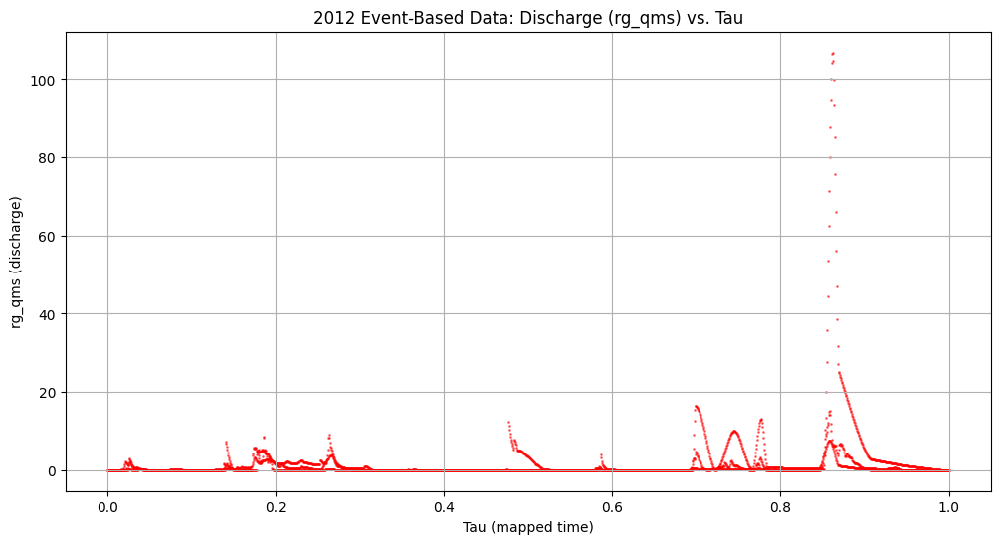

In [53]:
import os
import pandas as pd
import matplotlib.pyplot as plt

# Define the path to the 2012 remapped file
file_path = "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/remapping time dfs/Merged_North_Dead_Sea_2013_remapped.csv"

# Load the file
df = pd.read_csv(file_path)

# Ensure tau is treated as a float
df['tau'] = df['tau'].astype(float)

# Create the scatter plot
plt.figure(figsize=(12, 6))
plt.scatter(df['tau'], df['rg_qms'], s=1, color='red', alpha=0.5)
plt.xlabel('Tau (mapped time)')
plt.ylabel('rg_qms (discharge)')
plt.title('2012 Event-Based Data: Discharge (rg_qms) vs. Tau')
plt.grid(True)
plt.show()


Unique stations found: ['31.5834_35.3523' '31.4573_35.3937' '31.6013_35.363']


/tmp/ipykernel_6313/1245337163.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_valid['station'] = df_valid['latitude'].round(4).astype(str) + "_" + df_valid['longitude'].round(4).astype(str)


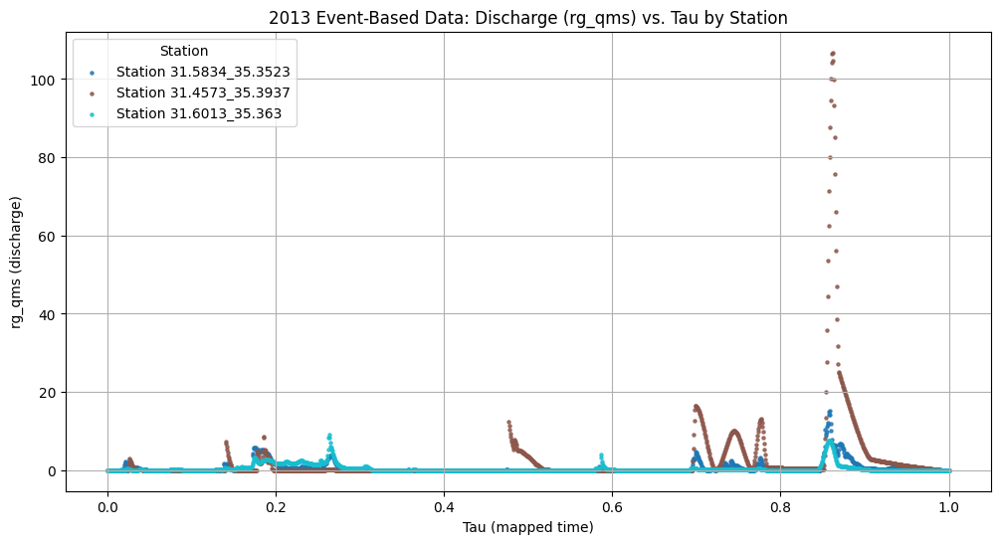

In [61]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# Define the path to the 2012 remapped file
file_path = "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/remapping time dfs/Merged_North_Dead_Sea_2013_remapped.csv"

# Load the file
df = pd.read_csv(file_path)

# Ensure tau is treated as a float
df['tau'] = df['tau'].astype(float)

# Filter for rows with valid discharge (rg_qms not NaN)
df_valid = df[df['rg_qms'].notna()]

# Create a station identifier based on latitude and longitude (rounding to group together the same pixel)
df_valid['station'] = df_valid['latitude'].round(4).astype(str) + "_" + df_valid['longitude'].round(4).astype(str)

# Get unique station identifiers (should be 3)
stations = df_valid['station'].unique()
print("Unique stations found:", stations)

# Create a color mapping for each station using a colormap
colors = plt.cm.tab10(np.linspace(0, 1, len(stations)))

plt.figure(figsize=(12, 6))
for i, station in enumerate(stations):
    sub_df = df_valid[df_valid['station'] == station]
    plt.scatter(sub_df['tau'], sub_df['rg_qms'], s=5, color=colors[i], alpha=0.8, label=f"Station {station}")

plt.xlabel('Tau (mapped time)')
plt.ylabel('rg_qms (discharge)')
plt.title('2013 Event-Based Data: Discharge (rg_qms) vs. Tau by Station')
plt.legend(title="Station")
plt.grid(True)
plt.show()


Unique stations found: ['31.6013_35.363' '31.5834_35.3523' '31.4573_35.3937']


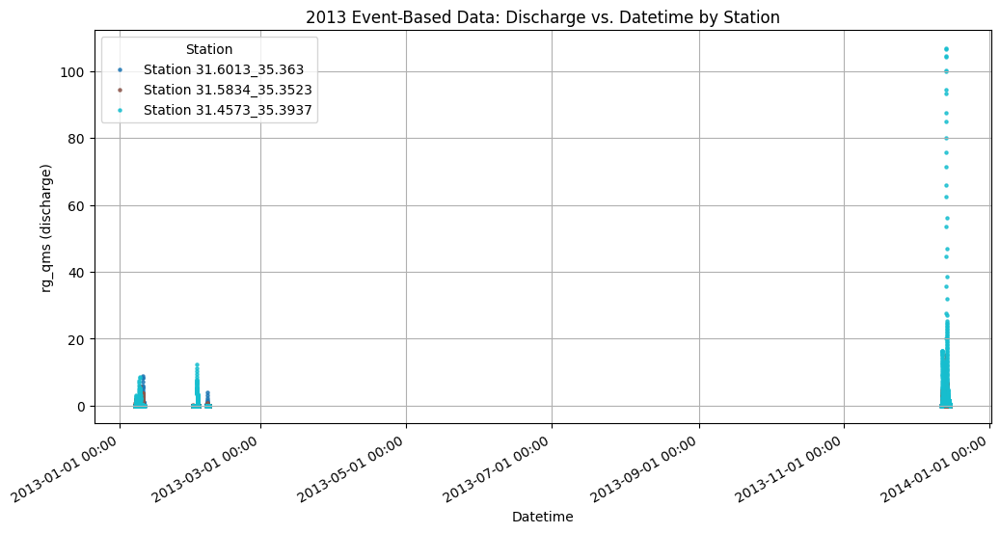

In [60]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.dates as mdates

# Define the path to the 2013 event-based file
file_path = "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/Merged_North_Dead_Sea_2013_events.csv"

# Load the file, parsing the datetime column
df = pd.read_csv(file_path, parse_dates=["datetime"])

# Filter for rows with valid discharge (rg_qms not NaN)
df_valid = df[df["rg_qms"].notna()].copy()

# Create a station identifier using latitude and longitude (rounded to 4 decimals)
df_valid["station"] = df_valid["latitude"].round(4).astype(str) + "_" + df_valid["longitude"].round(4).astype(str)

# Get unique station identifiers (should be 3)
stations = df_valid["station"].unique()
print("Unique stations found:", stations)

# Create a color mapping for each station using a colormap
colors = plt.cm.tab10(np.linspace(0, 1, len(stations)))

plt.figure(figsize=(12, 6))
for i, station in enumerate(stations):
    sub_df = df_valid[df_valid["station"] == station]
    plt.scatter(sub_df["datetime"], sub_df["rg_qms"], s=5, color=colors[i],
                alpha=0.8, label=f"Station {station}")

plt.xlabel("Datetime")
plt.ylabel("rg_qms (discharge)")
plt.title("2013 Event-Based Data: Discharge vs. Datetime by Station")
plt.legend(title="Station")
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter("%Y-%m-%d %H:%M"))
plt.gcf().autofmt_xdate()
plt.grid(True)
plt.show()


DataFrame Head:
   latitude  longitude  rainrate  elevation  slope_calculated  rg_qms  tau
0   31.7542    35.3533     0.000  179.91008               NaN     NaN  0.0
1   31.5472    35.4049     0.000 -424.01000               NaN     NaN  0.0
2   31.5392    35.0988     0.024  964.11554               NaN     NaN  0.0
3   31.5392    35.1094     0.005  942.76620          0.802732     NaN  0.0
4   31.5392    35.1199     0.000  995.55310          1.051210     NaN  0.0


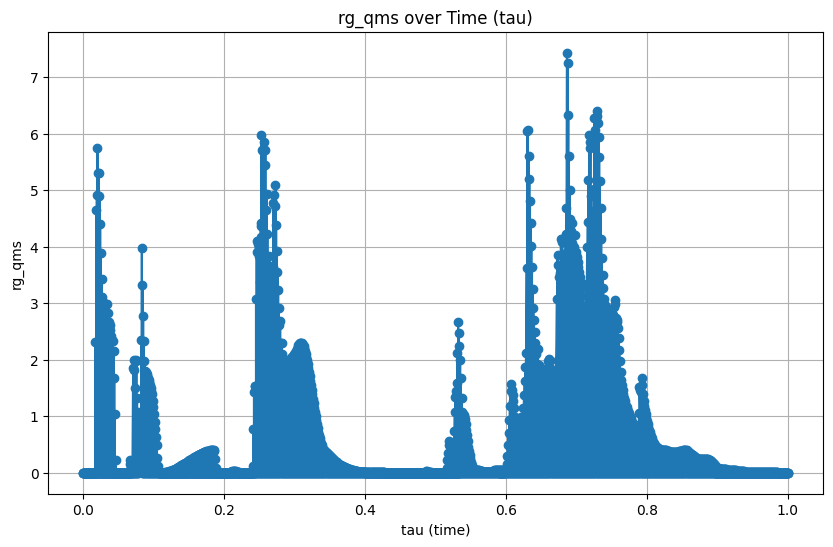

In [64]:
#!/usr/bin/env python3

import pandas as pd
import matplotlib.pyplot as plt

# Path to your CSV file
csv_path = (
    "/media/data-ssd/PINN/DATA/model data after proccessing/full POC model/"
    "3 final files according to spatial PINN Hebrew/merged/nov2apr/event_base_dfs/"
    "remapping time dfs/Merged_North_Dead_Sea_2012_remapped.csv"
)

# Read CSV into a DataFrame
df = pd.read_csv(csv_path)

# Show the first few rows in the console for confirmation
print("DataFrame Head:")
print(df.head())

# If there are NaN values in rg_qms (or tau), we can drop those rows to avoid plotting issues:
df = df.dropna(subset=["rg_qms", "tau"])

# Plot rg_qms vs. tau
plt.figure(figsize=(10, 6))
plt.plot(df["tau"], df["rg_qms"], marker='o', linestyle='-')  # marker & linestyle are optional

# Customize the plot
plt.title("rg_qms over Time (tau)")
plt.xlabel("tau (time)")
plt.ylabel("rg_qms")
plt.grid(True)

# Display the plot
plt.show()
